In [185]:
import pandas as pd
import math
import numpy as np
from datetime import datetime, timedelta, date
import time
import seaborn as sns
import matplotlib.pyplot as plt
import pickle

%matplotlib inline


# Data Preprocessing

In [2]:
df = pd.read_csv("etftrd-1min-201904_10.csv")[["date","time","sym","volume"]]

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 676260 entries, 0 to 676259
Data columns (total 4 columns):
date      676260 non-null object
time      676260 non-null object
sym       676260 non-null object
volume    676260 non-null int64
dtypes: int64(1), object(3)
memory usage: 20.6+ MB


- The volume data include the opening and closing auction in the first and last time interval everyday.

In [5]:
df.tail()

,date,time,sym,volume
676255,2019-10-30,15:55:00,XLY,18690
676256,2019-10-30,15:56:00,XLY,17196
676257,2019-10-30,15:57:00,XLY,25546
676258,2019-10-30,15:58:00,XLY,30424
676259,2019-10-30,15:59:00,XLY,144915


In [6]:
df_sym = df.groupby(["sym"])
df_sym["volume"].describe()

,count,mean,std,min,25%,50%,75%,max
sym,,,,,,,,
SPY,56550.0,135609.584262,180723.774334,2400.0,48364.75,85940.0,156626.75,5488360.0
XLB,56550.0,13950.615844,29420.526338,0.0,3409.00,6895.5,14684.75,2075307.0
XLC,55380.0,6747.054586,24867.470899,0.0,1317.00,2679.0,5579.00,2296246.0
XLE,56550.0,33514.736127,50174.961866,282.0,10552.00,19513.0,37488.75,1412309.0
XLF,56550.0,116643.204403,199175.993601,23.0,27127.75,59378.0,124438.75,6685971.0
XLI,56550.0,25754.772944,47539.311593,23.0,6766.00,12734.0,26083.50,1778290.0
XLK,56550.0,29307.373227,54993.279644,88.0,8203.25,15159.0,29969.75,1796904.0
XLP,56550.0,30098.396092,65724.068386,0.0,7283.00,14607.0,30274.25,4109495.0
XLRE,55380.0,10220.218202,26034.447036,0.0,1849.00,5119.5,11183.50,2811994.0


## 1. Deal with Missing intervals

### Construct all time intervals with dates & times


In [8]:
all_time = list(set(df["time"]))
all_date = list(set(df["date"]))
all_date.sort()
all_time.sort()
print("Length of Days = %f" %len(all_date))
print("Length of Times = %f" %len(all_time))

Length of Days = 145.000000
Length of Times = 390.000000


In [9]:
all_date_time = [x+' '+ y for x in all_date for y in all_time]
all_date_time.sort()
len(all_date_time) == 145*390

True

In [10]:
df_full = pd.DataFrame(columns=["date","time","sym","date_time"])
df_full["date_time"] = all_date_time*12
new = df_full["date_time"].str.split(" ", n = 1, expand = True)
df_full.loc[:,"date"] = new[0]
df_full.loc[:,"time"] = new[1]
for k in range(12):
    df_full.iloc[k*145*390:(k+1)*145*390]["sym"] = syms[k]

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [11]:
df_clean = pd.merge(df_full,df,how='left' )
print("Missing time intervals: ", pd.isna(df_clean).sum())

Missing time intervals:  date            0
time            0
sym             0
date_time       0
volume       2340
dtype: int64


### Visualize missing data

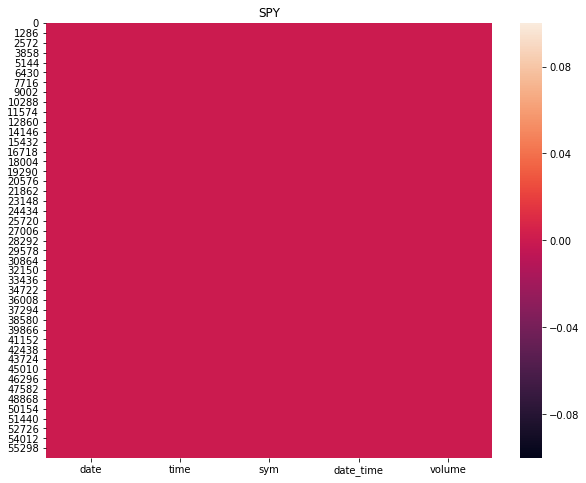

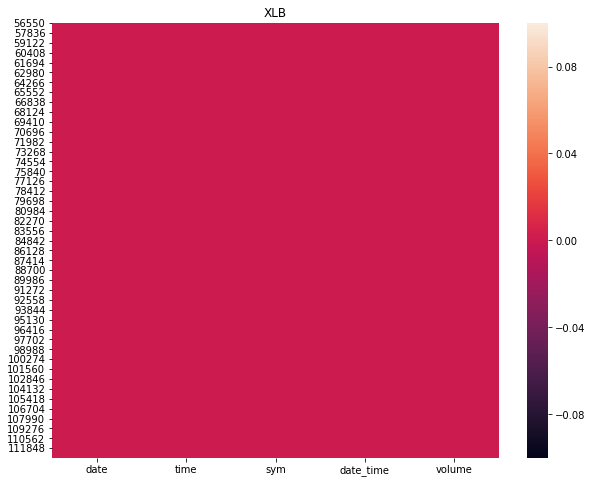

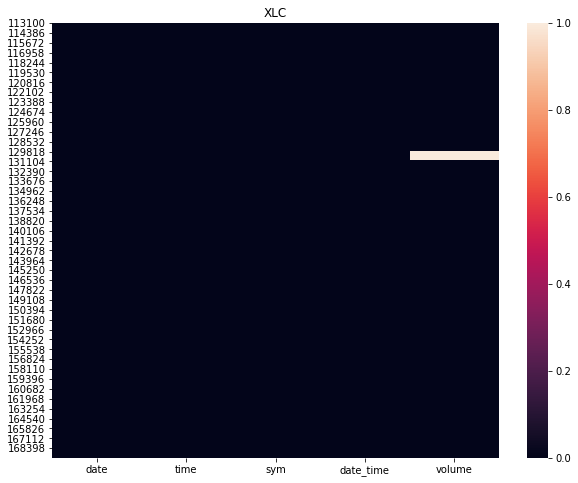

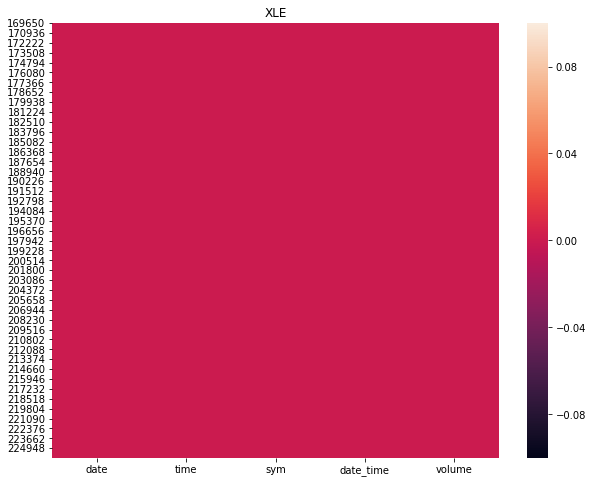

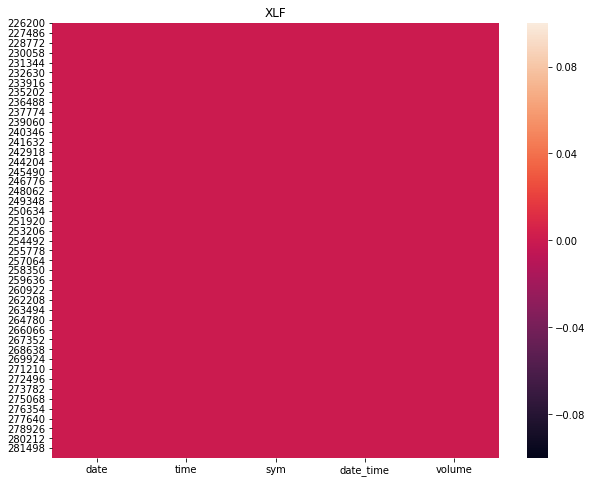

...

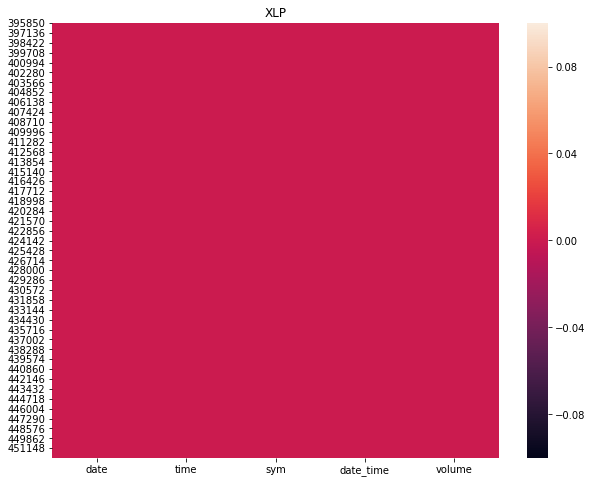

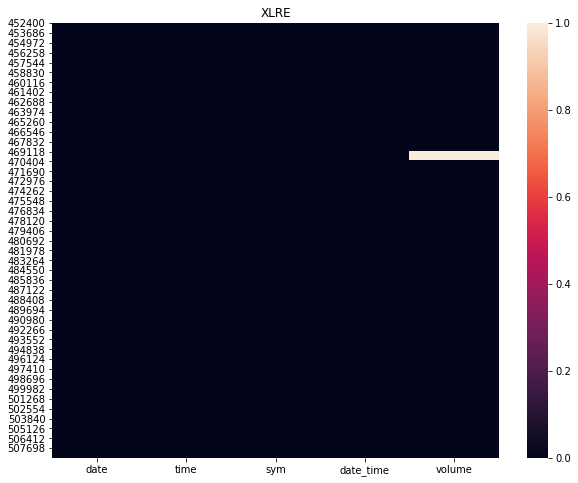

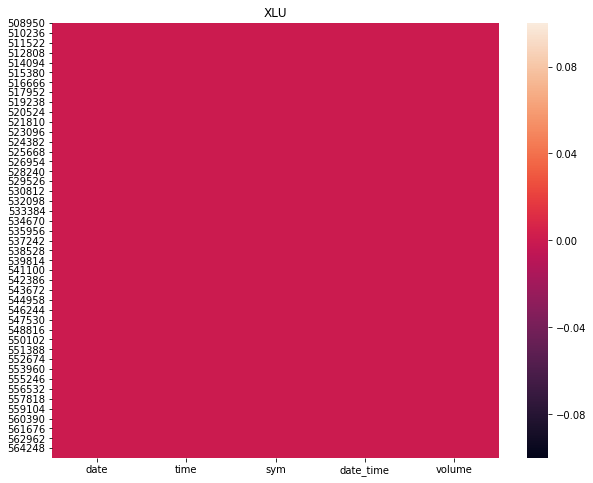

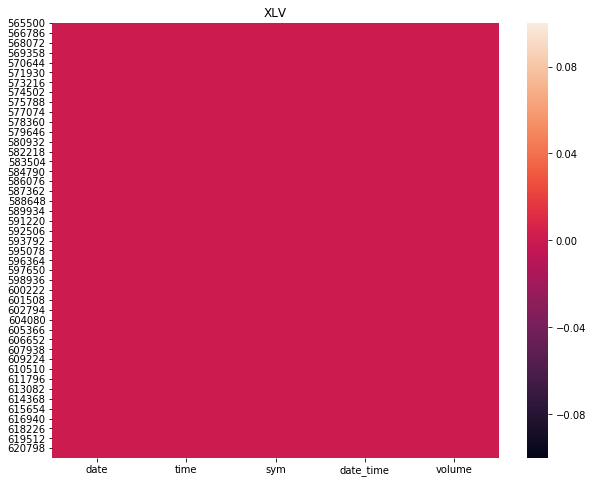

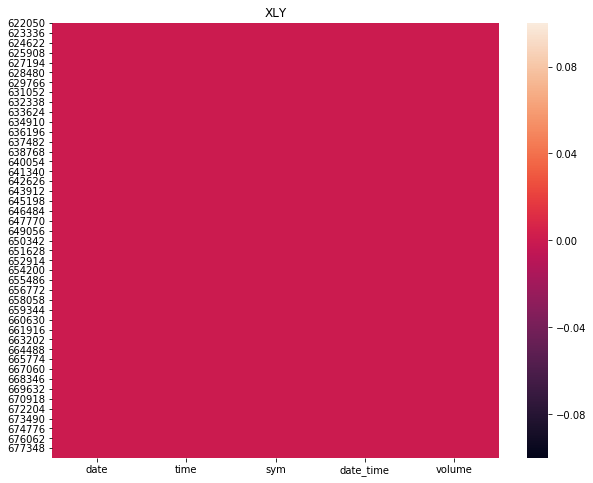

In [12]:

for sym_name in syms:
    mask = df_clean.sym == sym_name
    temp = df_clean[mask]

    fig, ax = plt.subplots(figsize = (10, 8))
    sns.heatmap(temp.isnull())
    ax.set_title(sym_name)

In [13]:
pd.isna(df_clean[df_clean.sym == "XLRE"]).sum()/390

date         0.0
time         0.0
sym          0.0
date_time    0.0
volume       3.0
dtype: float64

In [14]:
pd.isna(df_clean[df_clean.sym == "XLC"]).sum()/390

date         0.0
time         0.0
sym          0.0
date_time    0.0
volume       3.0
dtype: float64

### XLC and XLRE as two newer ETFs, have missing trading days. Here I keep the symbols but skip the 3 missing days

In [15]:
df_clean = df_clean.dropna()

In [16]:
print("Check missing time intervals: Any nan?  ", pd.isna(df_clean).values.any())

Check missing time intervals: Any nan?   False


### All symbols:

In [17]:
syms = df_clean["sym"].unique()
syms

array(['SPY', 'XLB', 'XLC', 'XLE', 'XLF', 'XLI', 'XLK', 'XLP', 'XLRE',
       'XLU', 'XLV', 'XLY'], dtype=object)

### Calculate 10min stats

In [18]:
# Change to datetime type

df_clean.loc[:,"date_time"] = pd.to_datetime(df_clean["date_time"])
df_clean.loc[:,"date"] = pd.to_datetime(df_clean["date"]).dt.date 
df_clean.loc[:,"time"] = (pd.to_datetime(df_clean["time"])).dt.time


In [19]:
all_time = list(set(df_clean["time"]))
all_date = list(set(df_clean["date"]))
all_date.sort()
all_time.sort()

In [20]:
df_clean_10 = df_clean.set_index("date_time")
df_clean_10 = df_clean_10.groupby('sym').resample('10min', loffset=pd.Timedelta('10min')).sum(min_count=1).reset_index()
df_clean_10["date"] = df_clean_10.date_time.dt.date
df_clean_10["time"] = df_clean_10.date_time.dt.time

In [21]:
from datetime import datetime, time

def is_time_between(check_time):
    begin_time, end_time = time(9,40), time(16,0)
    # If check time is not given
    check_time = check_time or datetime.utcnow().time()
    if begin_time < end_time:
        return check_time >= begin_time and check_time <= end_time

In [22]:
df_clean_10["filter"] = df_clean_10.time.apply(is_time_between)
df_clean_10 = df_clean_10[df_clean_10["filter"] == True].dropna().reset_index()
df_clean_10 = df_clean_10.drop(["index","filter"],axis=1)

### Add 1 share to all missing intervals to avoid the log(0) issue


In [23]:
df_clean_10.loc[df_clean_10["volume"] == 0, "volume"] = 1

In [24]:
df_clean_10.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67626 entries, 0 to 67625
Data columns (total 5 columns):
sym          67626 non-null object
date_time    67626 non-null datetime64[ns]
volume       67626 non-null float64
date         67626 non-null object
time         67626 non-null object
dtypes: datetime64[ns](1), float64(1), object(3)
memory usage: 2.6+ MB


## 2. Data cleaning and computing of all basic stats: 

Daily data:
- Deterministic Blend:
    - ADV
- Lognormal Bayesian:
    - log daily volume
    - Mean of log daily return
    - historical mean and std of daily volume
- Kalman:
    - ADV
    

Minute data:
- Deterministic blend:
    - Average cumulative profile
    - Volume printed from today start to t 
    - Time length from opening to t
- Lognormal Bayesian:
    - Average volume profile
    - Cumuative volume profile
    - Cumulative volume
- Kalman:
    - Average cumulative volume profile
    - Var of cumulative voulme profile
    


In [25]:
# Calculate Daily Stats

daily_Stats_10 = dict()

for sym_name in syms:
    mask = df_clean_10.sym == sym_name
    temp = df_clean_10[mask]
    daily_vol = temp["volume"].groupby(temp['date']).sum()
    
    daily_log_vol = np.log(daily_vol)
    log_mean = daily_log_vol.rolling(20).mean()
    mean = daily_vol.rolling(20).mean()
    std = daily_vol.rolling(20).std()
    
    df_temp = pd.DataFrame()
    df_temp["daily_vol"] = daily_vol
    df_temp["daily_log_vol"] = daily_log_vol
    df_temp["daily_vol_mean"] = mean
    df_temp["daily_vol_std"] = std
    df_temp["daily_vol_log_mean"] = log_mean
    
    df_temp[["daily_vol_mean","daily_vol_std","daily_vol_log_mean"]] = df_temp[["daily_vol_mean","daily_vol_std","daily_vol_log_mean"]].shift(1)
    
    daily_Stats_10[sym_name] = df_temp
    

In [26]:
for sym_name in syms:
    for stat in ["daily_vol","daily_vol_mean","daily_vol_std","daily_vol_log_mean"]:
        df_clean_10.loc[(df_clean_10.sym == sym_name),stat]= df_clean_10.loc[(df_clean_10.sym == sym_name),:]["date"].map(daily_Stats_10[sym_name][stat])
        
    mask = df_clean_10.sym == sym_name
    df_clean_10.loc[mask,"cum_sum_vol"] = df_clean_10.loc[mask,"volume"].groupby(df_clean_10['date']).cumsum()

df_clean_10.loc[: , "cum_vol_prof"] = (df_clean_10["cum_sum_vol"] / df_clean_10["daily_vol"]).astype("float")
df_clean_10.loc[: , "vol_prof"] = (df_clean_10["volume"] / df_clean_10["daily_vol"]).astype("float")

In [27]:
# Calculate 10 Minute Stats

minutes_Stats_10 = list()

for sym_name in syms:
    mask = df_clean_10.sym == sym_name
    temp = df_clean_10[mask]
    
    cum_vol_prof_var = temp.groupby('time')["cum_vol_prof"].apply(lambda x :x.rolling(20).var().shift(1))
    vol_prof_mean = temp.groupby('time')["vol_prof"].apply(lambda x :x.rolling(20).mean().shift(1))
    cum_vol_prof_mean =  temp.groupby('time')["cum_vol_prof"].apply(lambda x :x.rolling(20).mean().shift(1))
    
    df_temp = pd.DataFrame()
    df_temp["cum_vol_prof_var"] = cum_vol_prof_var
    df_temp["vol_prof_mean"] = vol_prof_mean
    df_temp["cum_vol_prof_mean"] =  cum_vol_prof_mean
    
    
    minutes_Stats_10.append(df_temp)


In [28]:
df_minutes_Stats_10 = pd.concat(minutes_Stats_10)
df_clean_10 = df_clean_10.join(df_minutes_Stats_10)

In [29]:
# Calculating the time difference from 9:30, prepare for piecewise linear interpolation

def TimeDiff(time):
    return (datetime.combine(date.min, time) - datetime.combine(date.min, datetime.strptime('09:30', '%H:%M').time())).seconds/60
df_clean_10["time_diff"] = df_clean_10["time"].copy().apply(TimeDiff)

In [30]:
df_clean_10.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67626 entries, 0 to 67625
Data columns (total 16 columns):
sym                   67626 non-null object
date_time             67626 non-null datetime64[ns]
volume                67626 non-null float64
date                  67626 non-null object
time                  67626 non-null object
daily_vol             67626 non-null float64
daily_vol_mean        58266 non-null float64
daily_vol_std         58266 non-null float64
daily_vol_log_mean    58266 non-null float64
cum_sum_vol           67626 non-null float64
cum_vol_prof          67626 non-null float64
vol_prof              67626 non-null float64
cum_vol_prof_var      58266 non-null float64
vol_prof_mean         58266 non-null float64
cum_vol_prof_mean     58266 non-null float64
time_diff             67626 non-null float64
dtypes: datetime64[ns](1), float64(12), object(3)
memory usage: 8.3+ MB


In [31]:
# Save the preprocessed data into a pickle file.

df_clean_10.to_pickle("df_clean_10.pkl")


In [32]:
# Read data from pickle file.

df_clean_10 = pd.read_pickle("df_clean_10.pkl")

In [33]:
df_cleaned_10 = df_clean_10.dropna()
df_cleaned_10

,sym,date_time,volume,date,time,daily_vol,daily_vol_mean,daily_vol_std,daily_vol_log_mean,cum_sum_vol,cum_vol_prof,vol_prof,cum_vol_prof_var,vol_prof_mean,cum_vol_prof_mean,time_diff
780,SPY,2019-04-30 09:40:00,2848629.0,2019-04-30,09:40:00,47900427.0,40970107.75,6.334415e+06,17.517600,2848629.0,0.059470,0.059470,0.000141,0.069864,0.069864,10.0
781,SPY,2019-04-30 09:50:00,1481384.0,2019-04-30,09:50:00,47900427.0,40970107.75,6.334415e+06,17.517600,4330013.0,0.090396,0.030926,0.000304,0.041642,0.111506,20.0
782,SPY,2019-04-30 10:00:00,822659.0,2019-04-30,10:00:00,47900427.0,40970107.75,6.334415e+06,17.517600,5152672.0,0.107570,0.017174,0.000362,0.033840,0.145346,30.0
783,SPY,2019-04-30 10:10:00,2358955.0,2019-04-30,10:10:00,47900427.0,40970107.75,6.334415e+06,17.517600,7511627.0,0.156818,0.049247,0.000519,0.040115,0.185461,40.0
784,SPY,2019-04-30 10:20:00,744852.0,2019-04-30,10:20:00,47900427.0,40970107.75,6.334415e+06,17.517600,8256479.0,0.172368,0.015550,0.000683,0.029903,0.215364,50.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67621,XLY,2019-10-30 15:20:00,49876.0,2019-10-30,15:20:00,2641464.0,2800757.75,1.147007e+06,14.778494,2051304.0,0.776578,0.018882,0.002365,0.020644,0.757361,350.0
67622,XLY,2019-10-30 15:30:00,109448.0,2019-10-30,15:30:00,2641464.0,2800757.75,1.147007e+06,14.778494,2160752.0,0.818013,0.041435,0.002225,0.024822,0.782183,360.0
67623,XLY,2019-10-30 15:40:00,72893.0,2019-10-30,15:40:00,2641464.0,2800757.75,1.147007e+06,14.778494,2233645.0,0.845609,0.027596,0.001617,0.033477,0.815660,370.0
67624,XLY,2019-10-30 15:50:00,73006.0,2019-10-30,15:50:00,2641464.0,2800757.75,1.147007e+06,14.778494,2306651.0,0.873247,0.027638,0.001391,0.051074,0.866734,380.0


# Statistical Models with ADV initial guess

## 1. Deterministic Blend

In [34]:
def DtermBlend(m, c, df, ADV_num):
    days = list(set(df["date"]))
    days.sort()
    
    for day in days[ADV_num:]:
        
        mask1 = (df.date == day) & (df.date_time <= (df[df.date == day].date_time.iloc[0] + timedelta(minutes = m)))
        mask2 = (df.date == day) & (df.date_time >= (df[df.date == day].date_time.iloc[0] + timedelta(minutes = m)))
    
        ADV = df.loc[(df.date == day) & (df.date_time == (df[df.date == day].date_time.iloc[0])),"daily_vol_mean"].values
        df.loc[mask1, "Deter_Blend"] = (1-df.loc[mask1,"time_diff"]*c/m)*ADV + df.loc[mask1,"time_diff"]*c/m*df.loc[mask1,"cum_sum_vol"]/df.loc[mask1,"cum_vol_prof_mean"]
        df.loc[mask2, "Deter_Blend"] = (1-(c+(1-c)*(df.loc[mask2,"time_diff"]-m)/(390-m)))*ADV + (c+(1-c)*(df.loc[mask2,"time_diff"]-m)/(390-m))*df.loc[mask2,"cum_sum_vol"]/df.loc[mask2,"cum_vol_prof_mean"]     
   
    return df

In [35]:
Dterm_list_10 = []

for sym_name in syms:
    mask = df_clean_10.sym == sym_name
    temp = DtermBlend(30, 1/3, df_clean_10[mask], ADV_num = 20)
    temp["Deter_Blend_interval_vol"] =  temp.groupby('date').apply(lambda x :x.Deter_Blend.shift(1)*x.vol_prof_mean).values
    temp.loc[temp.time==datetime.strptime('09:40', '%H:%M').time(),"Deter_Blend_interval_vol"]  = temp[temp.time==datetime.strptime('09:40', '%H:%M').time()].daily_vol_mean*temp[temp.time==datetime.strptime('09:40', '%H:%M').time()].vol_prof_mean
    Dterm_list_10.append(temp)

df_Dterm_10 = pd.concat(Dterm_list_10)

df_Dterm_10

/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:376: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

,sym,date_time,volume,date,time,daily_vol,daily_vol_mean,daily_vol_std,daily_vol_log_mean,cum_sum_vol,cum_vol_prof,vol_prof,cum_vol_prof_var,vol_prof_mean,cum_vol_prof_mean,time_diff,Deter_Blend,Deter_Blend_interval_vol
0,SPY,2019-04-01 09:40:00,4842694.0,2019-04-01,09:40:00,56340858.0,NaN,NaN,NaN,4842694.0,0.085954,0.085954,NaN,NaN,NaN,10.0,NaN,NaN
1,SPY,2019-04-01 09:50:00,2019539.0,2019-04-01,09:50:00,56340858.0,NaN,NaN,NaN,6862233.0,0.121799,0.035845,NaN,NaN,NaN,20.0,NaN,NaN
2,SPY,2019-04-01 10:00:00,1429654.0,2019-04-01,10:00:00,56340858.0,NaN,NaN,NaN,8291887.0,0.147174,0.025375,NaN,NaN,NaN,30.0,NaN,NaN
3,SPY,2019-04-01 10:10:00,3075664.0,2019-04-01,10:10:00,56340858.0,NaN,NaN,NaN,11367551.0,0.201764,0.054590,NaN,NaN,NaN,40.0,NaN,NaN
4,SPY,2019-04-01 10:20:00,1311680.0,2019-04-01,10:20:00,56340858.0,NaN,NaN,NaN,12679231.0,0.225045,0.023281,NaN,NaN,NaN,50.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67621,XLY,2019-10-30 15:20:00,49876.0,2019-10-30,15:20:00,2641464.0,2800757.75,1.147007e+06,14.778494,2051304.0,0.776578,0.018882,0.002365,0.020644,0.757361,350.0,2.715325e+06,56243.508381
67622,XLY,2019-10-30 15:30:00,109448.0,2019-10-30,15:30:00,2641464.0,2800757.75,1.147007e+06,14.778494,2160752.0,0.818013,0.041435,0.002225,0.024822,0.782183,360.0,2.764592e+06,67399.185594
67623,XLY,2019-10-30 15:40:00,72893.0,2019-10-30,15:40:00,2641464.0,2800757.75,1.147007e+06,14.778494,2233645.0,0.845609,0.027596,0.001617,0.033477,0.815660,370.0,2.740760e+06,92550.835208
67624,XLY,2019-10-30 15:50:00,73006.0,2019-10-30,15:50:00,2641464.0,2800757.75,1.147007e+06,14.778494,2306651.0,0.873247,0.027638,0.001391,0.051074,0.866734,380.0,2.663895e+06,139982.789268


## Visualization


### For whole data set & details for randomly selected continuous 5 days for each sym
### Here I compare 
    1.
    - realized daily volume (known at the end of each day)
    - predicted daily volume for each time interval t
    - volume tha has printed from 0 to t
    
    2.
    - predicted interval volume at time interval t
    - real interval volume at time interval t


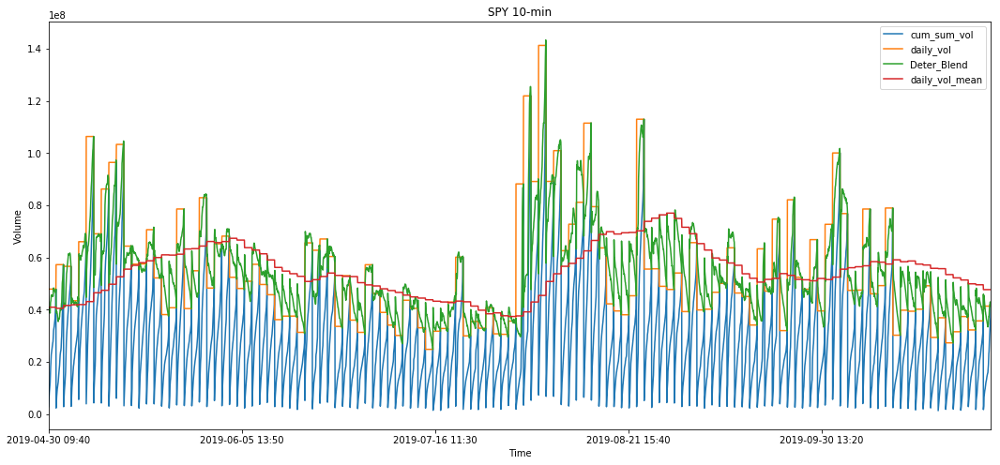

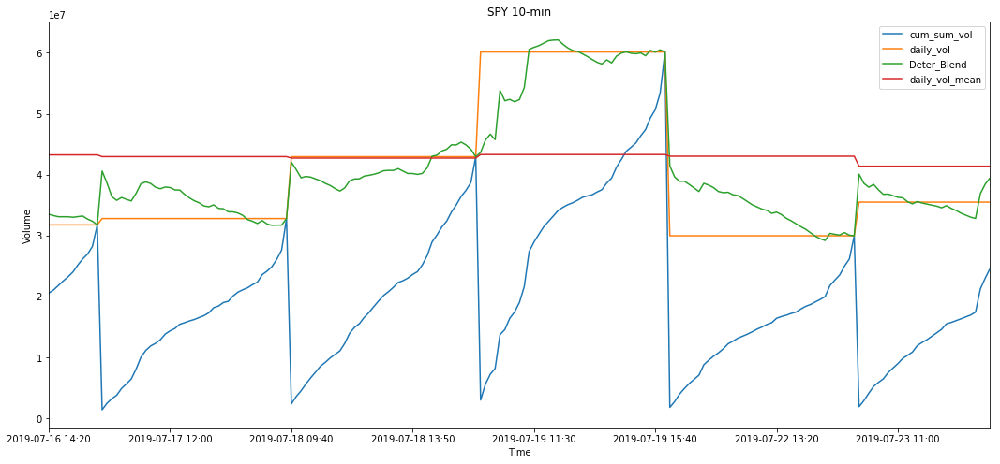

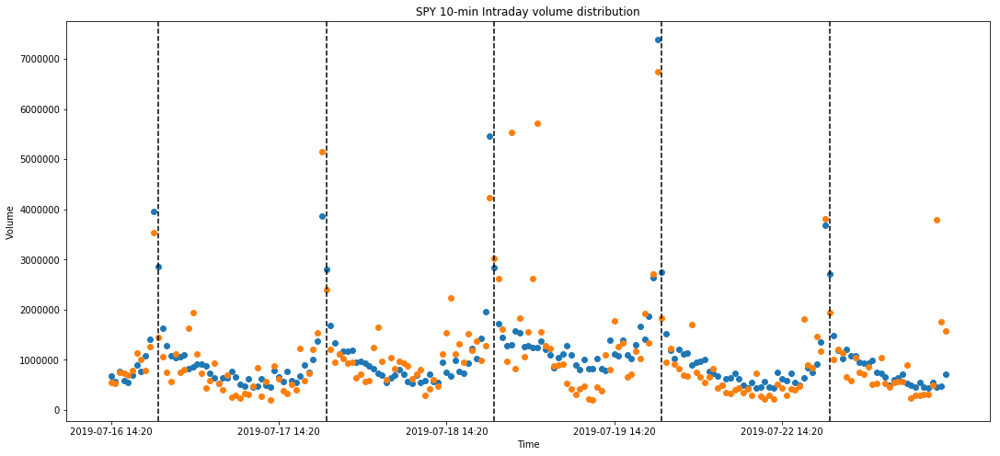

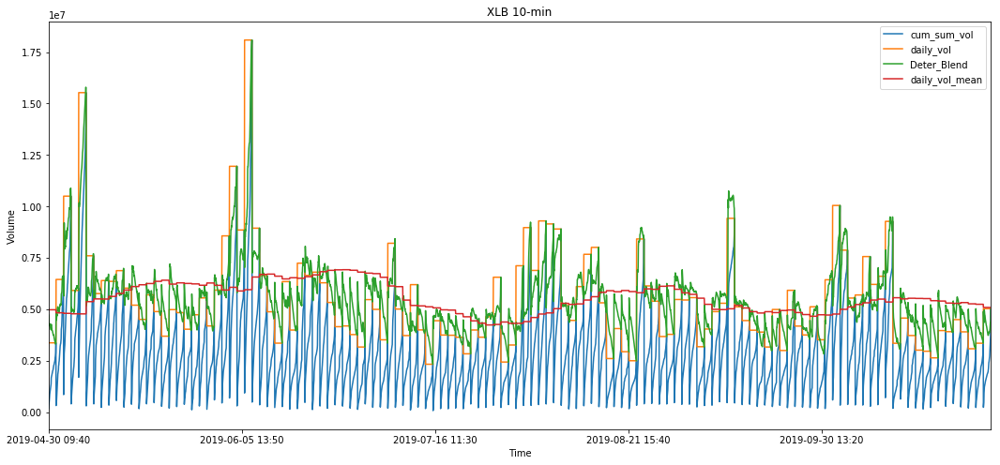

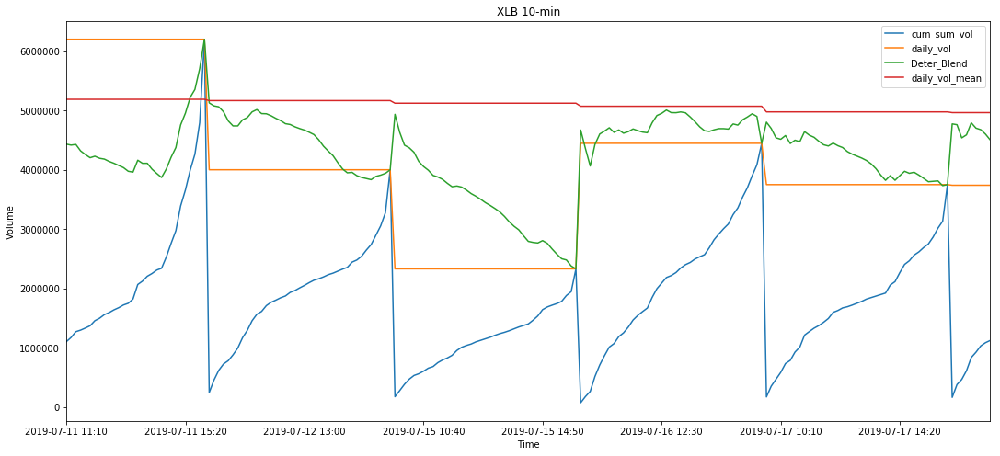

...

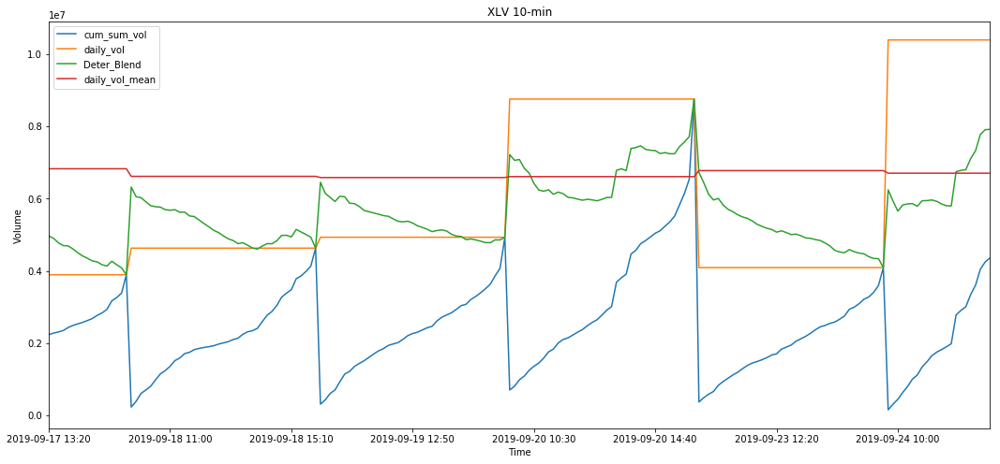

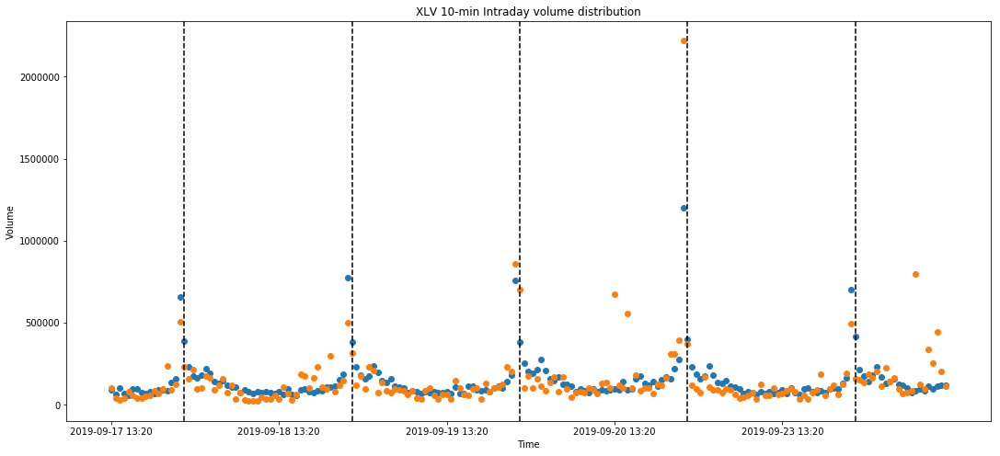

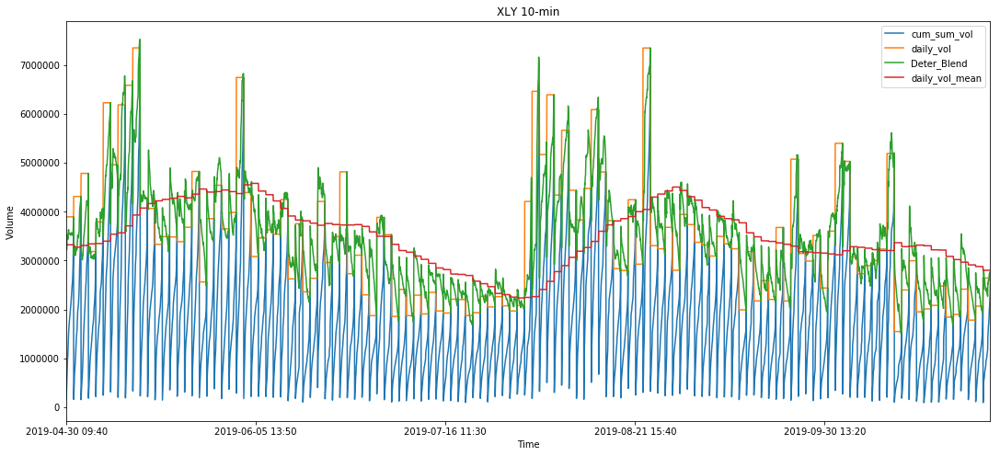

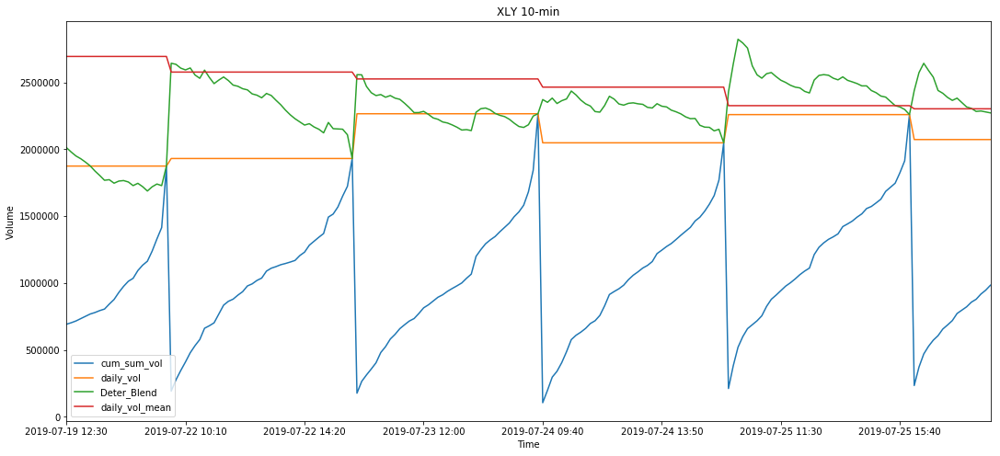

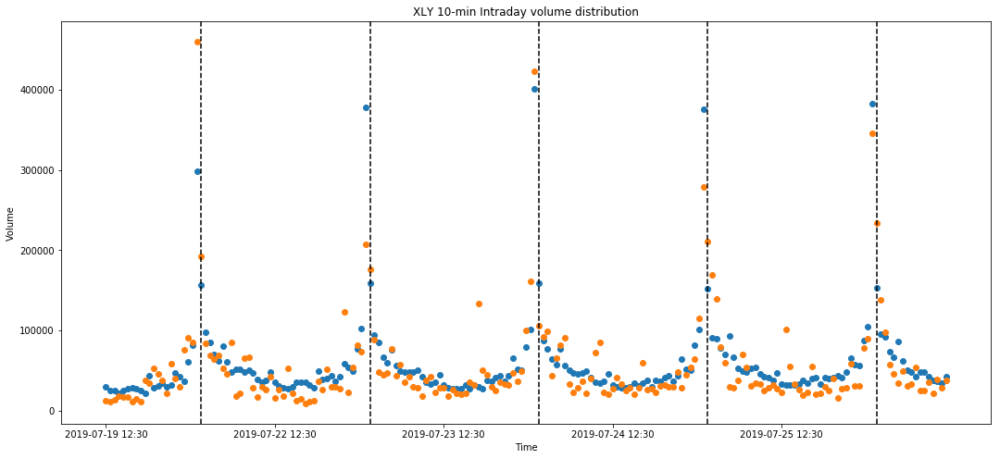

In [176]:
# For whole data set & for random continuous 5 days for each sym

import random
import matplotlib.dates as mdates

for sym_name in syms:
    mask = df_Dterm_10.sym == sym_name
    temp = df_Dterm_10[mask].dropna().set_index("date_time")
    temp.index = temp.index.to_series().apply(lambda x: x.strftime('%Y-%m-%d %H:%M'))
    index = random.randrange(0,4095)
    ax = temp[["cum_sum_vol","daily_vol","Deter_Blend","daily_vol_mean"]].plot(figsize = (18, 8),title = sym_name + " 10-min")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    
    rand_temp = temp.iloc[index:index+5*39]
    ax = rand_temp[["cum_sum_vol","daily_vol","Deter_Blend","daily_vol_mean"]].plot(figsize = (18, 8),title = sym_name+ " 10-min")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    
    fig, ax = plt.subplots(figsize=(18,8))
    ax.scatter(rand_temp.index, rand_temp["Deter_Blend_interval_vol"],label= "Deter_Blend_interval_vol")
    ax.scatter(rand_temp.index, rand_temp["volume"],label= "realized volume")
    xpositions = rand_temp[rand_temp.time==datetime.strptime('09:40', '%H:%M').time()].index.values
    for xc in xpositions:
        plt.axvline(x=xc, color='k', linestyle='--')
    ax.set_xticks(rand_temp.index[::39])
    ax.set_title(sym_name + " 10-min" + " Intraday volume distribution")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    plt.show()
    

## 2. Lorgnormal Bayesian

In [178]:
all_time = list(set(df_Dterm_10["time"]))
all_time.sort()
all_date = list(set(df_Dterm_10["date"]))
all_date.sort()

In [179]:
def LogBayesian(df, sym, wait_time = 6):
    
    for date in all_date[20:]:

        mask0 = (df["date"] == date) & (df["time"] == datetime.strptime('09:40', '%H:%M').time())
        temp = df.loc[mask0,:]
             
        V_ = temp.daily_vol_mean.values  
        mu_0 =temp.daily_vol_log_mean.values  
        sig_0 = np.sqrt(np.log(1 + temp.daily_vol_std**2/V_**2))
        
        day_log_vol = []
    
        for t in all_time:

            mask1 = ((df["date"] == date) & (df["time"] == t))
            temp2 = df.loc[mask1,:]
            u = temp2.vol_prof_mean.values
            x = np.log(temp2.volume / u )
            V_t = temp2.cum_sum_vol.values
            
            day_log_vol.append(x.values)
            last_pred = V_
              # wait 1 hour
            if t <= datetime.strptime('10:40', '%H:%M').time():
                df.loc[ mask1, "B_pred_vol"] = V_
                df.loc[ mask1, "B_pred_interval_vol"] = V_*u

            else:
                new_var = np.var(day_log_vol)
                new_mean = np.mean(day_log_vol)
                v_t = temp2.cum_vol_prof.values
                n = len(day_log_vol)
                miu = (mu_0/sig_0**2 + n*new_mean/new_var)/(1/sig_0**2 + n/new_var)
                pred_full = (V_t + (1-v_t)*np.exp(miu)).values
                pred_full = max(pred_full, df.loc[mask1,"cum_sum_vol"].values)
                df.loc[ mask1, "B_pred_vol"] = pred_full
                df.loc[ mask1, "B_pred_interval_vol"] = last_pred*u
                last_pred = pred_full
            
   
    return df
                

In [180]:
import time

start = time.time()

Bayesian_dict_10 = dict()

for sym_name in syms:
    mask = df_Dterm_10.sym == sym_name
    temp = df_Dterm_10[mask]
    Bayesian_dict_10[sym_name] = LogBayesian(temp,sym_name)
    
end = time.time()

print('The time cost: ')
print(end - start)

Bayesian_dict_10

The time cost: 
423.22904777526855


{'SPY':       sym           date_time     volume        date      time   daily_vol  \
 0     SPY 2019-04-01 09:40:00  4842694.0  2019-04-01  09:40:00  56340858.0   
 1     SPY 2019-04-01 09:50:00  2019539.0  2019-04-01  09:50:00  56340858.0   
 2     SPY 2019-04-01 10:00:00  1429654.0  2019-04-01  10:00:00  56340858.0   
 3     SPY 2019-04-01 10:10:00  3075664.0  2019-04-01  10:10:00  56340858.0   
 4     SPY 2019-04-01 10:20:00  1311680.0  2019-04-01  10:20:00  56340858.0   
 ...   ...                 ...        ...         ...       ...         ...   
 5650  SPY 2019-10-30 15:20:00  1061120.0  2019-10-30  15:20:00  41379967.0   
 5651  SPY 2019-10-30 15:30:00  1763842.0  2019-10-30  15:30:00  41379967.0   
 5652  SPY 2019-10-30 15:40:00  1247371.0  2019-10-30  15:40:00  41379967.0   
 5653  SPY 2019-10-30 15:50:00  1483266.0  2019-10-30  15:50:00  41379967.0   
 5654  SPY 2019-10-30 16:00:00  4299320.0  2019-10-30  16:00:00  41379967.0   
 
       daily_vol_mean  daily_vol_std  daily

In [181]:
# Save a dictionary into a pickle file.

pickle.dump(Bayesian_dict_10, open("Bayesian_dict_10.p", "wb"))  # save dict into a file named Bayesian_dict.p


In [182]:
# -------------------------------------------------------------
# Load the dictionary back from the pickle file.

Bayesian_dict = pickle.load(open("Bayesian_dict_10.p", "rb"))

## Visualization


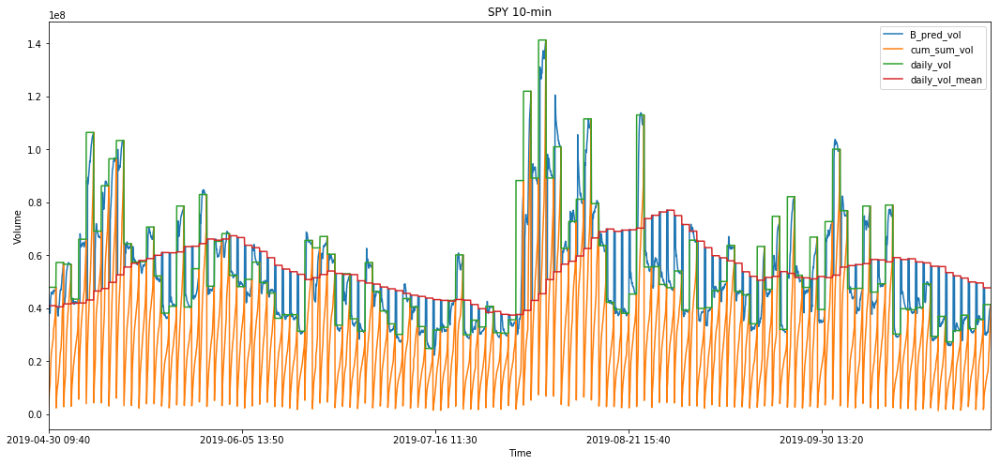

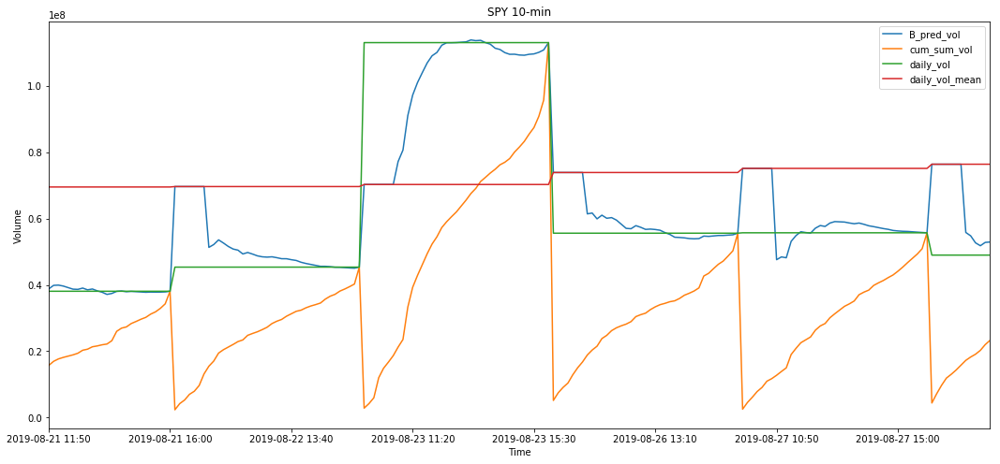

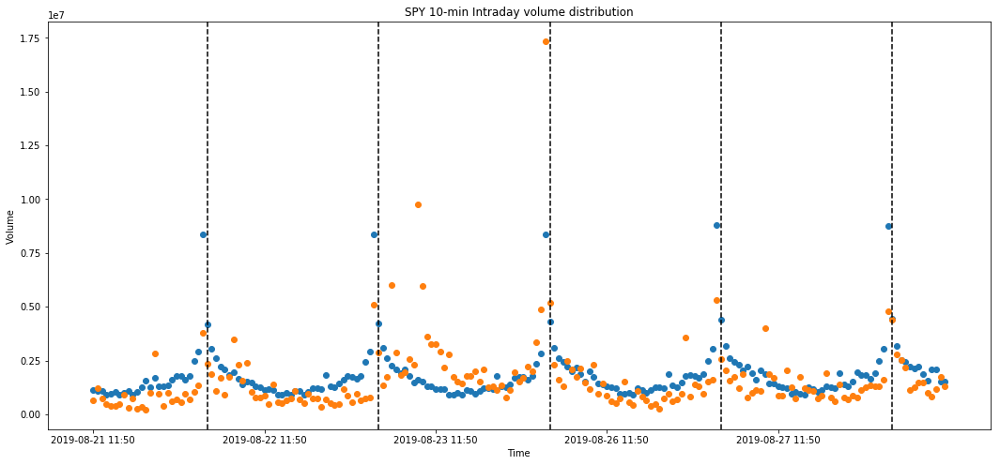

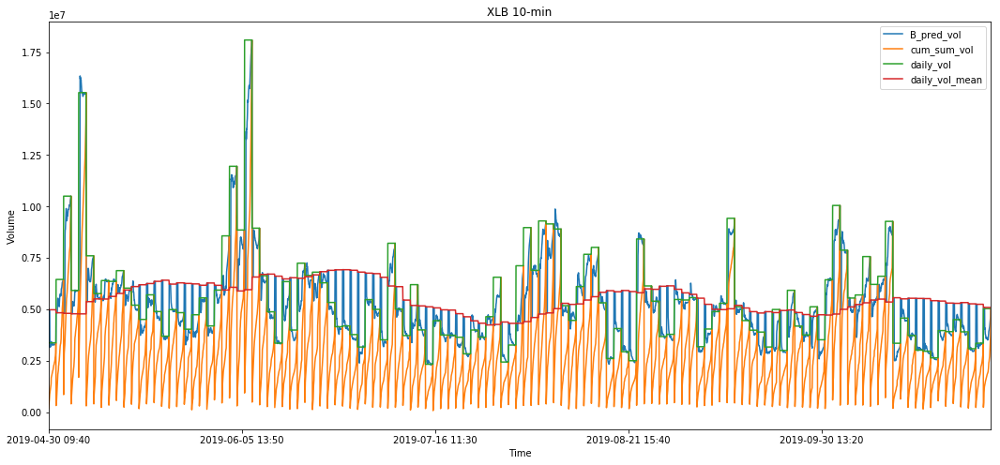

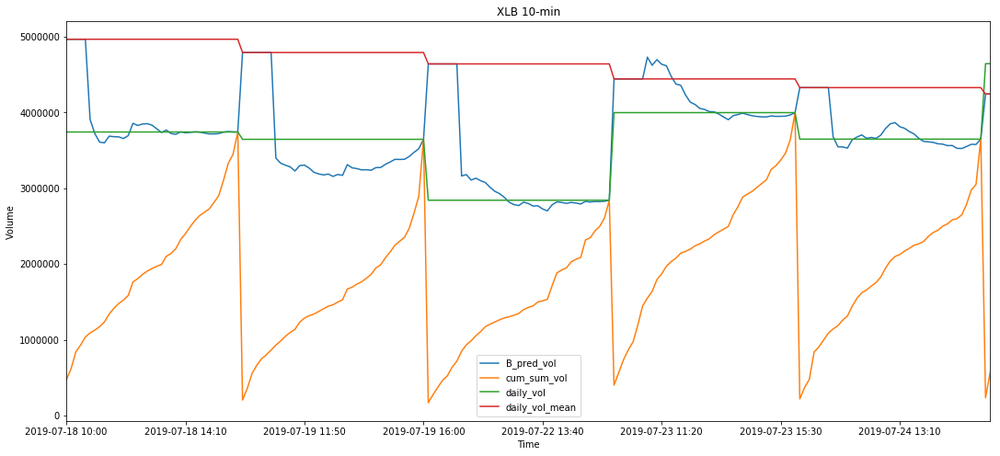

...

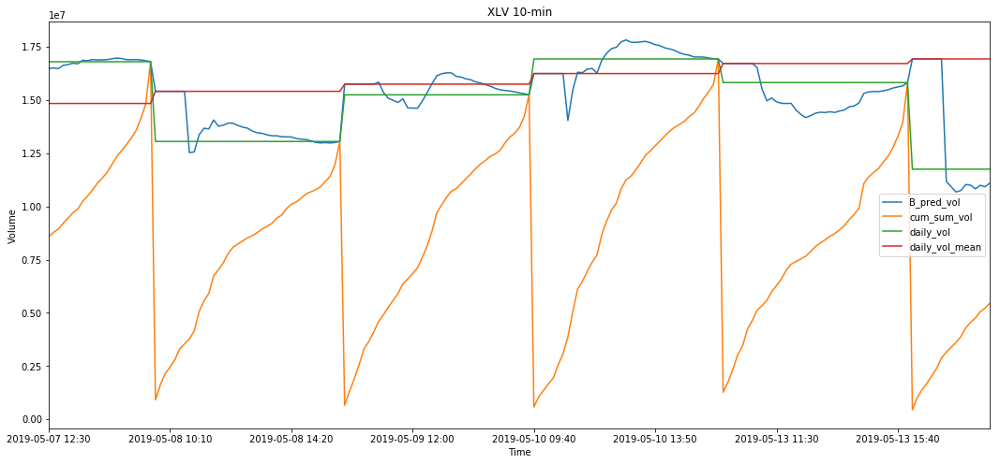

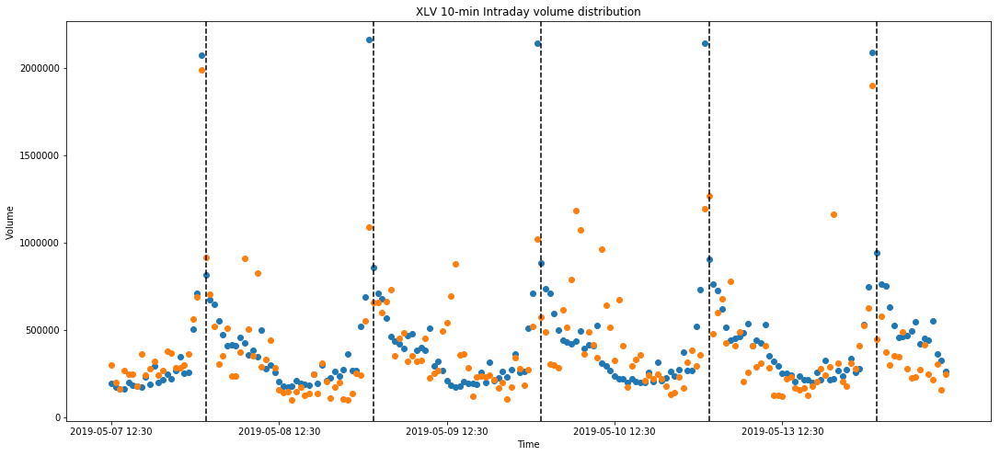

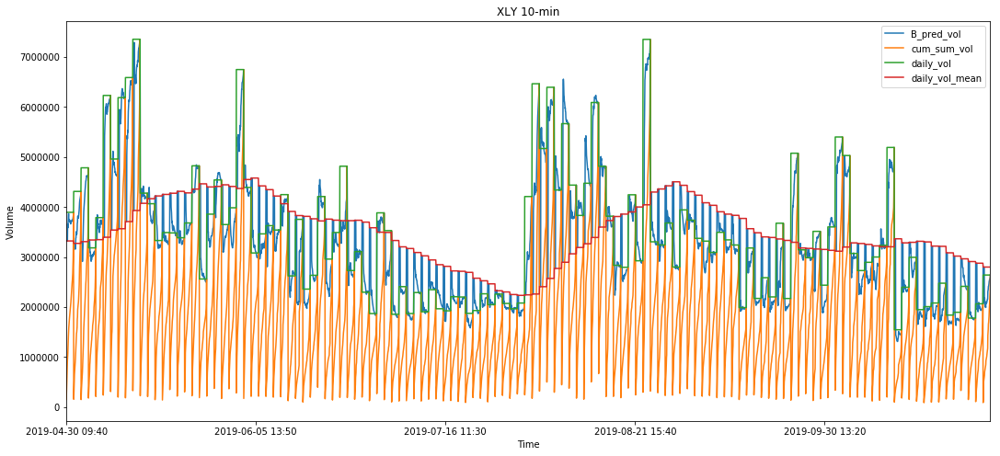

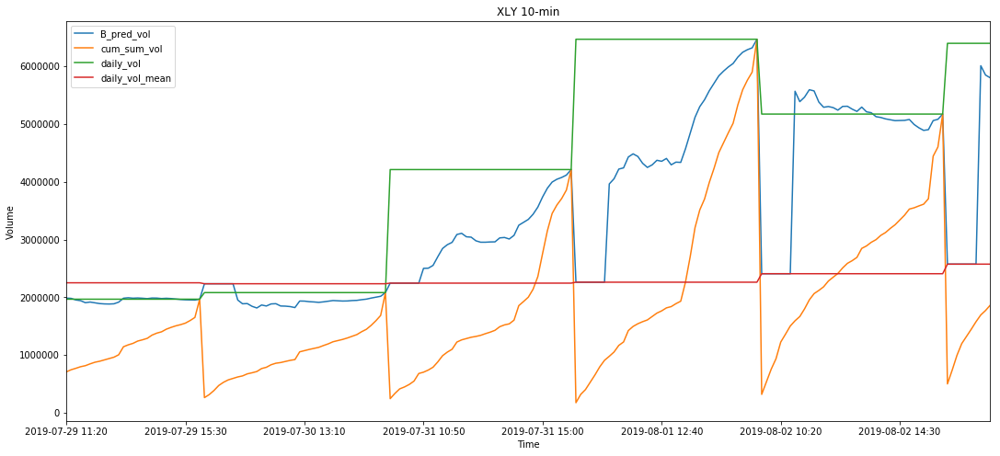

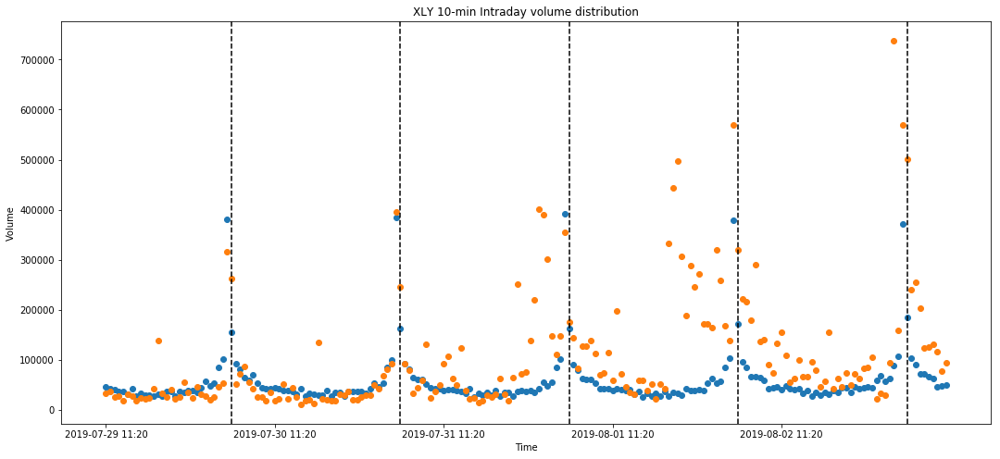

In [183]:
# For whole data set & and show details for random continuous 5 days for each sym

for sym_name in syms:
    
    temp = Bayesian_dict_10[sym_name].dropna().set_index("date_time")
    temp.index = temp.index.to_series().apply(lambda x: x.strftime('%Y-%m-%d %H:%M'))
    index = random.randrange(0,4095)
    
    ax = temp[["B_pred_vol","cum_sum_vol","daily_vol","daily_vol_mean"]].plot(figsize = (18, 8),title = sym_name+ " 10-min")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    
    rand_temp = temp.iloc[index:index+5*39]
    ax = rand_temp[["B_pred_vol","cum_sum_vol","daily_vol","daily_vol_mean"]].plot(figsize = (18, 8),title = sym_name+ " 10-min")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    
    fig, ax = plt.subplots(figsize=(18,8))
    ax.scatter(rand_temp.index, rand_temp["B_pred_interval_vol"],label= "B_pred_interval_vol")
    ax.scatter(rand_temp.index, rand_temp["volume"],label= "realized volume")
    xpositions = rand_temp[rand_temp.time==datetime.strptime('09:40', '%H:%M').time()].index.values
    for xc in xpositions:
        plt.axvline(x=xc, color='k', linestyle='--')
    ax.set_xticks(rand_temp.index[::39])
    ax.set_title(sym_name + " 10-min"+ " Intraday volume distribution")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    plt.show()


## 3. Kalman Filter

In [128]:
all_time = list(set(Bayesian_dict_10["SPY"].time))
all_time.sort()
all_date = list(set(Bayesian_dict_10["SPY"].date))
all_date.sort()

In [129]:
def Kalman(df, sym):
    
    for date in all_date[20:]:
        
        mask0 = (df["date"] == date) & (df["time"] == datetime.strptime('09:40', '%H:%M').time())
        temp = df.loc[mask0,:]
        ADV = temp.daily_vol_mean.values
        P0 = temp.daily_vol_std.values ** 2
        x0 = ADV
             
        
        for t in all_time:
   
            mask1 = ((df["date"] == date) & (df["time"] == t))
            temp2 = df[mask1]
            y = temp2.cum_sum_vol.values
            
            if t == datetime.strptime('09:40', '%H:%M').time():
                P = P0
                x = x0
                last_pred = ADV
                
            u = temp2.vol_prof_mean.values
            miu = temp2.cum_vol_prof_mean.values
            R = ADV**2 * temp2.cum_vol_prof_var.values
            K = (miu * P) / (miu ** 2 * P + R)
            P = (1 - K*miu) * P
            x = x + K * (y - miu*x)
            
            df.loc[mask1, "K_pred_vol"] = x
            df.loc[mask1, "K_pred_interval_vol"] = last_pred * u
            last_pred = x


    return df
            
    

In [130]:
start = time.time()

Kalman_dict_10 = dict()

for sym_name in syms:
    
    temp = Bayesian_dict_10[sym_name]
    Kalman_dict_10[sym_name] = Kalman(temp,sym_name)
    
end = time.time()

print('The time cost: ')
print(end - start)

Kalman_dict_10

The time cost: 
266.1200098991394


{'SPY':       sym           date_time     volume        date      time   daily_vol  \
 0     SPY 2019-04-01 09:40:00  4842694.0  2019-04-01  09:40:00  56340858.0   
 1     SPY 2019-04-01 09:50:00  2019539.0  2019-04-01  09:50:00  56340858.0   
 2     SPY 2019-04-01 10:00:00  1429654.0  2019-04-01  10:00:00  56340858.0   
 3     SPY 2019-04-01 10:10:00  3075664.0  2019-04-01  10:10:00  56340858.0   
 4     SPY 2019-04-01 10:20:00  1311680.0  2019-04-01  10:20:00  56340858.0   
 ...   ...                 ...        ...         ...       ...         ...   
 5650  SPY 2019-10-30 15:20:00  1061120.0  2019-10-30  15:20:00  41379967.0   
 5651  SPY 2019-10-30 15:30:00  1763842.0  2019-10-30  15:30:00  41379967.0   
 5652  SPY 2019-10-30 15:40:00  1247371.0  2019-10-30  15:40:00  41379967.0   
 5653  SPY 2019-10-30 15:50:00  1483266.0  2019-10-30  15:50:00  41379967.0   
 5654  SPY 2019-10-30 16:00:00  4299320.0  2019-10-30  16:00:00  41379967.0   
 
       daily_vol_mean  daily_vol_std  daily

In [131]:
pickle.dump(Kalman_dict_10, open("Kalman_dict_10.p", "wb"))  # save dict into a file named Kalman_dict.p

In [132]:
Kalman_dict_10 = pickle.load(open("Kalman_dict_10.p", "rb"))

## Visualization

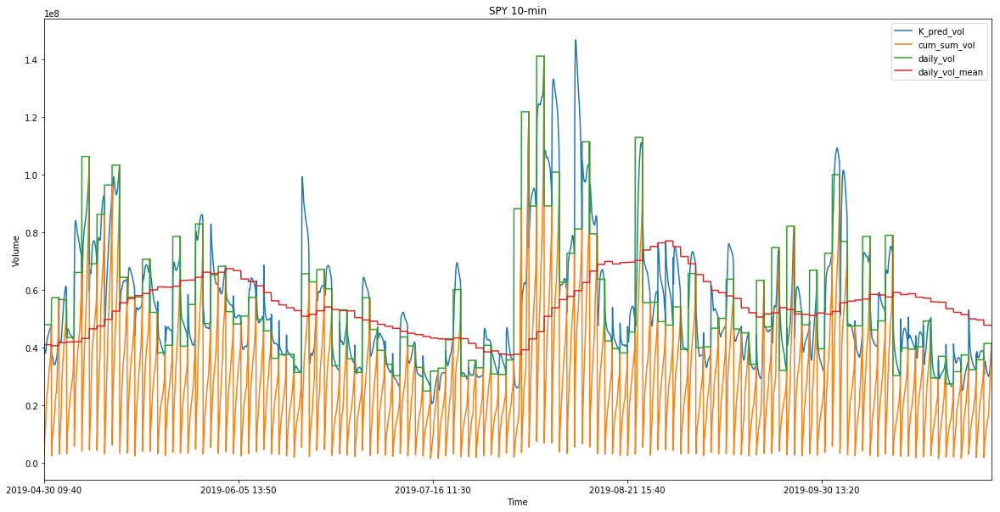

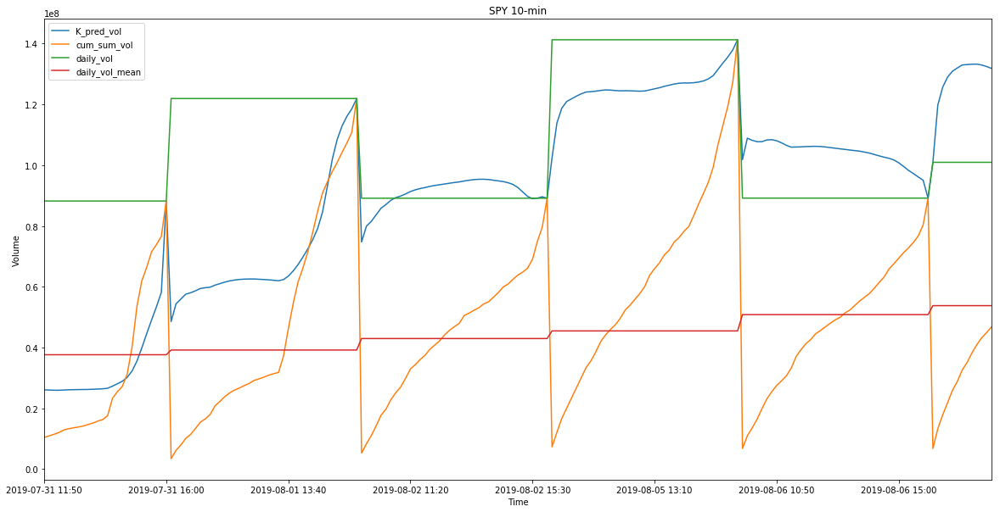

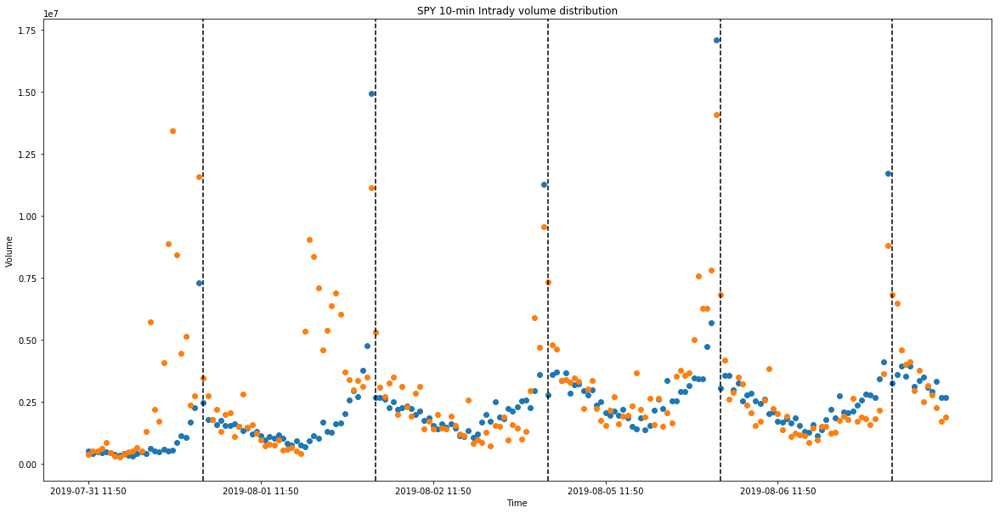

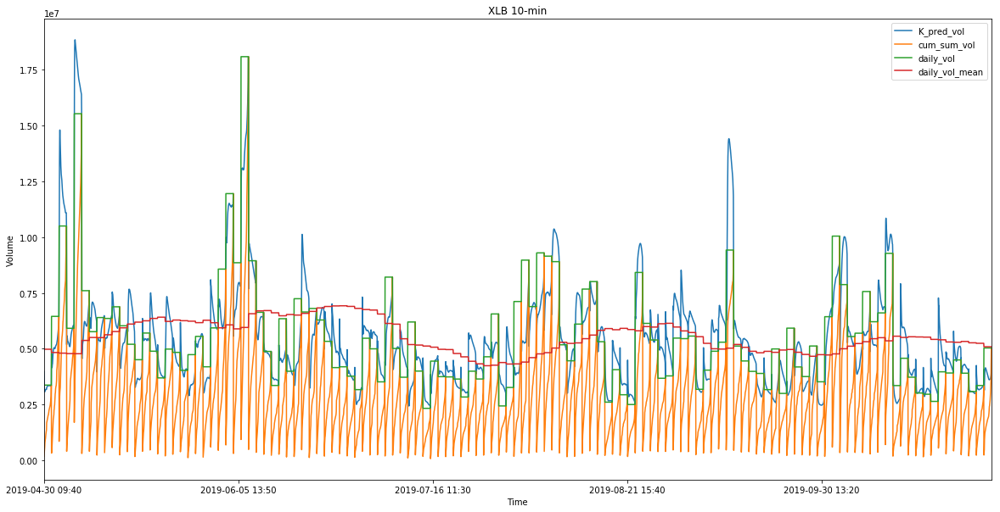

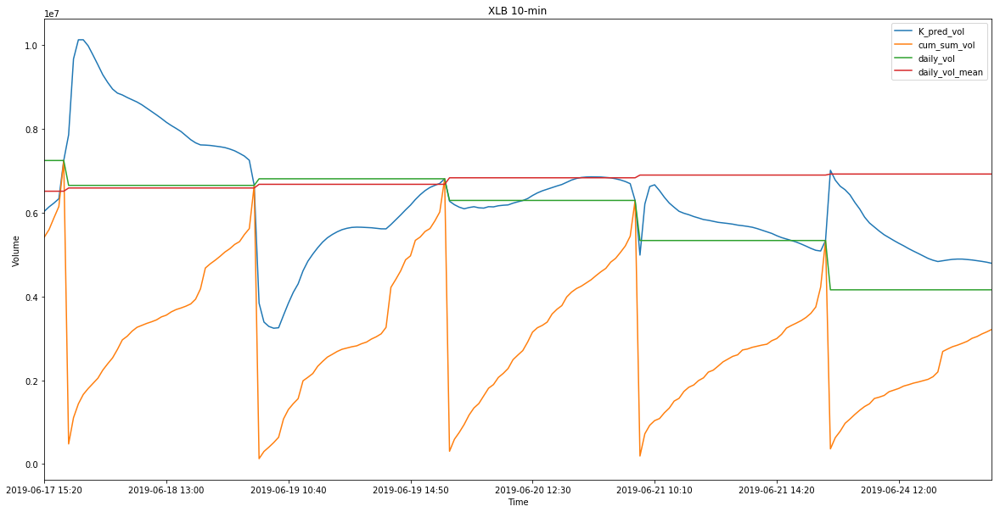

...

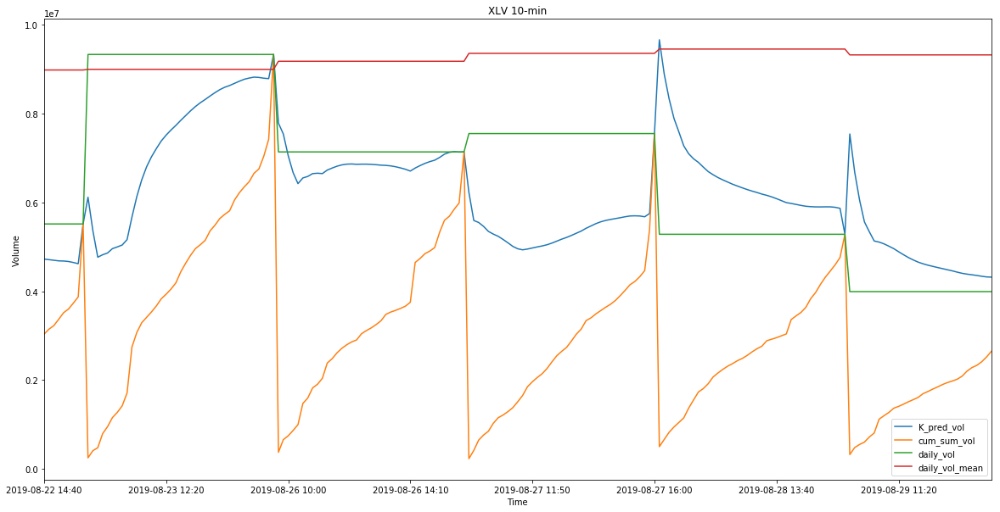

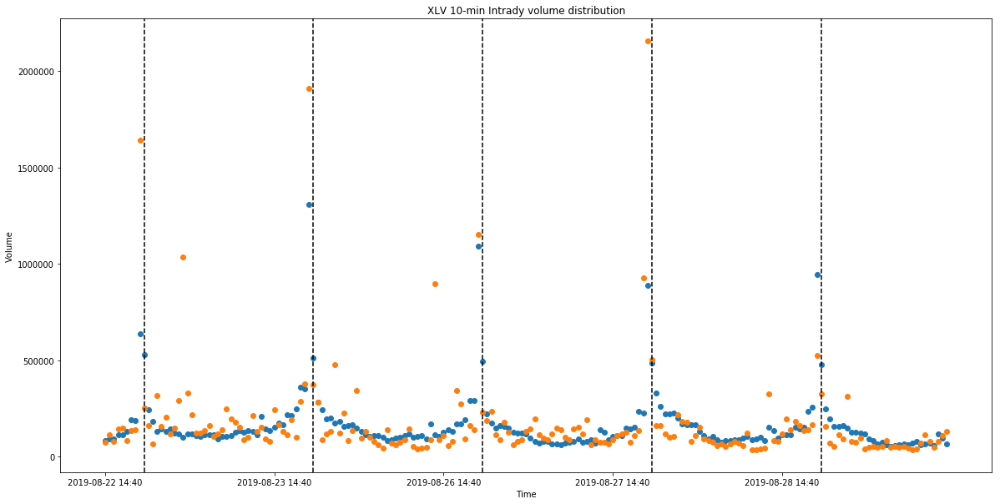

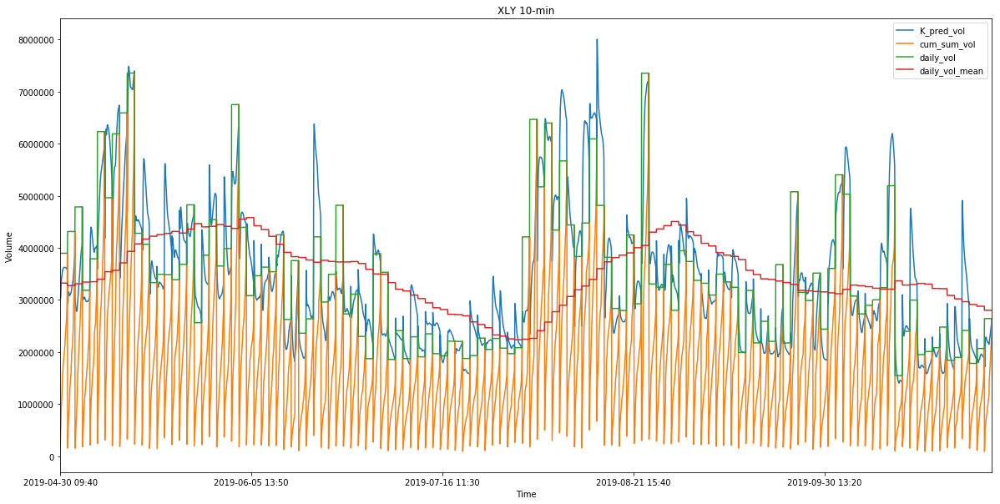

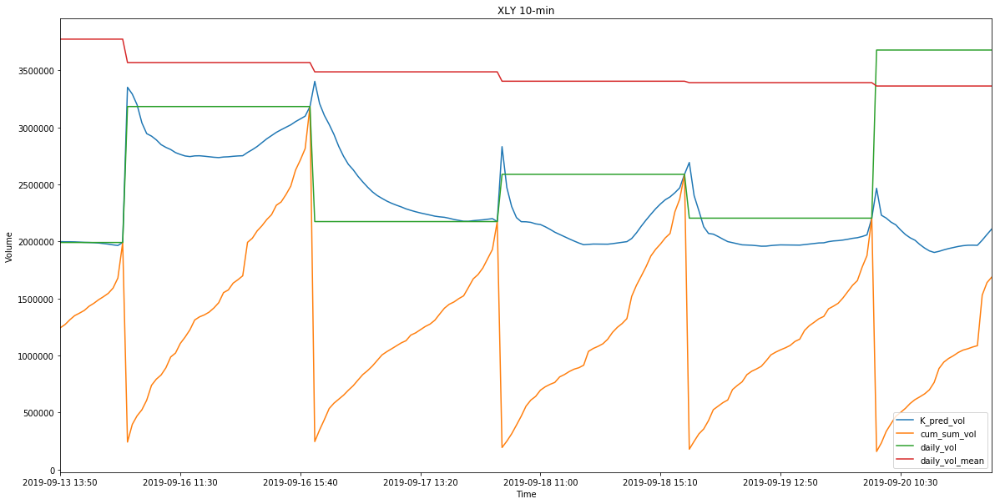

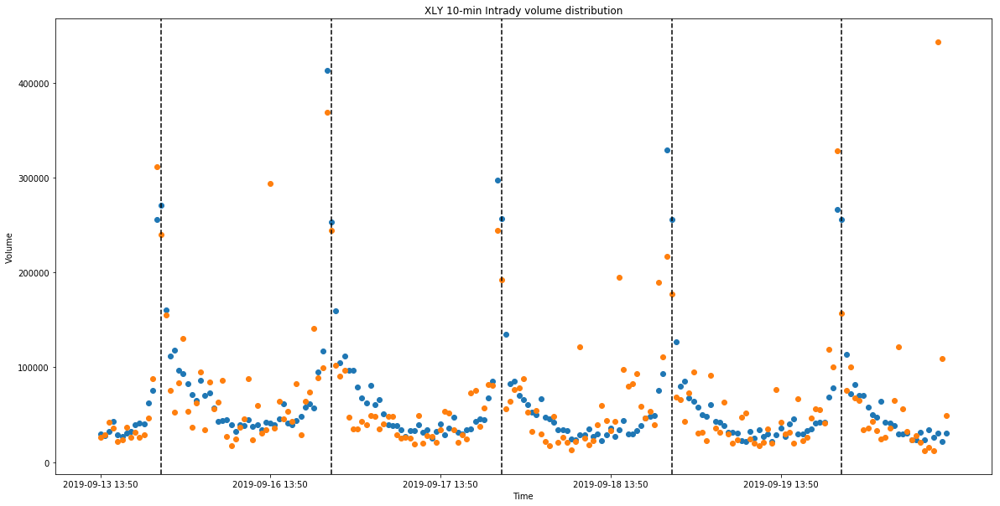

In [133]:

for sym_name in syms:
    
    temp = Kalman_dict_10[sym_name].dropna().set_index("date_time")
    temp.index = temp.index.to_series().apply(lambda x: x.strftime('%Y-%m-%d %H:%M'))
    index = random.randrange(0,4095)
    ax = temp[["K_pred_vol","cum_sum_vol","daily_vol","daily_vol_mean"]].plot(figsize = (20, 10),title = sym_name+ " 10-min")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    
    rand_temp = temp.iloc[index:index+5*39]
    ax = rand_temp[["K_pred_vol","cum_sum_vol","daily_vol","daily_vol_mean"]].plot(figsize = (20, 10),title = sym_name+ " 10-min")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    
    fig, ax = plt.subplots(figsize=(20,10))
    ax.scatter(rand_temp.index, rand_temp["K_pred_interval_vol"],label= "K_pred_interval_vol")
    ax.scatter(rand_temp.index, rand_temp["volume"],label= "realized volume")
    xpositions = rand_temp[rand_temp.time==datetime.strptime('09:40', '%H:%M').time()].index.values
    for xc in xpositions:
        plt.axvline(x=xc, color='k', linestyle='--')
    ax.set_xticks(rand_temp.index[::39])
    ax.set_title(sym_name + " 10-min" + " Intrady volume distribution")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    plt.show()
    
 

# Model Performance Analysis

In [134]:


def Errors(dict_):
    df = pd.DataFrame(columns=["sym","model","MAE","MAPE","MASE"])
    for sym in syms:
        temp = dict_[sym].copy().dropna()
        
        for model,result in zip(models, results):
            # MAE  Mean absolute error: MAE=mean(|et|)
            mae = np.mean(abs(temp[result]-temp["daily_vol"]))
           
            # MAPE Mean absolute percentage error: MAPE=mean(|pt|)
            mape = np.mean(abs(temp[result]-temp["daily_vol"])/temp["daily_vol"])
            
            # MASE  define a scaled error uses naïve forecasts
            mase = np.mean(abs(temp[result]-temp["daily_vol"])/abs(temp["daily_vol_mean"]-temp["daily_vol"]))
            
            df = df.append({"sym":sym,"model":model,"MAE":mae,"MAPE":mape,"MASE":mase} , ignore_index=True)
    return df

## 3 Performance metrics  for each sym and each model

In [135]:

models = ["Deterministic_Blend", "Log_Bayesian", "Kalman_Filter"]
results = ["Deter_Blend","B_pred_vol","K_pred_vol"]

All_performace_Result_10 = Errors(Kalman_dict_10)
All_performace_Result_10.to_csv("All_performace_Result_10.csv")

In [136]:
All_performace_Result_10

,sym,model,MAE,MAPE,MASE
0,SPY,Deterministic_Blend,8.155459e+06,0.147314,0.872036
1,SPY,Log_Bayesian,5.981617e+06,0.105204,0.689997
2,SPY,Kalman_Filter,7.964390e+06,0.133659,1.404333
3,XLB,Deterministic_Blend,9.342945e+05,0.178165,1.046335
4,XLB,Log_Bayesian,6.773323e+05,0.122013,0.851104
5,XLB,Kalman_Filter,9.324783e+05,0.166131,1.714472
6,XLC,Deterministic_Blend,5.573633e+05,0.213077,0.825562
7,XLC,Log_Bayesian,4.882314e+05,0.171218,0.650557
8,XLC,Kalman_Filter,6.519932e+05,0.229725,1.093696
9,XLE,Deterministic_Blend,1.818903e+06,0.136111,0.694377


### 3 Error measures for each model via taking the mean of those syms

In [137]:
model_result_10 = All_performace_Result_10.groupby("model").mean()
model_result_10

,MAE,MAPE,MASE
model,,,
Deterministic_Blend,2.157377e+06,0.149972,1.154327
Kalman_Filter,2.430628e+06,0.157171,1.812027
Log_Bayesian,1.689978e+06,0.113702,0.764444


# Statistical model with ARIMA prediction as initial guess : 

- Use (ARIMA) models as the initial guess for the intraday models, to improve the start of day ADV forecasting. 
Test all the models mentioned above and compare their performance.

## Choose ARIMA model through AIC (using first 60 days)

In [139]:

from statsmodels.tsa.arima_model import ARIMA

# choose ARIMA model through AIC

df_arima = pd.DataFrame(columns=["sym","ARIMA(1,1,0)", "ARIMA(0,1,1)","ARIMA(1,0,1)", "ARIMA(1,1,1)"])
for sym in syms:
    temp = daily_Stats_10[sym].ix[:60]
    model1 = ARIMA(temp.daily_log_vol, order=(1,1,0))
    model2 = ARIMA(temp.daily_log_vol, order=(0,1,1))
    model3 = ARIMA(temp.daily_log_vol, order=(1,0,1))
    model4 = ARIMA(temp.daily_log_vol, order=(1,1,1))
    model1_fit = model1.fit(disp=0)
    model2_fit = model2.fit(disp=0)
    model3_fit = model3.fit(disp=0)
    model4_fit = model4.fit(disp=0)
    df_arima = df_arima.append({"sym":sym,"ARIMA(1,1,0)":model1_fit.aic,"ARIMA(0,1,1)":model2_fit.aic,"ARIMA(1,0,1)":model3_fit.aic, "ARIMA(1,1,1)": model4_fit.aic} , ignore_index=True)
df_arima = df_arima.set_index("sym")
df_arima

,"ARIMA(1,1,0)","ARIMA(0,1,1)","ARIMA(1,0,1)","ARIMA(1,1,1)"
sym,,,,
SPY,19.150572,13.407014,10.282500,15.382143
XLB,48.537951,48.202806,43.365539,49.781997
XLC,72.884214,64.366376,60.364945,61.105173
XLE,41.991037,31.538629,26.938807,31.764185
XLF,19.278546,11.019277,6.636193,9.982138
XLI,26.391960,25.103760,21.421403,26.960129
XLK,28.190228,20.158957,18.405787,22.156064
XLP,23.767331,15.861199,11.463670,14.829824
XLRE,44.569819,39.004348,38.048869,40.875104


In [140]:
# ARIMA (p,d,q)

def ARIMA_rolling_fit(df, waiting = 60,p=1,d=0,q=1): 
    df["log_ARIMA"]= None   
    for i in range(waiting, len(df)):
        df["log_ARIMA"].ix[i] = ARIMA(df["daily_log_vol"].ix[:i],order=(p,d,q)).fit(disp=0).forecast()[0][0]
    df["log_ARIMA"] = pd.to_numeric(df["log_ARIMA"])
    return df



In [141]:
daily_Stats_new_10 = dict()

for sym_name in ['SPY', 'XLB', 'XLC', 'XLE', 'XLF', 'XLI', 'XLP', 'XLRE', 'XLU', 'XLV', 'XLY']:
    
    temp = daily_Stats_10[sym_name]
    df_ARIMA = ARIMA_rolling_fit(temp)
    df_ARIMA["ARIMA_day_vol"] = np.exp(df_ARIMA["log_ARIMA"])
    daily_Stats_new_10[sym_name]= df_ARIMA

temp = daily_Stats_10['XLK']
df_ARIMA = ARIMA_rolling_fit(temp,d=1)
df_ARIMA["ARIMA_day_vol"] = np.exp(df_ARIMA["log_ARIMA"])
daily_Stats_new_10['XLK']= df_ARIMA

SPY  MAPE:  ARIMA =  0.2561422759075284 , ADV = 0.3427938007804091
-------------------------------------------------------------------
XLB  MAPE:  ARIMA =  0.29859117849765926 , ADV = 0.361450155450967
-------------------------------------------------------------------
XLC  MAPE:  ARIMA =  0.3575556373996758 , ADV = 0.4288596530004714
-------------------------------------------------------------------
XLE  MAPE:  ARIMA =  0.24479039696982635 , ADV = 0.30597146169449096
-------------------------------------------------------------------
XLF  MAPE:  ARIMA =  0.2747896032860086 , ADV = 0.28359178833495635
-------------------------------------------------------------------
XLI  MAPE:  ARIMA =  0.29042784012739403 , ADV = 0.3048930638060833
-------------------------------------------------------------------
XLK  MAPE:  ARIMA =  0.25672324551179604 , ADV = 0.3445542865773756
-------------------------------------------------------------------
XLP  MAPE:  ARIMA =  0.2392578949782736 , ADV = 0.

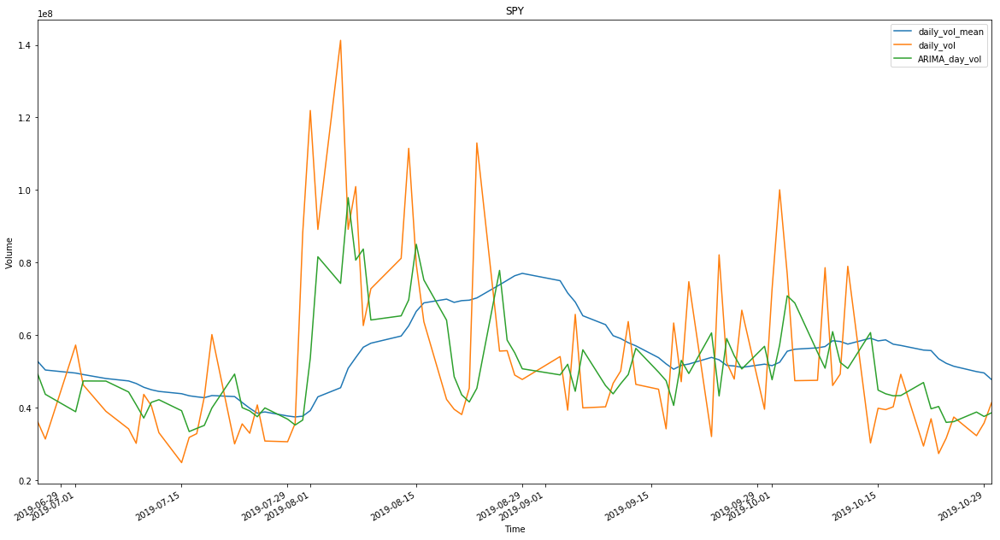

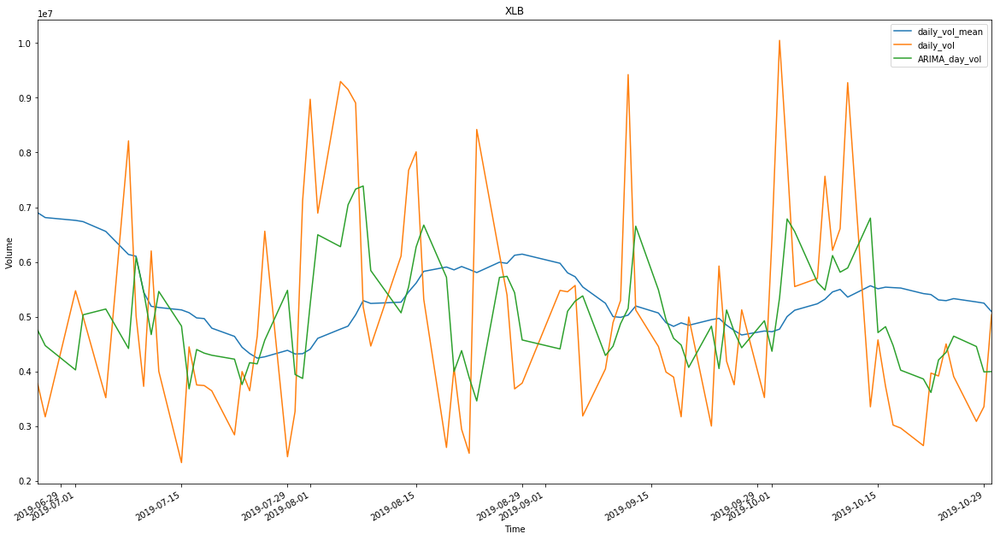

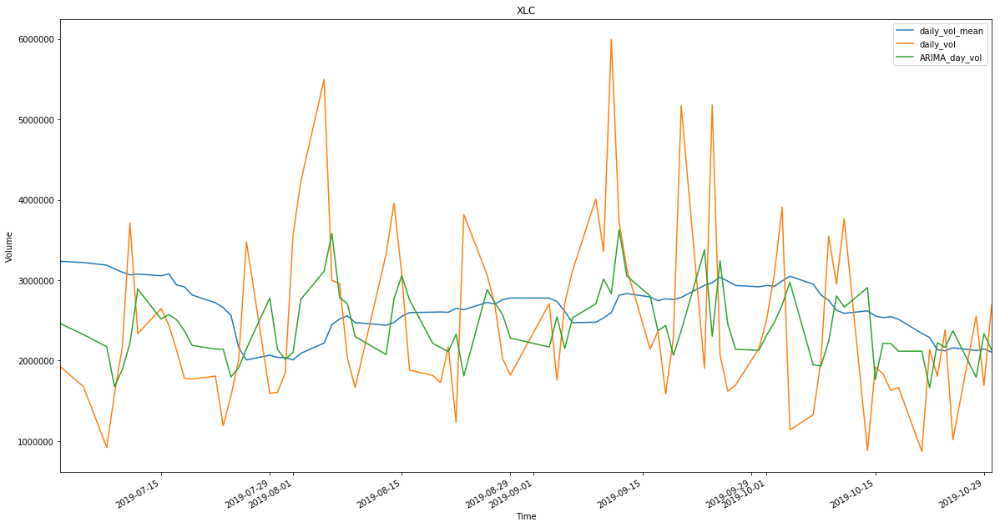

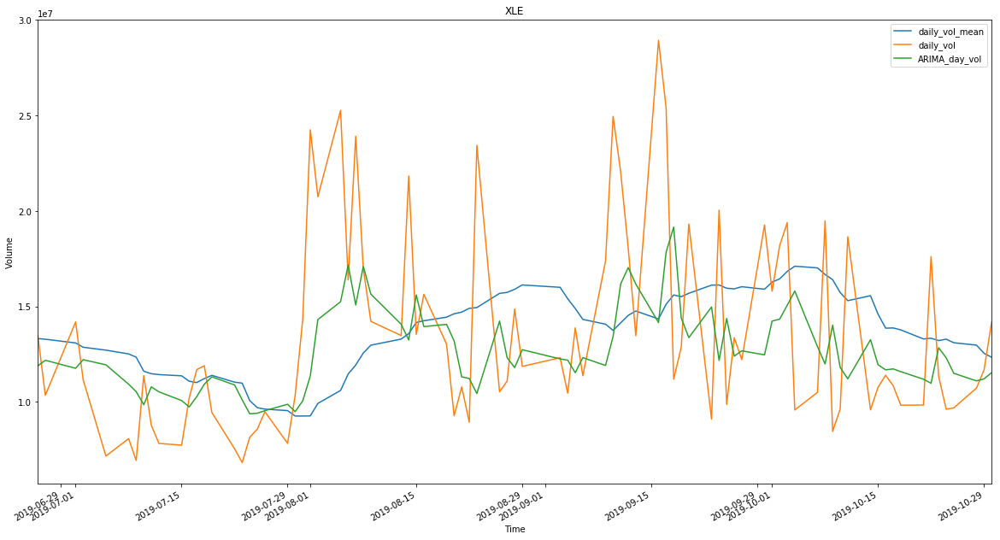

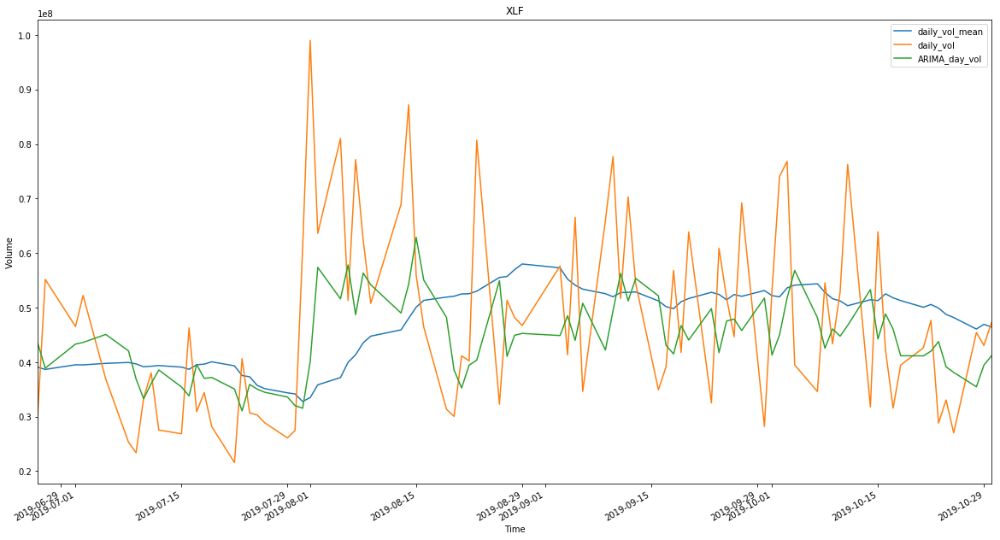

...

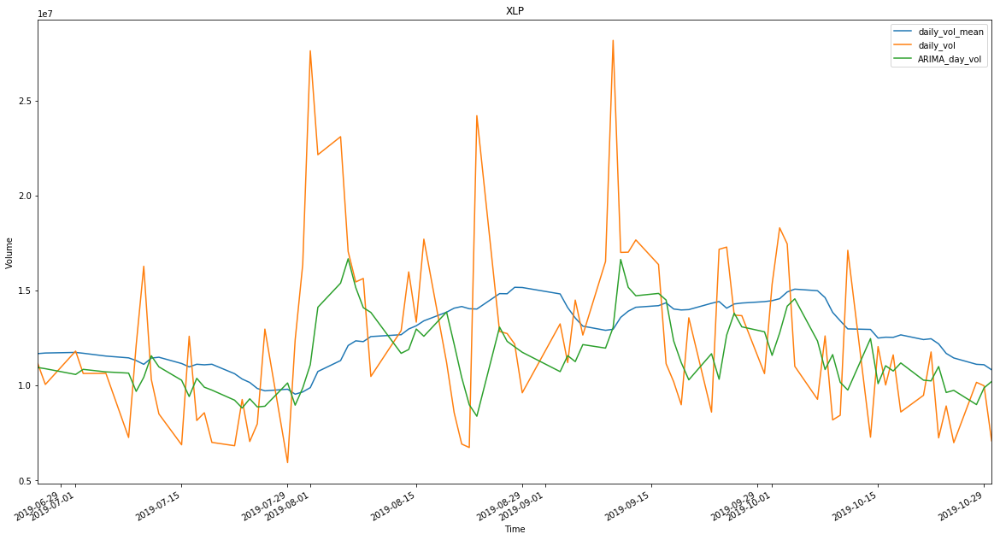

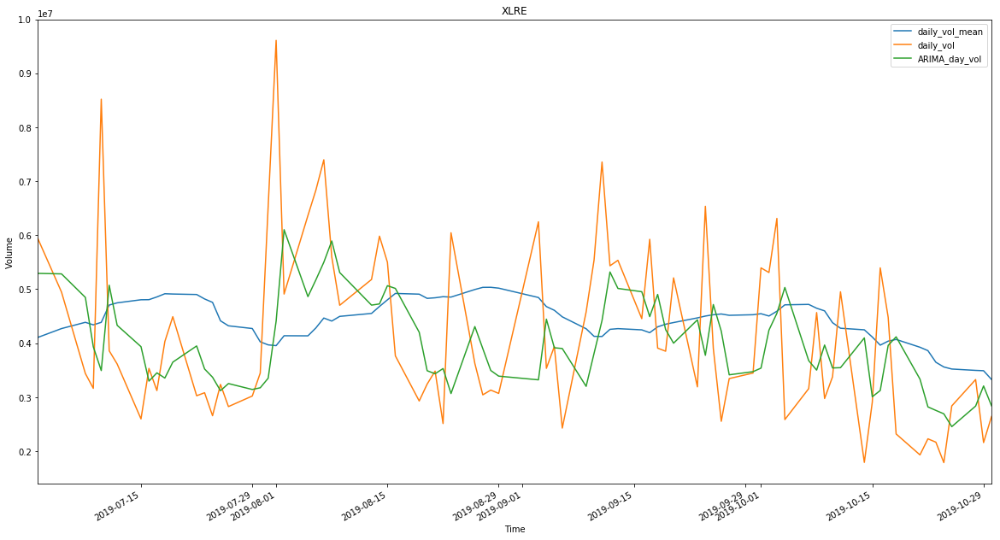

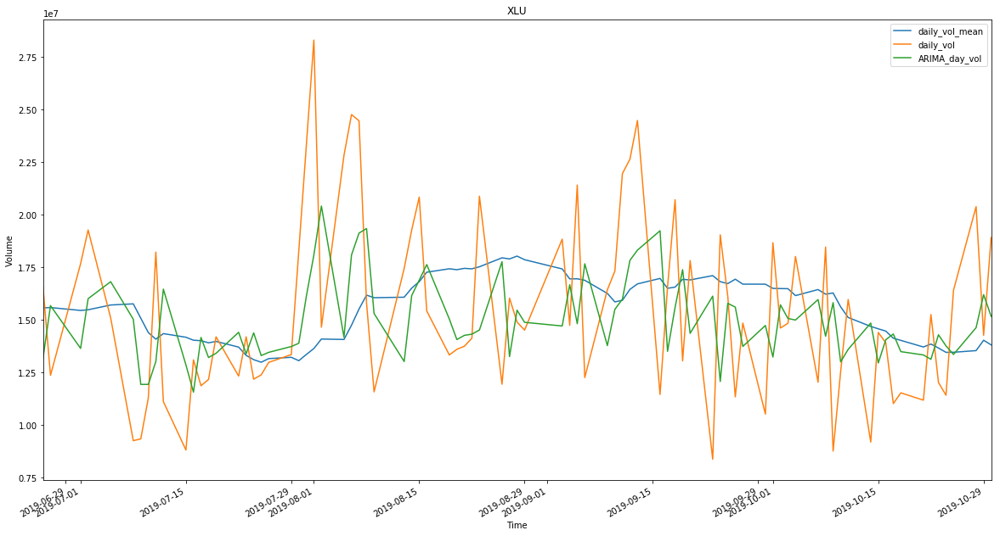

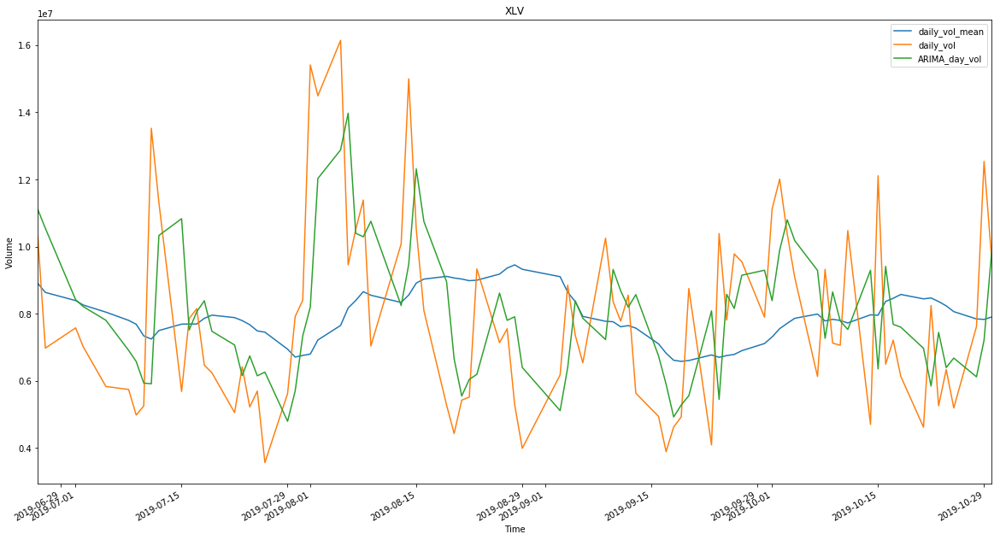

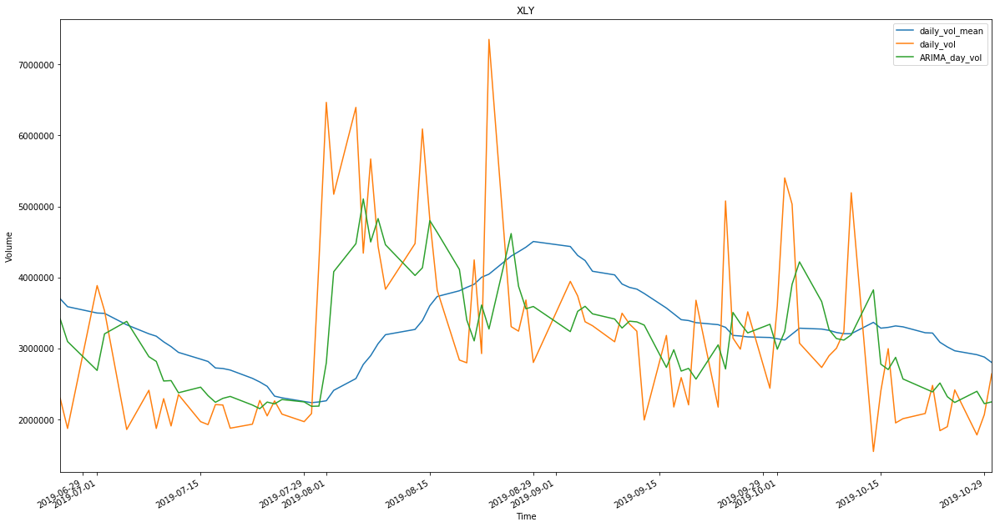

In [142]:
for sym_name in syms:
        
    temp = daily_Stats_new_10[sym_name]
    ax = temp[["daily_vol_mean","daily_vol","ARIMA_day_vol"]].dropna().plot(figsize = (20, 10),title = sym_name)
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    plt.setp(ax.get_xticklabels(), rotation=30, horizontalalignment='right')
    print( sym_name," MAPE: ", "ARIMA = " , np.mean(abs(temp["ARIMA_day_vol"]-temp["daily_vol"])/temp["daily_vol"]), ", ADV =", np.mean(abs(temp["daily_vol_mean"]-temp["daily_vol"])/temp["daily_vol"]) )
    print("-------------------------------------------------------------------")

In [143]:
for sym_name in syms:
    df_clean_10.loc[(df_clean_10.sym == sym_name),"ARIMA_day_vol"]= df_clean_10.loc[(df_clean_10.sym == sym_name),:]["date"].map(daily_Stats_new_10[sym_name]["ARIMA_day_vol"])
        

## 1. Dterm Blend

In [145]:
def DtermBlend_ARIMA(m, c, df, ADV_num):
    days = list(set(df["date"]))
    days.sort()
    
    for day in days[ADV_num:]:
        
        mask1 = (df.date == day) & (df.date_time <= (df[df.date == day].date_time.iloc[0] + timedelta(minutes = m)))
        mask2 = (df.date == day) & (df.date_time >= (df[df.date == day].date_time.iloc[0] + timedelta(minutes = m)))
    
        ADV = df.loc[(df.date == day) & (df.date_time == (df[df.date == day].date_time.iloc[0])),"ARIMA_day_vol"].values
        df.loc[mask1, "Deter_Blend_ARIMA"] = (1-df.loc[mask1,"time_diff"]*c/m)*ADV + df.loc[mask1,"time_diff"]*c/m*df.loc[mask1,"cum_sum_vol"]/df.loc[mask1,"cum_vol_prof_mean"]
        df.loc[mask2, "Deter_Blend_ARIMA"] = (1-(c+(1-c)*(df.loc[mask2,"time_diff"]-m)/(390-m)))*ADV + (c+(1-c)*(df.loc[mask2,"time_diff"]-m)/(390-m))*df.loc[mask2,"cum_sum_vol"]/df.loc[mask2,"cum_vol_prof_mean"]     
    return df

In [146]:
Dterm_list_ARIMA_10 = []

for sym_name in syms:
    mask = df_clean_10.sym == sym_name
    temp = DtermBlend_ARIMA(30, 1/3, df_clean_10[mask], ADV_num = 20)
    temp["Deter_Blend_interval_vol_ARIMA"] =  temp.groupby('date').apply(lambda x :x.Deter_Blend_ARIMA.shift(1)*x.vol_prof_mean).values
    temp.loc[temp.time==datetime.strptime('09:40', '%H:%M').time(),"Deter_Blend_interval_vol_ARIMA"] = temp[temp.time==datetime.strptime('09:40', '%H:%M').time()].ARIMA_day_vol*temp[temp.time==datetime.strptime('09:40', '%H:%M').time()].vol_prof_mean
    Dterm_list_ARIMA_10.append(temp)

df_Dterm_ARIMA_10 = pd.concat(Dterm_list_ARIMA_10)

df_Dterm_ARIMA_10

,sym,date_time,volume,date,time,daily_vol,daily_vol_mean,daily_vol_std,daily_vol_log_mean,cum_sum_vol,...,vol_prof,cum_vol_prof_var,vol_prof_mean,cum_vol_prof_mean,time_diff,ARIMA_day_vol,residual,residual_ARIMA,Deter_Blend_ARIMA,Deter_Blend_interval_vol_ARIMA
0,SPY,2019-04-01 09:40:00,4842694.0,2019-04-01,09:40:00,56340858.0,NaN,NaN,NaN,4842694.0,...,0.085954,NaN,NaN,NaN,10.0,NaN,NaN,NaN,NaN,NaN
1,SPY,2019-04-01 09:50:00,2019539.0,2019-04-01,09:50:00,56340858.0,NaN,NaN,NaN,6862233.0,...,0.035845,NaN,NaN,NaN,20.0,NaN,NaN,NaN,NaN,NaN
2,SPY,2019-04-01 10:00:00,1429654.0,2019-04-01,10:00:00,56340858.0,NaN,NaN,NaN,8291887.0,...,0.025375,NaN,NaN,NaN,30.0,NaN,NaN,NaN,NaN,NaN
3,SPY,2019-04-01 10:10:00,3075664.0,2019-04-01,10:10:00,56340858.0,NaN,NaN,NaN,11367551.0,...,0.054590,NaN,NaN,NaN,40.0,NaN,NaN,NaN,NaN,NaN
4,SPY,2019-04-01 10:20:00,1311680.0,2019-04-01,10:20:00,56340858.0,NaN,NaN,NaN,12679231.0,...,0.023281,NaN,NaN,NaN,50.0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67621,XLY,2019-10-30 15:20:00,49876.0,2019-10-30,15:20:00,2641464.0,2800757.75,1.147007e+06,14.778494,2051304.0,...,0.018882,0.002365,0.020644,0.757361,350.0,2.245670e+06,-14.322274,-17.862476,2.674207e+06,55182.476163
67622,XLY,2019-10-30 15:30:00,109448.0,2019-10-30,15:30:00,2641464.0,2800757.75,1.147007e+06,14.778494,2160752.0,...,0.041435,0.002225,0.024822,0.782183,360.0,2.245670e+06,-14.811569,-18.472716,2.733754e+06,66378.572726
67623,XLY,2019-10-30 15:40:00,72893.0,2019-10-30,15:40:00,2641464.0,2800757.75,1.147007e+06,14.778494,2233645.0,...,0.027596,0.001617,0.033477,0.815660,370.0,2.245670e+06,-18.484334,-23.053320,2.720201e+06,91518.457491
67624,XLY,2019-10-30 15:50:00,73006.0,2019-10-30,15:50:00,2641464.0,2800757.75,1.147007e+06,14.778494,2306651.0,...,0.027638,0.001391,0.051074,0.866734,380.0,2.245670e+06,-21.217397,-26.461946,2.653616e+06,138932.758909


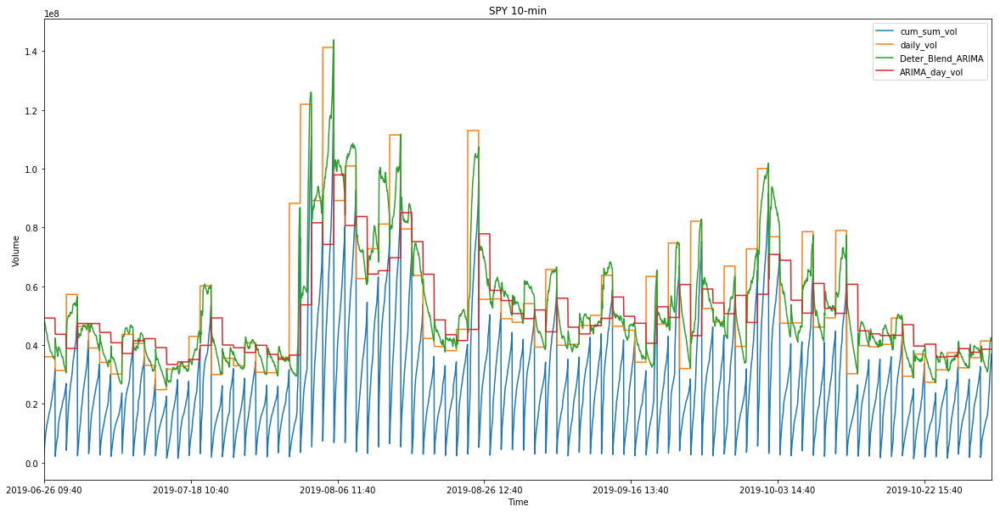

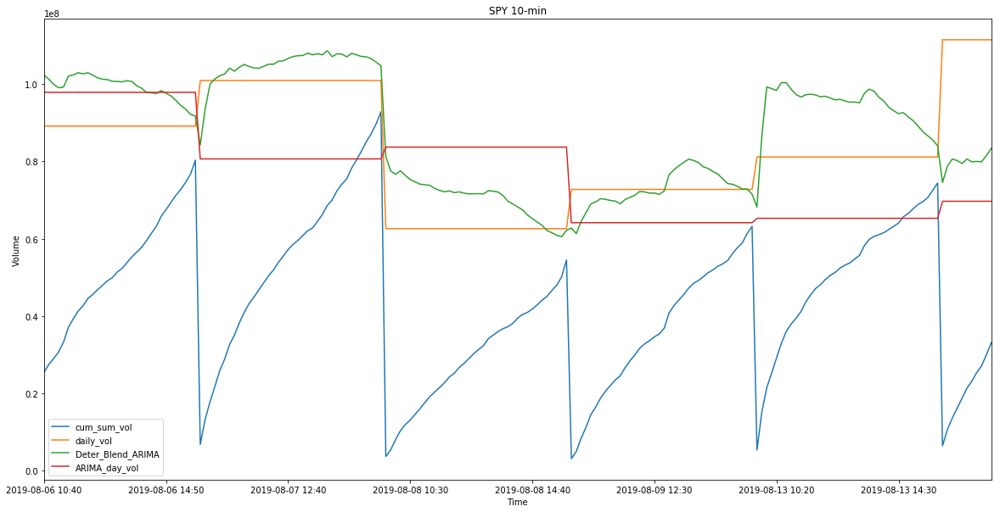

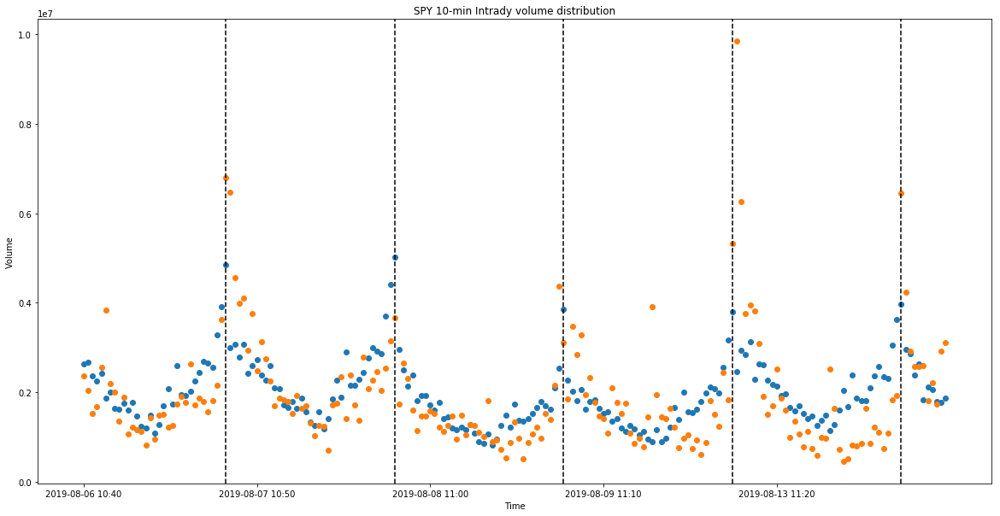

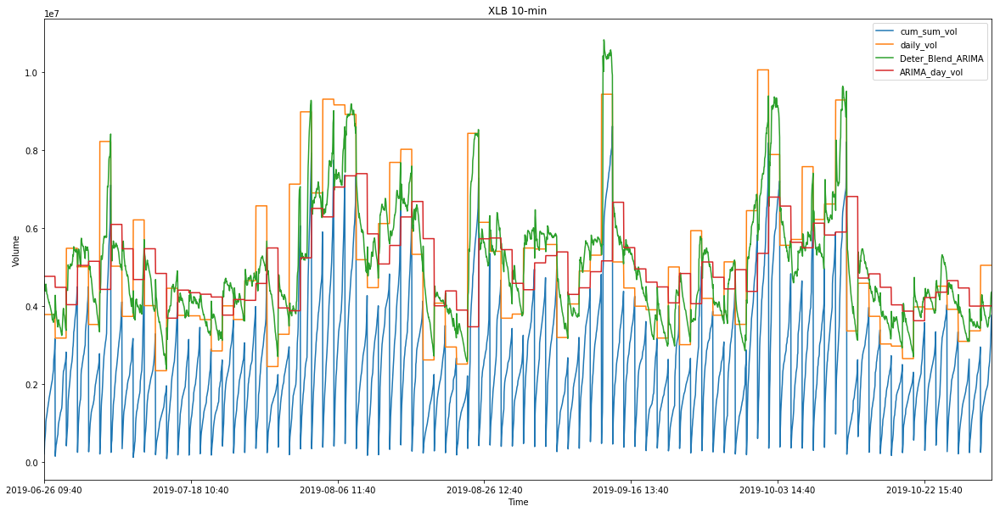

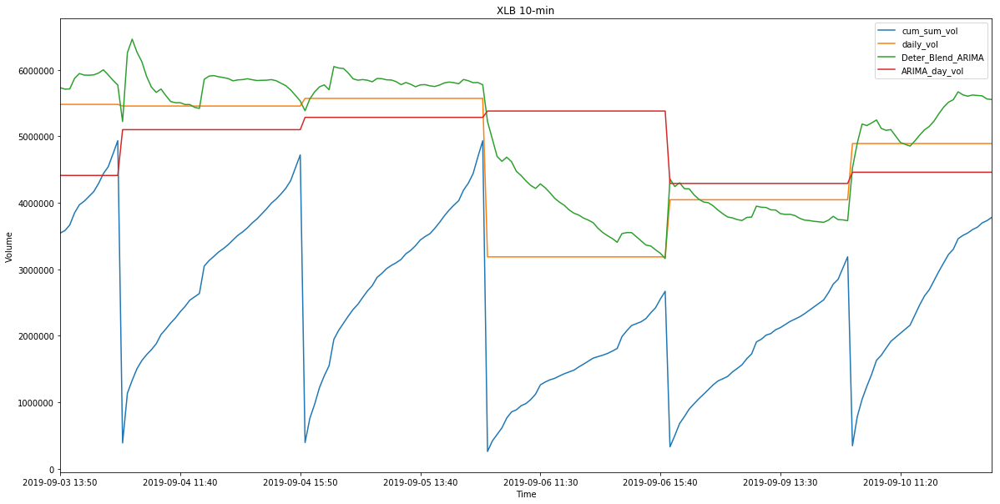

...

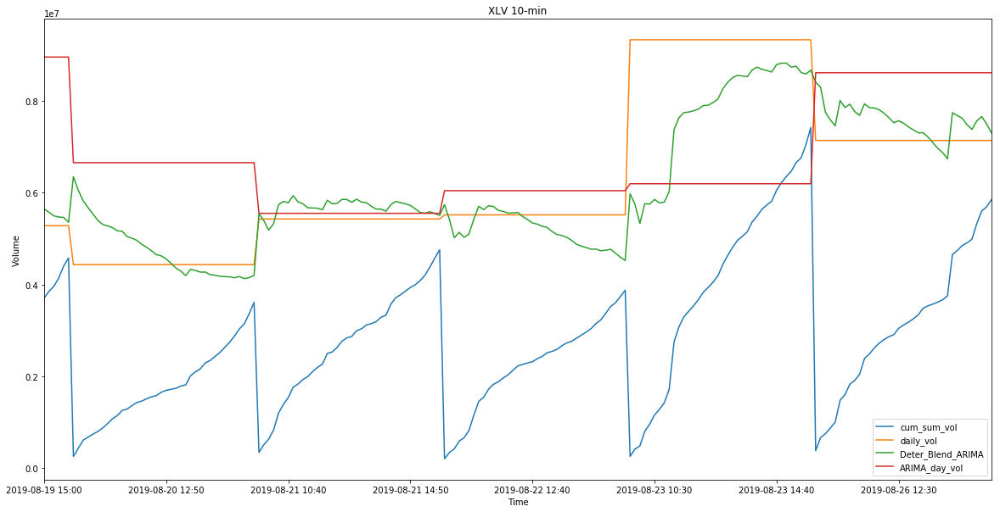

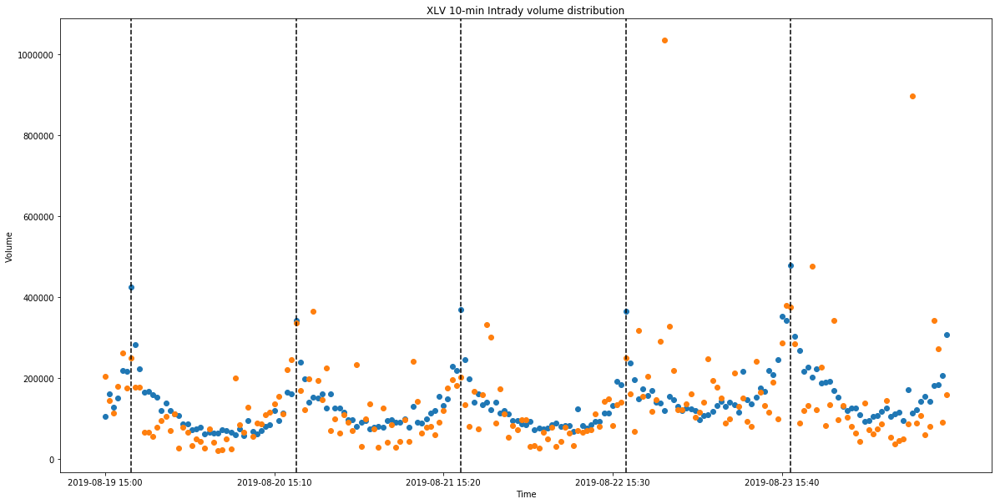

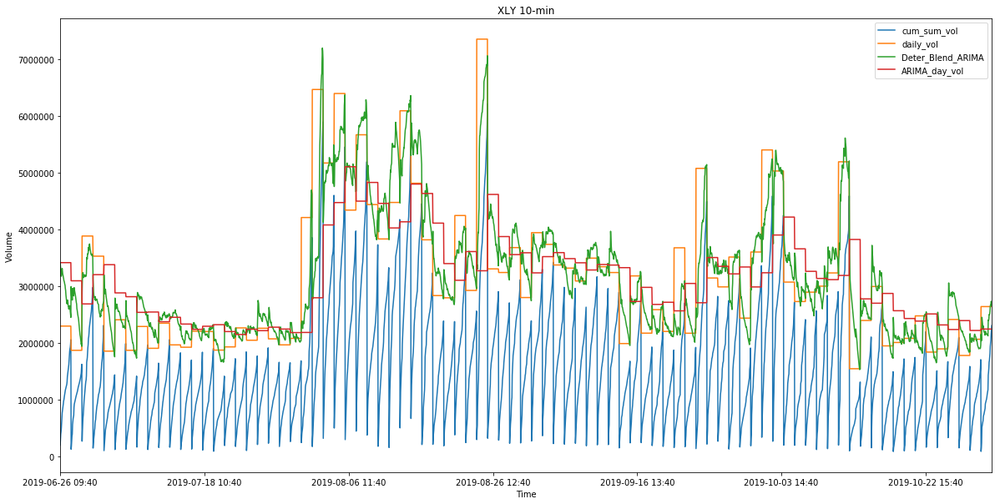

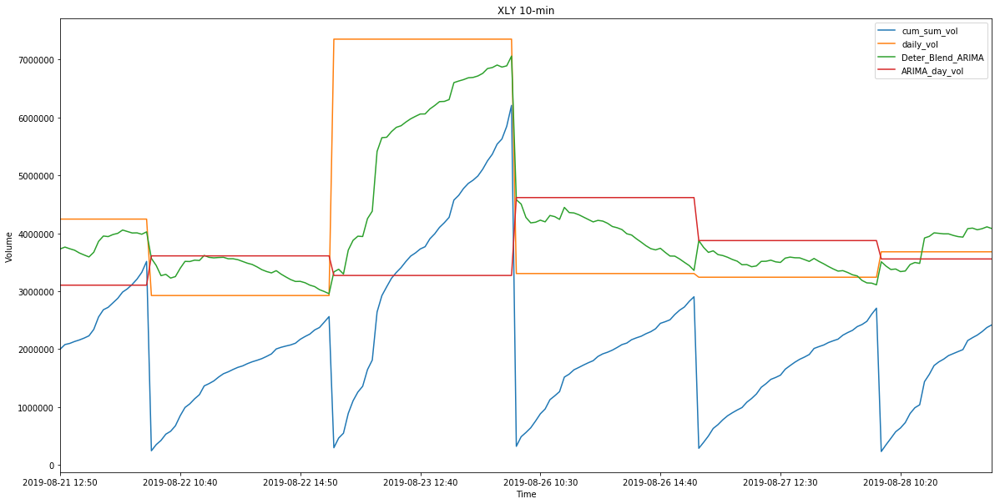

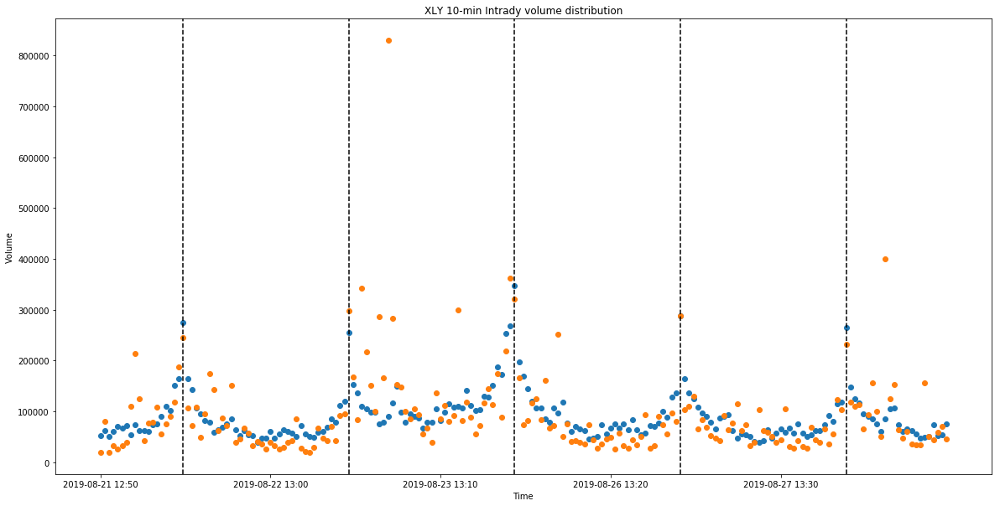

In [147]:
  
for sym_name in syms:
    mask = df_Dterm_ARIMA_10.sym == sym_name
    temp = df_Dterm_ARIMA_10[mask].dropna().set_index("date_time")
    temp.index = temp.index.to_series().apply(lambda x: x.strftime('%Y-%m-%d %H:%M'))
    index = random.randrange(0,len(temp)-5*39)
    ax = temp[["cum_sum_vol","daily_vol","Deter_Blend_ARIMA","ARIMA_day_vol"]].plot(figsize = (20, 10),title = sym_name+ " 10-min")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    
    rand_temp = temp.iloc[index:index+5*39]
    ax = rand_temp[["cum_sum_vol","daily_vol","Deter_Blend_ARIMA","ARIMA_day_vol"]].plot(figsize = (20, 10),title = sym_name+ " 10-min")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    
    fig, ax = plt.subplots(figsize=(20,10))
    ax.scatter(rand_temp.index, rand_temp["Deter_Blend_interval_vol_ARIMA"],label= "Deter_Bend_interval_vol_ARIMA")
    ax.scatter(rand_temp.index, rand_temp["volume"],label= "realized volume")
    xpositions = rand_temp[rand_temp.time==datetime.strptime('09:40', '%H:%M').time()].index.values
    for xc in xpositions:
        plt.axvline(x=xc, color='k', linestyle='--')
    ax.set_xticks(rand_temp.index[::39])
    ax.set_title(sym_name + " 10-min" + " Intrady volume distribution")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    plt.show()

## 2. Lognormal Bayesian

- Here only the prediction of first hour from opening time will change to ARIMA prediction. Others remain the same with original model.

In [148]:
Bayesian_dict_ARIMA_10 = dict()
for sym in syms:
    temp = Bayesian_dict_10[sym]
    temp["Deter_Blend_interval_vol_ARIMA"] = df_Dterm_ARIMA_10["Deter_Blend_interval_vol_ARIMA"]
    temp["Deter_Blend_ARIMA"] = df_Dterm_ARIMA_10["Deter_Blend_ARIMA"]
    temp["ARIMA_day_vol"] = df_Dterm_ARIMA_10["ARIMA_day_vol"]
    mask = temp.time <= datetime.strptime('10:40', '%H:%M').time()
    temp.loc[ :, "B_pred_vol_ARIMA"] = temp.loc[ :, "B_pred_vol"] 
    temp.loc[ :, "B_pred_interval_vol_ARIMA"] = temp.loc[ :, "B_pred_interval_vol"] 
    temp.loc[ mask, "B_pred_vol_ARIMA"] = temp.loc[ mask, "ARIMA_day_vol"] 
    temp.loc[ mask, "B_pred_vol"] = temp.loc[mask, "B_pred_vol_ARIMA"]*temp.loc[ mask, "vol_prof_mean"]
    Bayesian_dict_ARIMA_10[sym] = temp                                                     

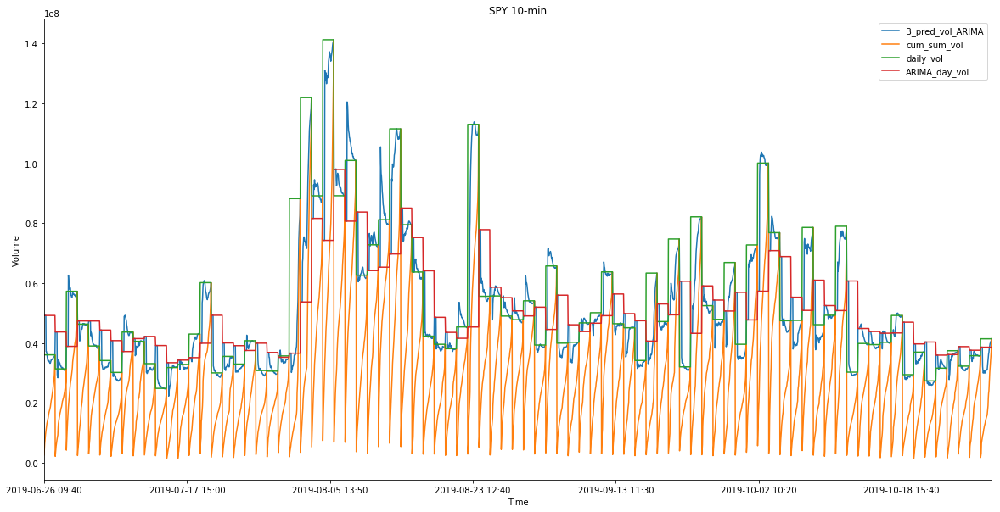

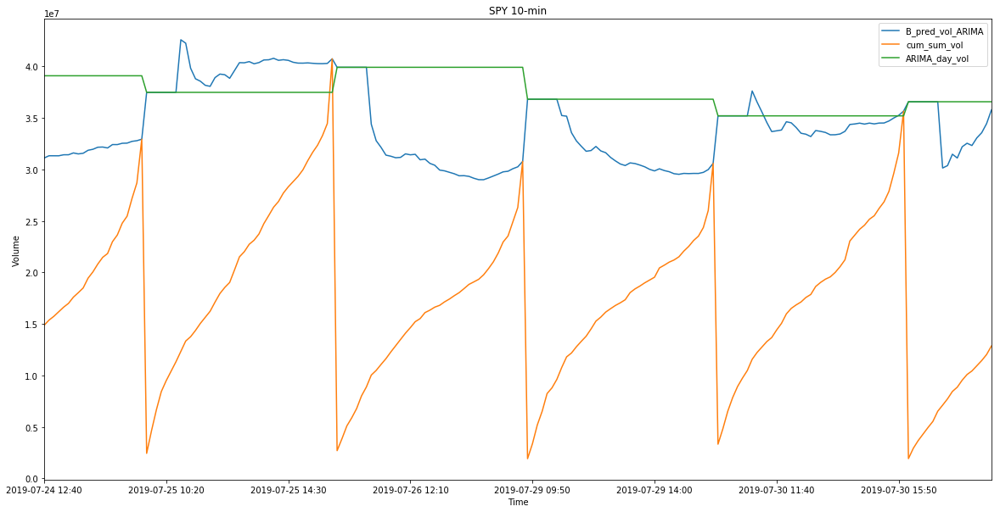

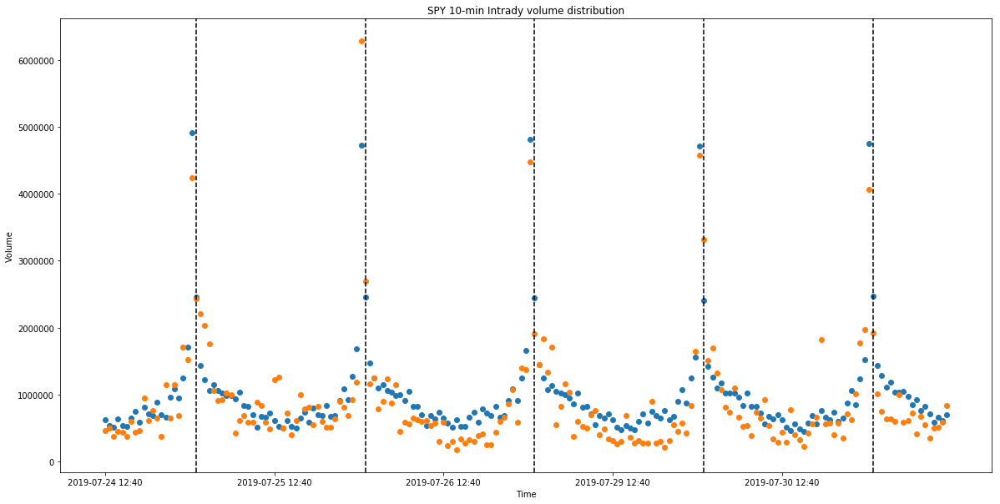

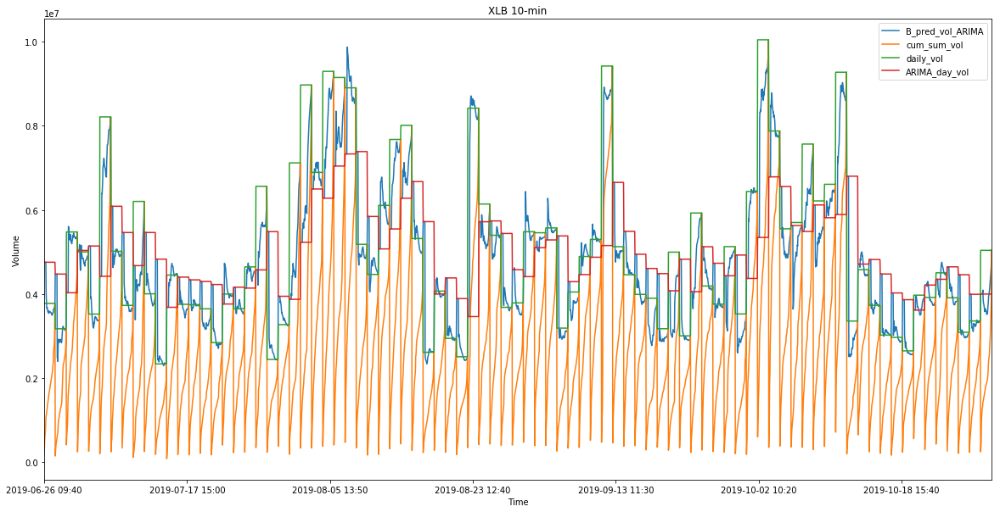

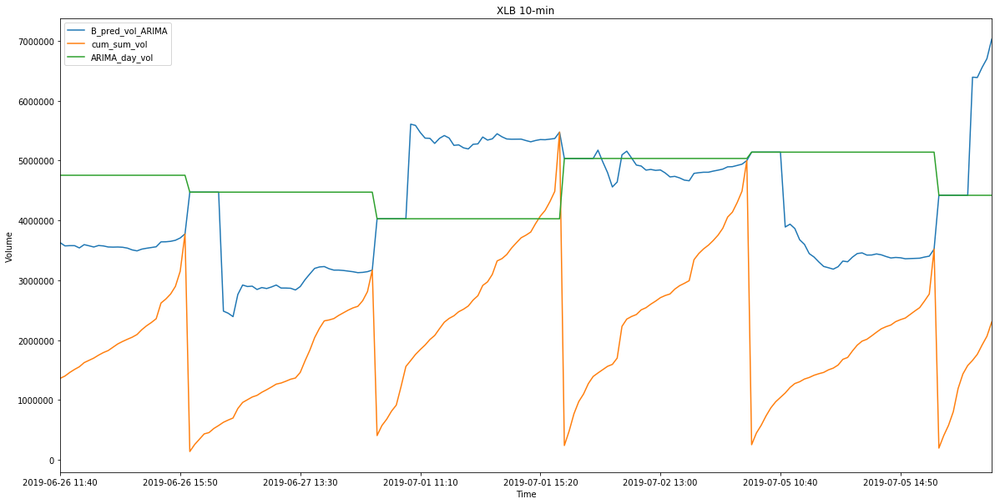

...

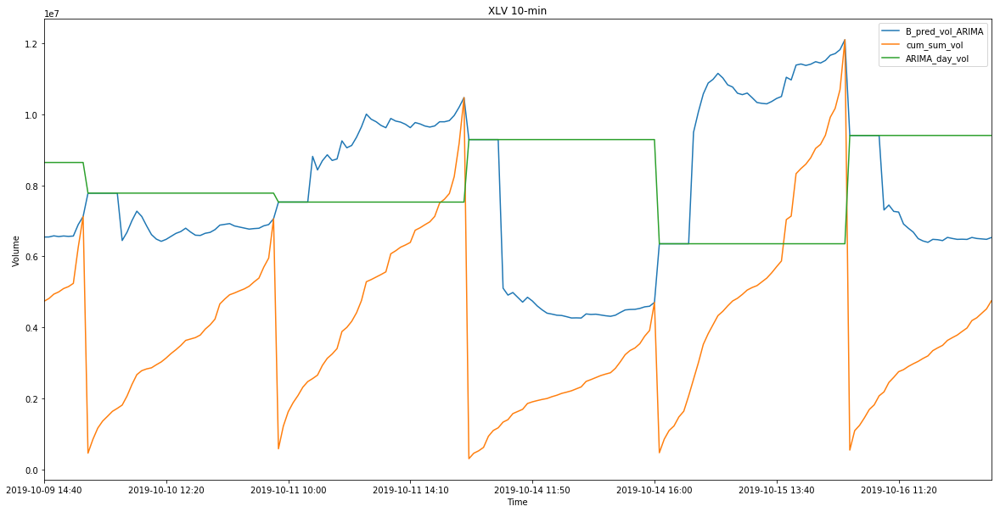

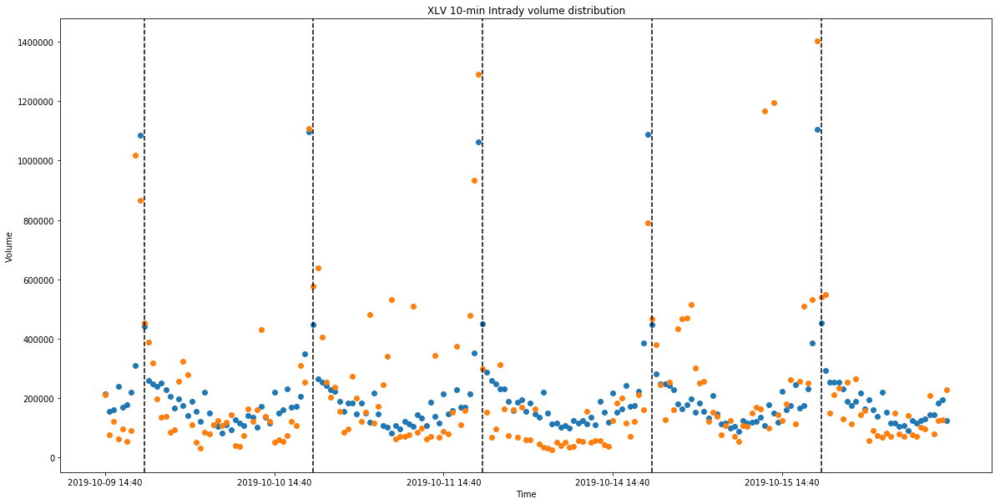

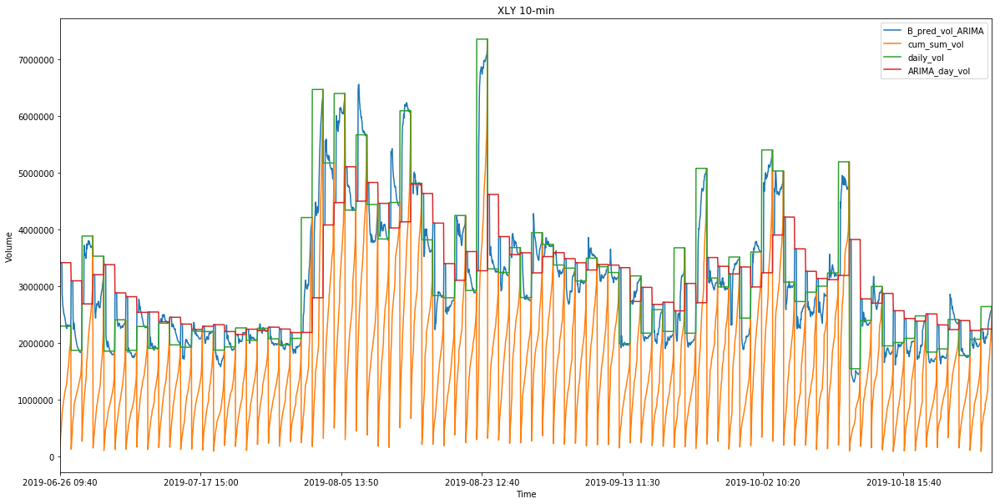

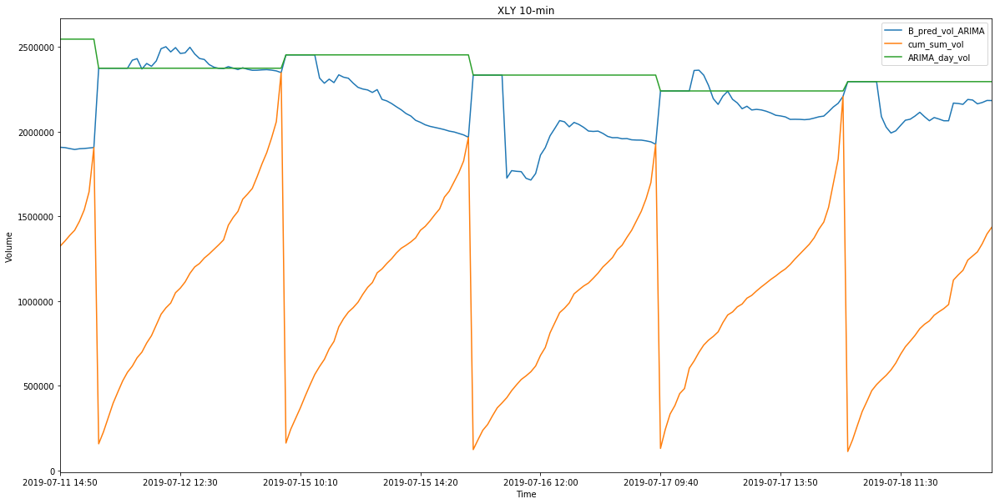

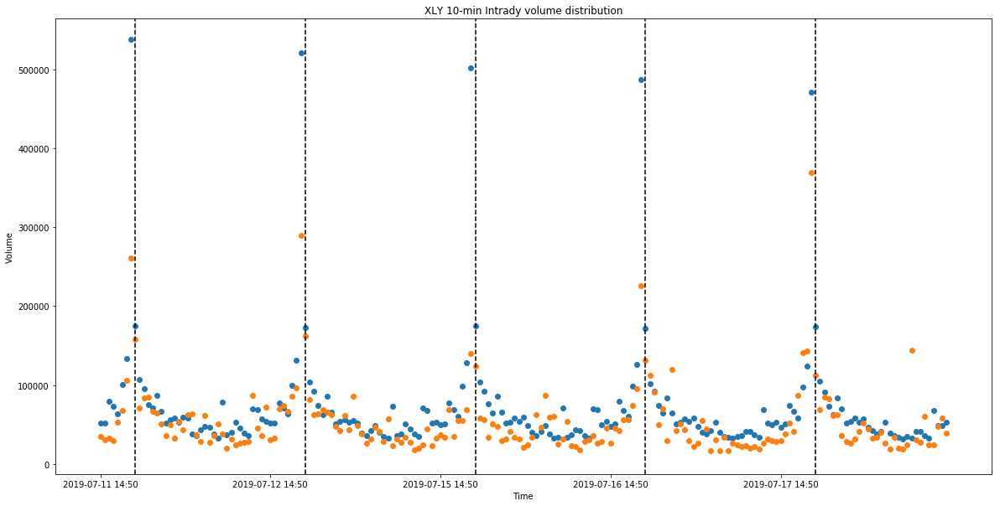

In [149]:


for sym_name in syms:
    temp = Bayesian_dict_ARIMA_10[sym_name].dropna().set_index("date_time")
    temp.index = temp.index.to_series().apply(lambda x: x.strftime('%Y-%m-%d %H:%M'))
    index = random.randrange(0,3116)
    
    ax = temp[["B_pred_vol_ARIMA","cum_sum_vol","daily_vol","ARIMA_day_vol"]].plot(figsize = (20, 10),title = sym_name+ " 10-min")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")


    rand_temp = temp.iloc[index:index+5*39]
    ax = rand_temp[["B_pred_vol_ARIMA","cum_sum_vol","ARIMA_day_vol"]].plot(figsize = (20, 10),title = sym_name+ " 10-min")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    
    fig, ax = plt.subplots(figsize=(20,10))
    ax.scatter(rand_temp.index, rand_temp["B_pred_interval_vol_ARIMA"],label= "B_pred_interval_vol_ARIMA")
    ax.scatter(rand_temp.index, rand_temp["volume"],label= "realized volume")
    xpositions = rand_temp[rand_temp.time==datetime.strptime('09:40', '%H:%M').time()].index.values
    for xc in xpositions:
        plt.axvline(x=xc, color='k', linestyle='--')
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    ax.set_xticks(rand_temp.index[::39])
    ax.set_title(sym_name + " 10-min" + " Intrady volume distribution")
    plt.show()
    
    

## 3. Kalman filter

In [150]:
def Kalman_ARIMA(df, sym):
    
    for date in all_date[20:]:
        
        mask0 = (df["date"] == date) & (df["time"] == datetime.strptime('09:40', '%H:%M').time())
        temp = df.loc[mask0,:]
        ADV = temp.ARIMA_day_vol.values
        P0 = temp.daily_vol_std.values ** 2
        x0 = ADV
             
        
        for t in all_time:
   
            mask1 = ((df["date"] == date) & (df["time"] == t))
            temp2 = df[mask1]
            y = temp2.cum_sum_vol.values
            
            if t == datetime.strptime('09:40', '%H:%M').time():
                P = P0
                x = x0
                last_pred = ADV

            u = temp2.vol_prof_mean.values
            miu = temp2.cum_vol_prof_mean.values
            R = ADV**2 * temp2.cum_vol_prof_var.values
            K = (miu * P) / (miu ** 2 * P + R)
            P = (1 - K*miu) * P
            x = x + K * (y - miu*x)
            
            df.loc[mask1, "K_pred_vol_ARIMA"] = x
            df.loc[mask1, "K_pred_interval_vol_ARIMA"] = last_pred * u
            last_pred = x
    
    return df

In [151]:
start = time.time()

Kalman_dict_ARIMA_10 = dict()

for sym_name in syms:
    
    temp = Bayesian_dict_ARIMA_10[sym_name]
    Kalman_dict_ARIMA_10[sym_name] = Kalman_ARIMA(temp,sym_name)
    
end = time.time()

print('The time cost: ')
print(end - start)

Kalman_dict_ARIMA_10

The time cost: 
288.1914358139038


{'SPY':       sym           date_time     volume        date      time   daily_vol  \
 0     SPY 2019-04-01 09:40:00  4842694.0  2019-04-01  09:40:00  56340858.0   
 1     SPY 2019-04-01 09:50:00  2019539.0  2019-04-01  09:50:00  56340858.0   
 2     SPY 2019-04-01 10:00:00  1429654.0  2019-04-01  10:00:00  56340858.0   
 3     SPY 2019-04-01 10:10:00  3075664.0  2019-04-01  10:10:00  56340858.0   
 4     SPY 2019-04-01 10:20:00  1311680.0  2019-04-01  10:20:00  56340858.0   
 ...   ...                 ...        ...         ...       ...         ...   
 5650  SPY 2019-10-30 15:20:00  1061120.0  2019-10-30  15:20:00  41379967.0   
 5651  SPY 2019-10-30 15:30:00  1763842.0  2019-10-30  15:30:00  41379967.0   
 5652  SPY 2019-10-30 15:40:00  1247371.0  2019-10-30  15:40:00  41379967.0   
 5653  SPY 2019-10-30 15:50:00  1483266.0  2019-10-30  15:50:00  41379967.0   
 5654  SPY 2019-10-30 16:00:00  4299320.0  2019-10-30  16:00:00  41379967.0   
 
       daily_vol_mean  daily_vol_std  daily

In [152]:
pickle.dump(Kalman_dict_ARIMA_10, open("Kalman_dict_ARIMA_10.p", "wb"))

In [153]:
Kalman_dict_ARIMA_10 = pickle.load(open("Kalman_dict_ARIMA_10.p", "rb"))

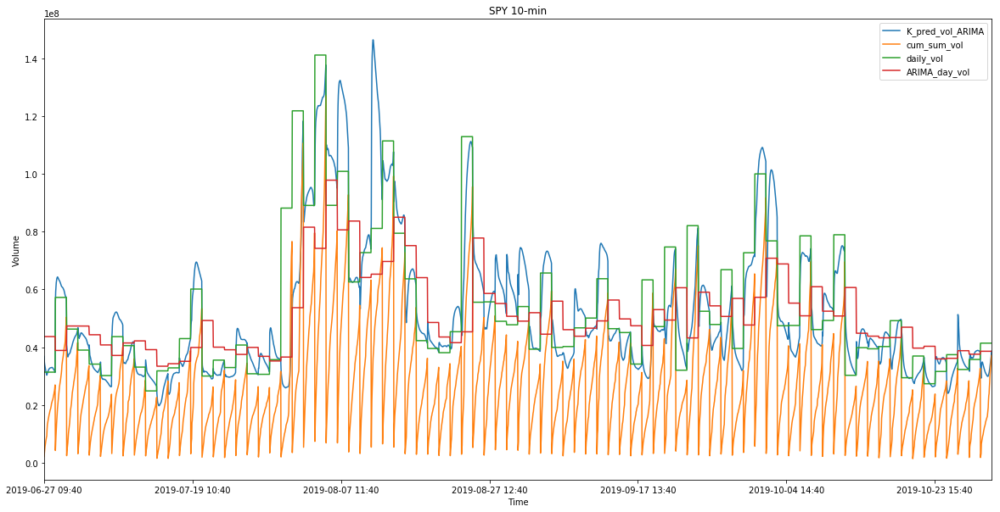

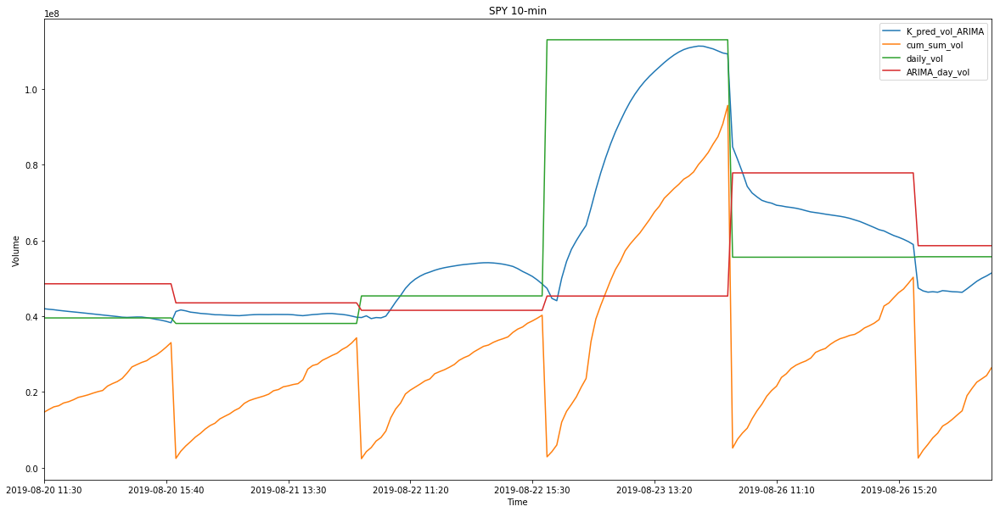

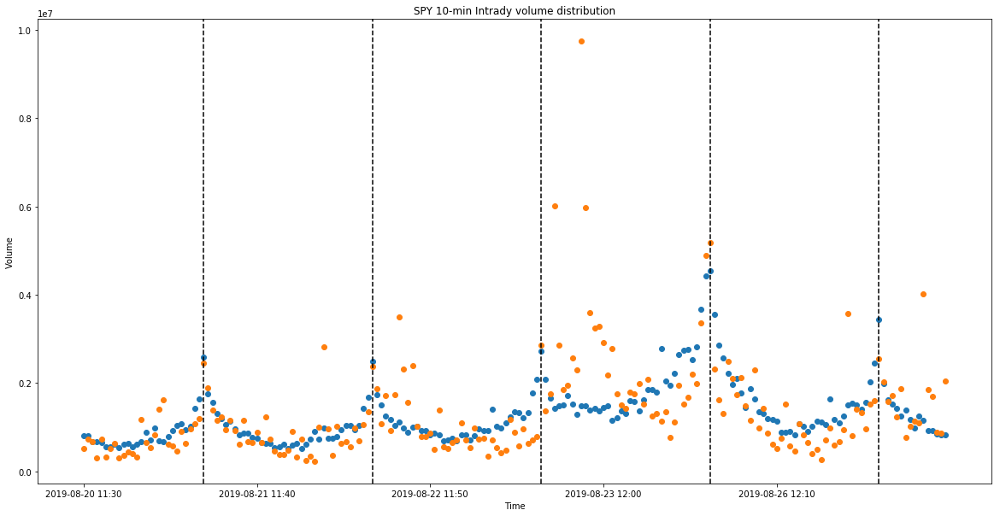

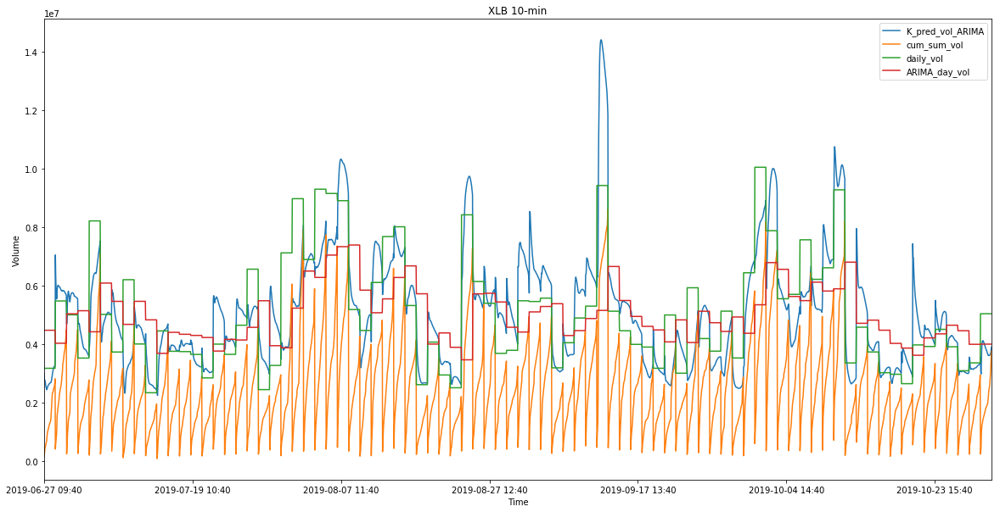

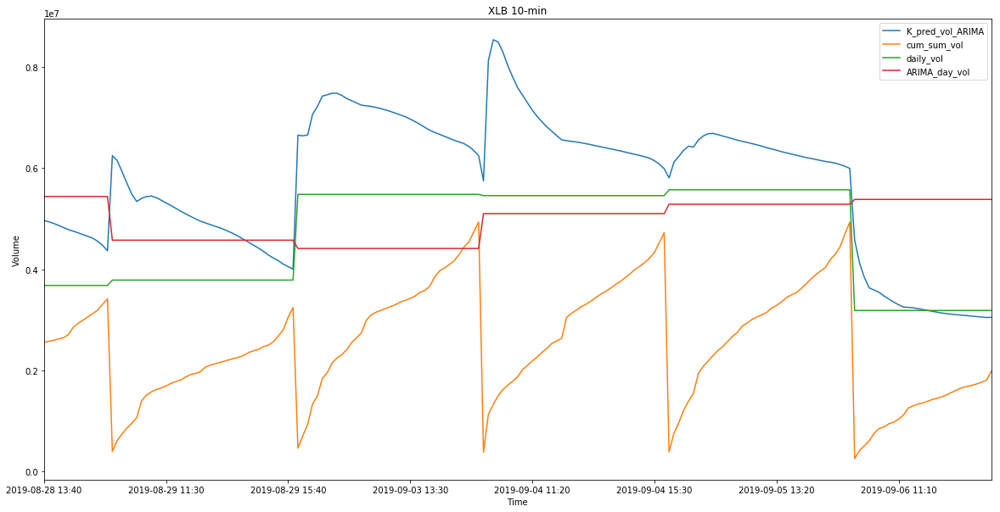

...

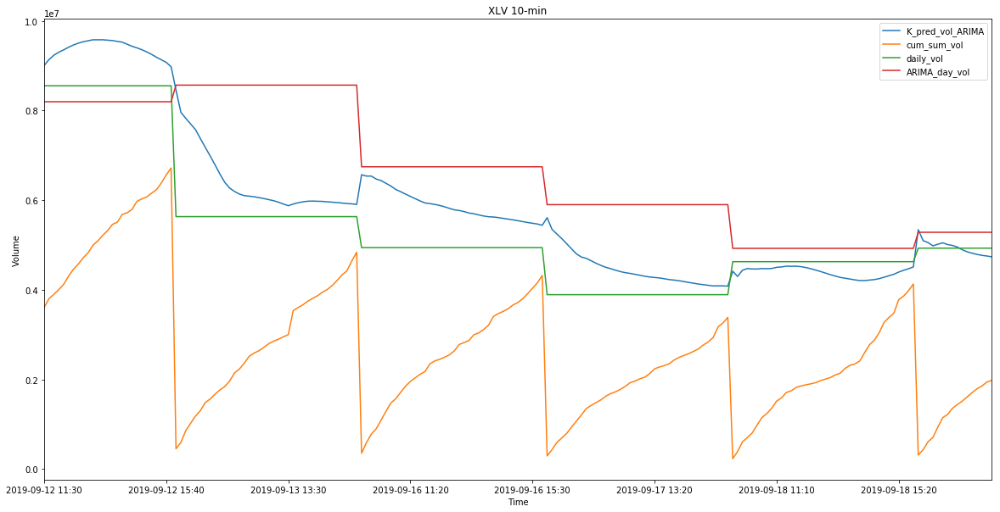

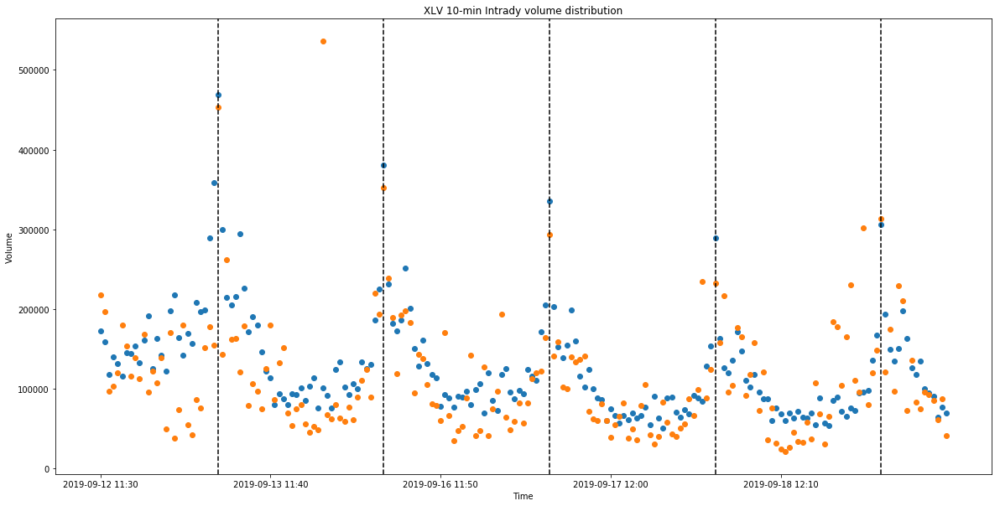

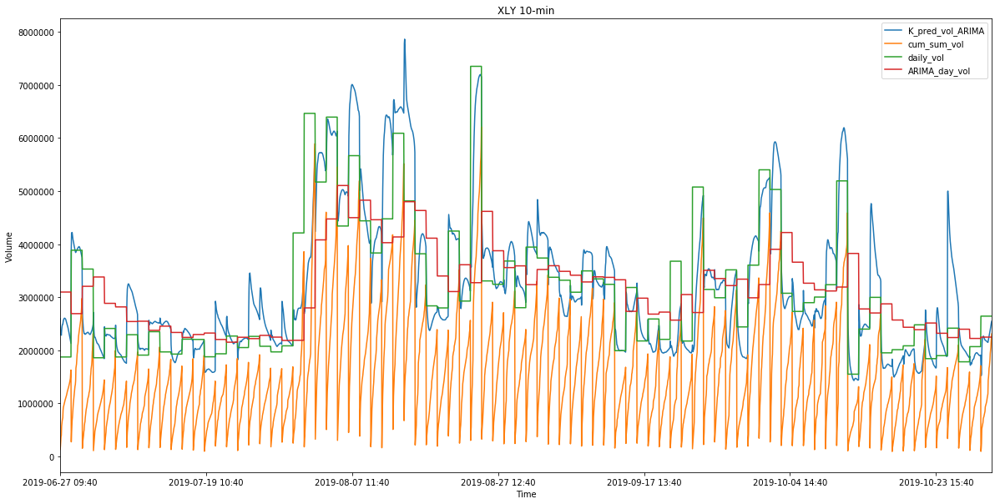

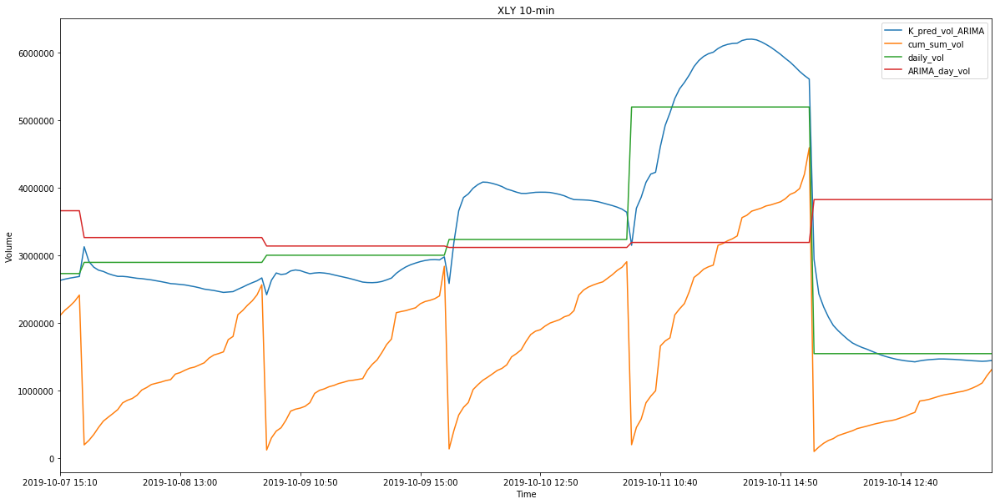

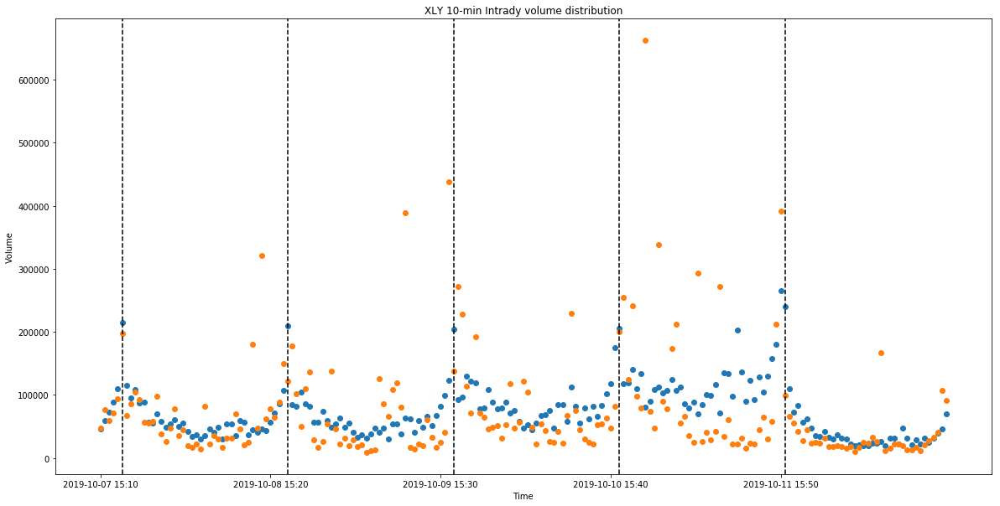

In [198]:

    
for sym_name in syms:
    temp = Kalman_dict_ARIMA_10[sym_name].dropna().set_index("date_time")
    temp.index = temp.index.to_series().apply(lambda x: x.strftime('%Y-%m-%d %H:%M'))
    index = random.randrange(0,len(temp)-5*39)
    ax = temp[["K_pred_vol_ARIMA","cum_sum_vol","daily_vol","ARIMA_day_vol"]].plot(figsize = (20, 10),title = sym_name+ " 10-min")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    
    rand_temp = temp.iloc[index:index+5*39]
    ax = rand_temp[["K_pred_vol_ARIMA","cum_sum_vol","daily_vol","ARIMA_day_vol"]].plot(figsize = (20, 10),title = sym_name+ " 10-min")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    
    fig, ax = plt.subplots(figsize=(20,10))
    ax.scatter(rand_temp.index, rand_temp["K_pred_interval_vol_ARIMA"],label= "K_pred_interval_vol_ARIMA")
    ax.scatter(rand_temp.index, rand_temp["volume"],label= "realized volume")
    xpositions = rand_temp[rand_temp.time==datetime.strptime('09:40', '%H:%M').time()].index.values
    for xc in xpositions:
        plt.axvline(x=xc, color='k', linestyle='--')
    ax.set_xticks(rand_temp.index[::39])
    ax.set_title(sym_name + " 10-min"+ " Intrady volume distribution")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    plt.show()
    
    

## Analyse how instable intraday volume distribution influence different models

In [192]:
xposition = Kalman_dict_10["SPY"][Kalman_dict_10["SPY"].time==datetime.strptime('09:40', '%H:%M').time()].loc[3200:3600].index

In [187]:
Kalman_dict_10_adj["SPY"].columns

Index(['sym', 'date_time', 'volume', 'date', 'time', 'daily_vol',
       'daily_vol_mean', 'daily_vol_std', 'daily_vol_log_mean', 'cum_sum_vol',
       'cum_vol_prof', 'vol_prof', 'cum_vol_prof_var', 'vol_prof_mean',
       'cum_vol_prof_mean', 'time_diff', 'Deter_Blend',
       'Deter_Blend_interval_vol', 'B_pred_vol', 'B_pred_interval_vol',
       'K_pred_vol', 'K_pred_interval_vol', 'residual', 'std_multiplier',
       'K_adj_pred_vol', 'K_adj_pred_interval_vol'],
      dtype='object')

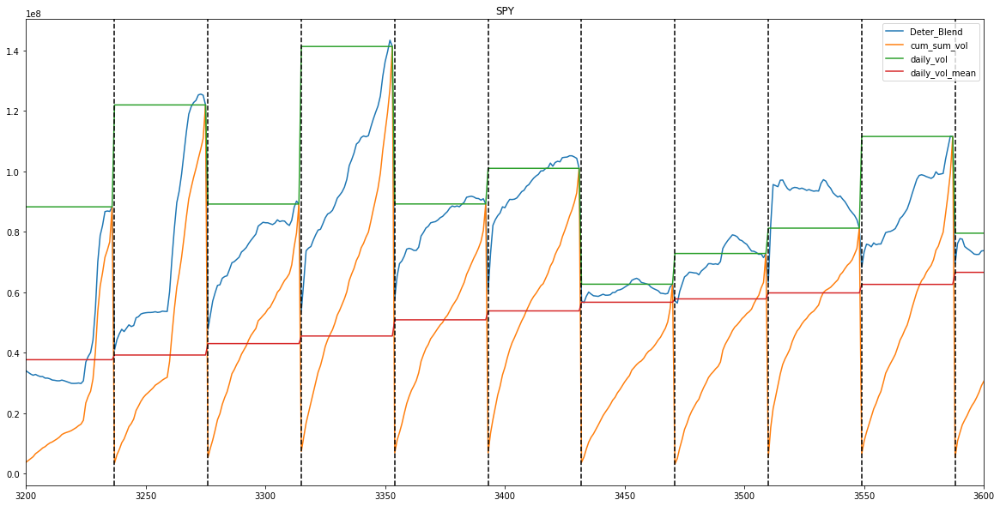

In [193]:
Kalman_dict_10_adj["SPY"][["Deter_Blend","cum_sum_vol","daily_vol","daily_vol_mean"]].loc[3200:3600].plot(figsize = (20, 10),title = "SPY")
for xc in xposition:
    plt.axvline(x=xc, color='k', linestyle='--')

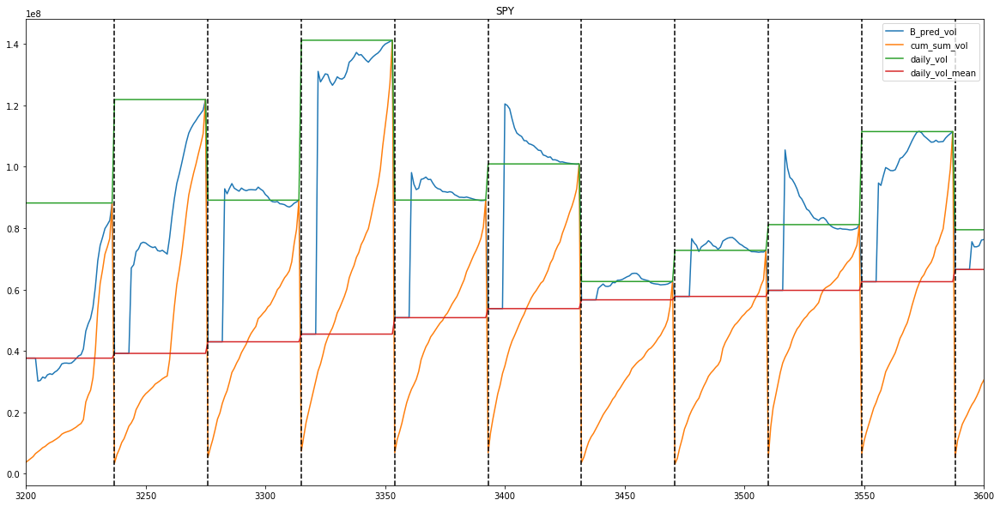

In [194]:
Kalman_dict_10_adj["SPY"][["B_pred_vol","cum_sum_vol","daily_vol","daily_vol_mean"]].loc[3200:3600].plot(figsize = (20, 10),title = "SPY")
for xc in xposition:
    plt.axvline(x=xc, color='k', linestyle='--')

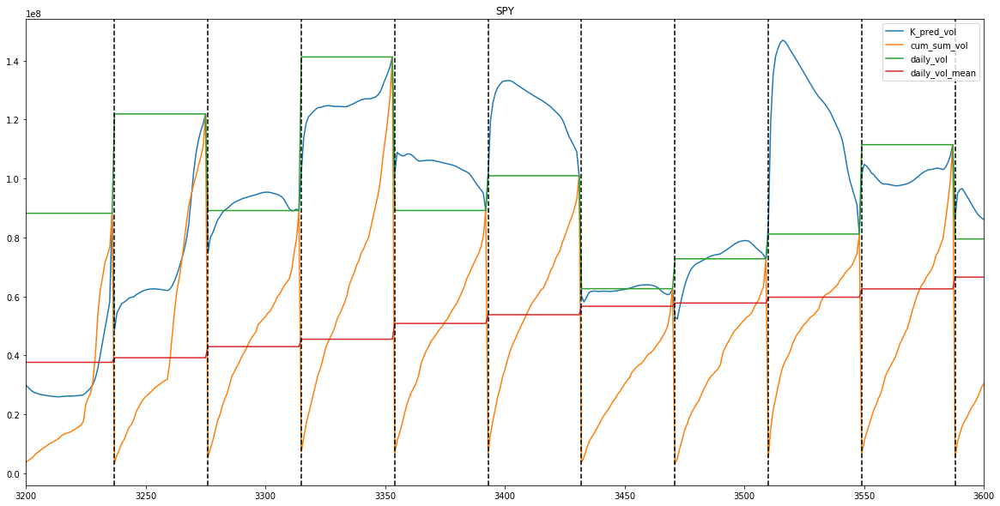

In [195]:
Kalman_dict_10_adj["SPY"][["K_pred_vol","cum_sum_vol","daily_vol","daily_vol_mean"]].loc[3200:3600].plot(figsize = (20, 10),title = "SPY")
for xc in xposition:
    plt.axvline(x=xc, color='k', linestyle='--')

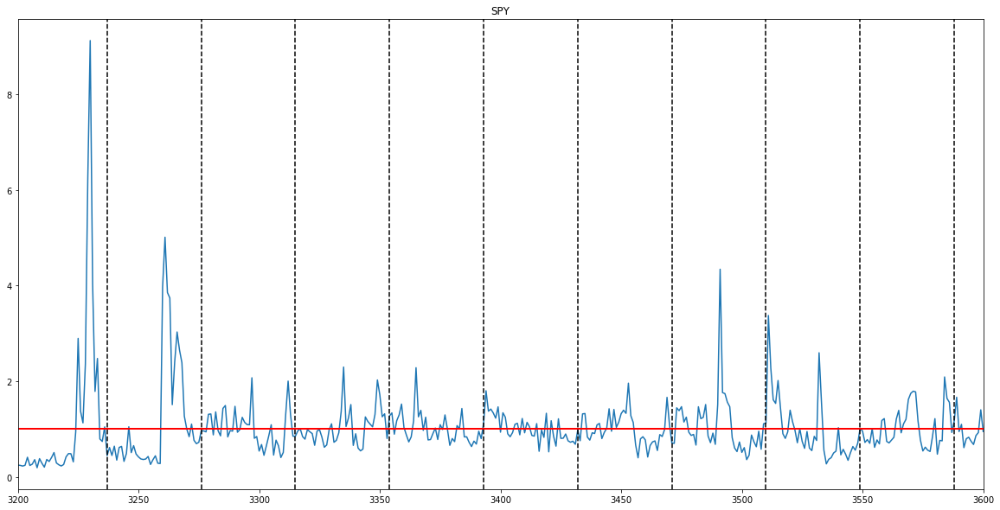

In [196]:
(Kalman_dict_10_adj["SPY"]["vol_prof"]/Kalman_dict_10_adj["SPY"]["vol_prof_mean"]).dropna().loc[3200:3600].plot(figsize = (20, 10),title = "SPY")
for xc in xposition:
    plt.axvline(x=xc, color='k', linestyle='--')
    plt.axhline(y=1, color='r', linestyle='-')

## Model performance

In [155]:
models = ["Deterministic_Blend_ARIMA", "Log_Bayesian_ARIMA", "Kalman_Filter_ARIMA"]
results = ["Deter_Blend_ARIMA","B_pred_vol_ARIMA","K_pred_vol_ARIMA"]

All_performace_Result_ARIMA_10 = Errors(Kalman_dict_ARIMA_10)
All_performace_Result_ARIMA_10 
All_performace_Result_ARIMA_10.to_csv("All_performace_Result_ARIMA_10.csv")

In [156]:
All_performace_Result_ARIMA_10

,sym,model,MAE,MAPE,MASE
0,SPY,Deterministic_Blend_ARIMA,7.120812e+06,0.122803,0.744999
1,SPY,Log_Bayesian_ARIMA,5.386236e+06,0.091917,0.559325
2,SPY,Kalman_Filter_ARIMA,8.288980e+06,0.140288,0.951250
3,XLB,Deterministic_Blend_ARIMA,7.630725e+05,0.157353,1.137447
4,XLB,Log_Bayesian_ARIMA,5.698568e+05,0.110440,0.893555
5,XLB,Kalman_Filter_ARIMA,8.925466e+05,0.171899,1.448475
6,XLC,Deterministic_Blend_ARIMA,4.758459e+05,0.204491,0.826532
7,XLC,Log_Bayesian_ARIMA,4.024871e+05,0.159144,0.690659
8,XLC,Kalman_Filter_ARIMA,5.643714e+05,0.230260,1.046282
9,XLE,Deterministic_Blend_ARIMA,1.738293e+06,0.123225,0.742018


In [157]:
model_result = All_performace_Result_ARIMA_10.groupby("model").mean()
model_result

,MAE,MAPE,MASE
model,,,
Deterministic_Blend_ARIMA,2.022267e+06,0.137448,1.302605
Kalman_Filter_ARIMA,2.514605e+06,0.162427,1.855034
Log_Bayesian_ARIMA,1.589350e+06,0.104248,0.828841


# Visualize U shape (stable)

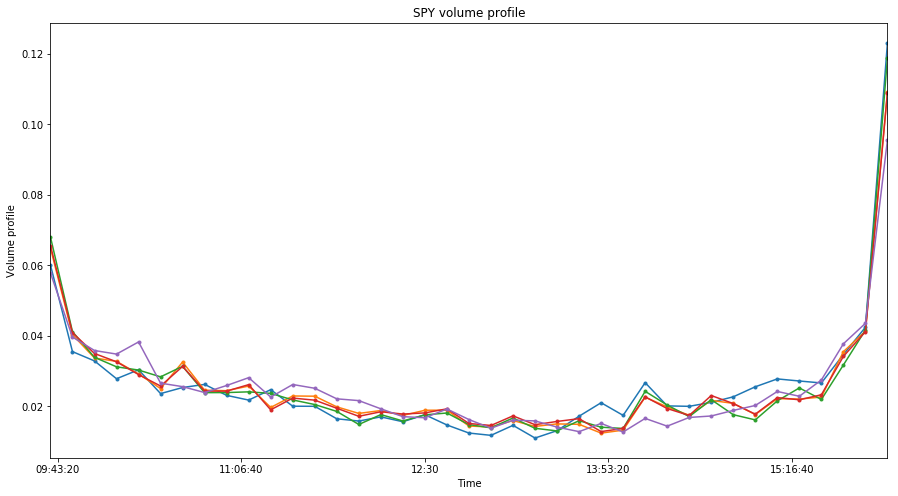

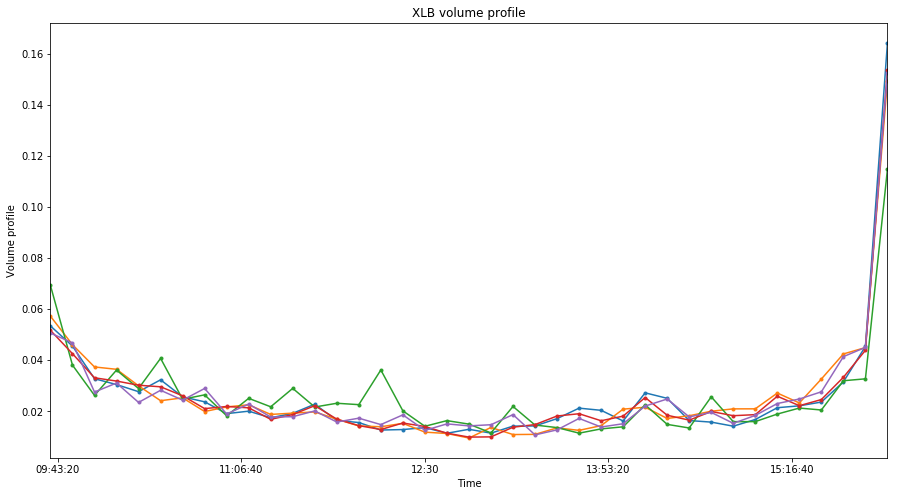

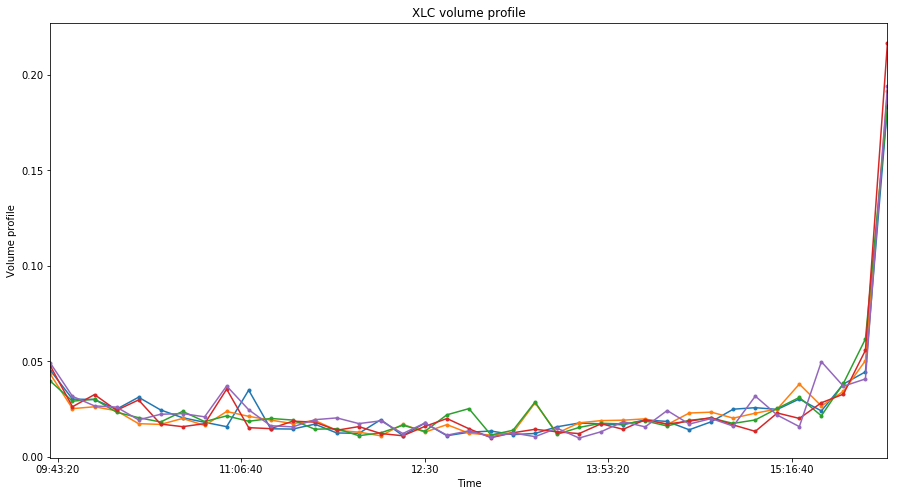

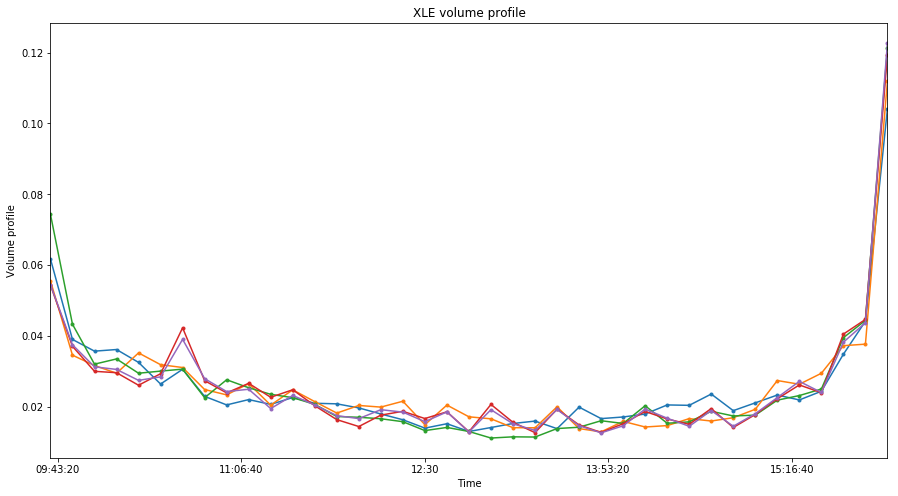

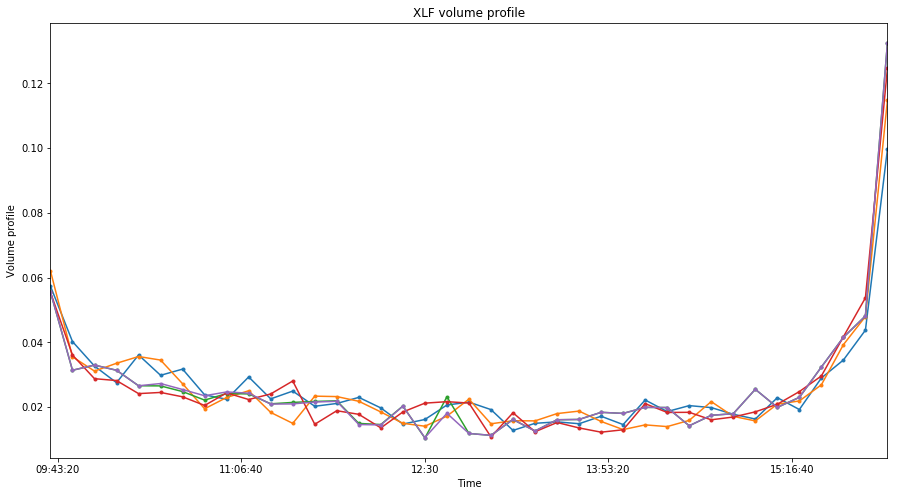

...

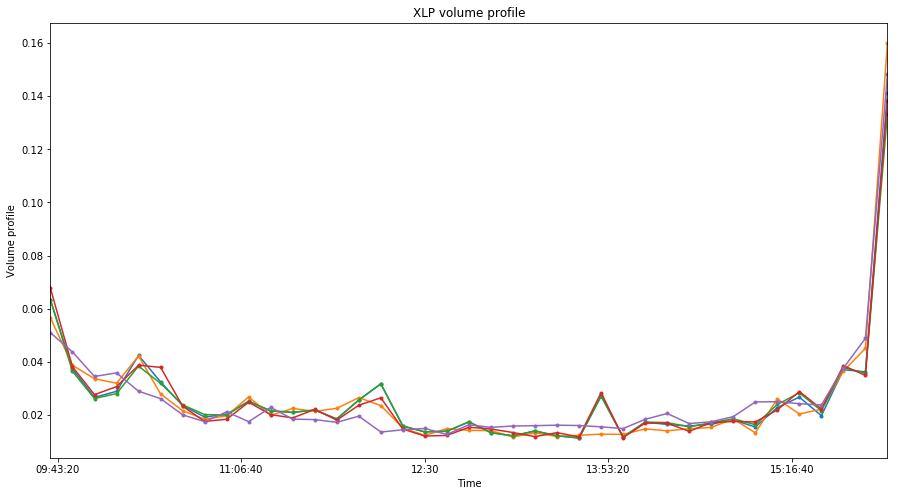

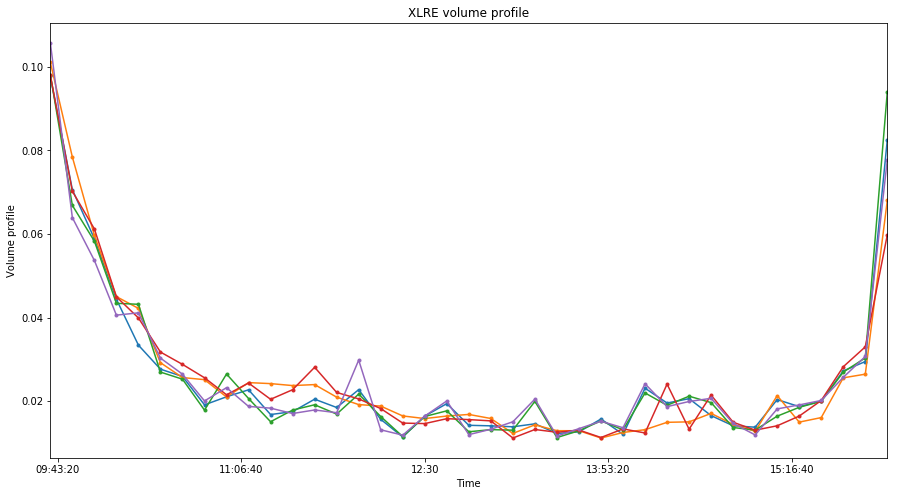

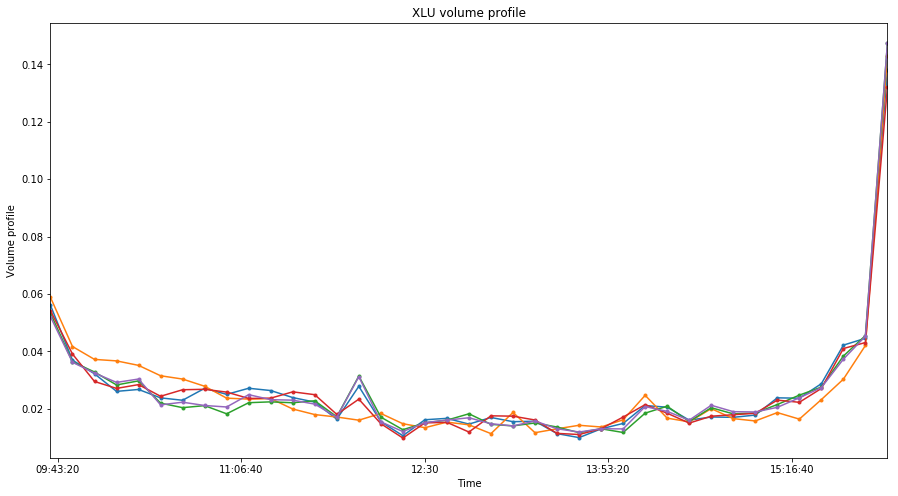

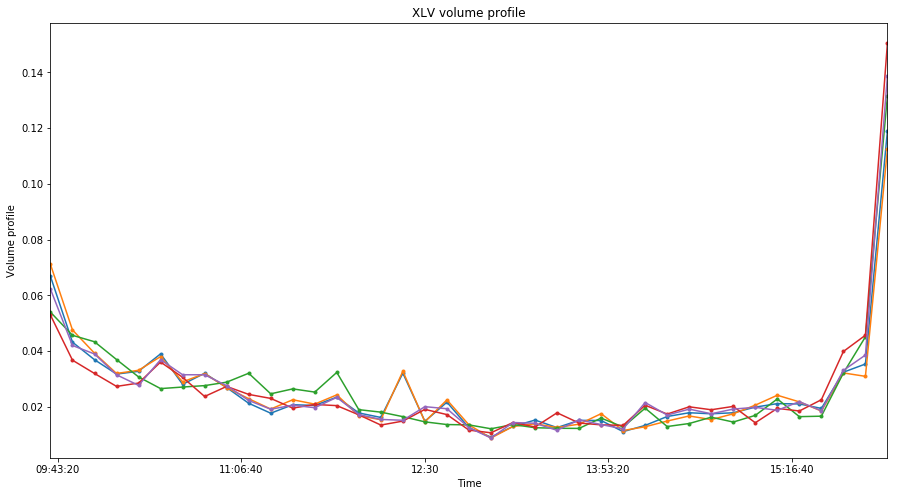

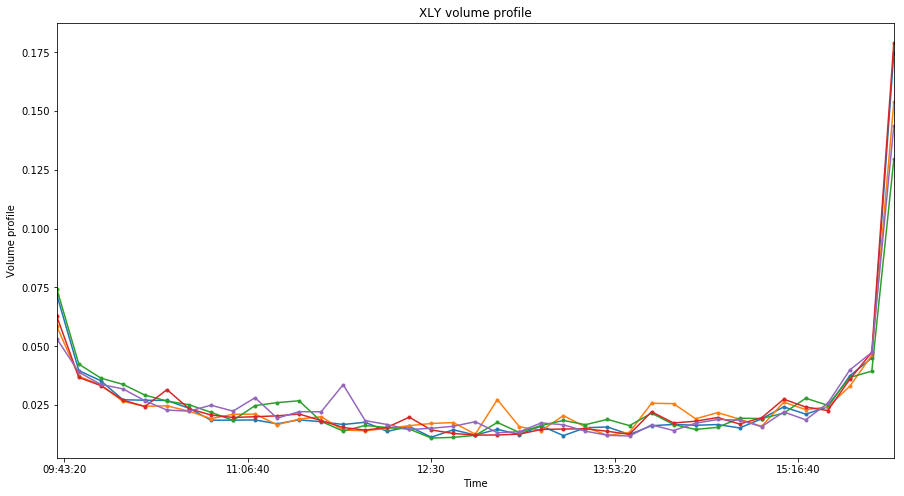

In [95]:
for sym_name in syms:
    temp = Kalman_dict_10[sym_name]
    fig = plt.figure(num=None, figsize = (15, 8))
    for i in range(5):
        index = random.randrange(0,3120)
        U = temp.iloc[index:index + 20*39].groupby("time").mean()
        ax = U["vol_prof"].plot(style='.-',title = sym_name + " volume profile")
        ax.set_xlabel("Time")
        ax.set_ylabel("Volume profile")
    


# Test Lognormal Bayesian Assumption

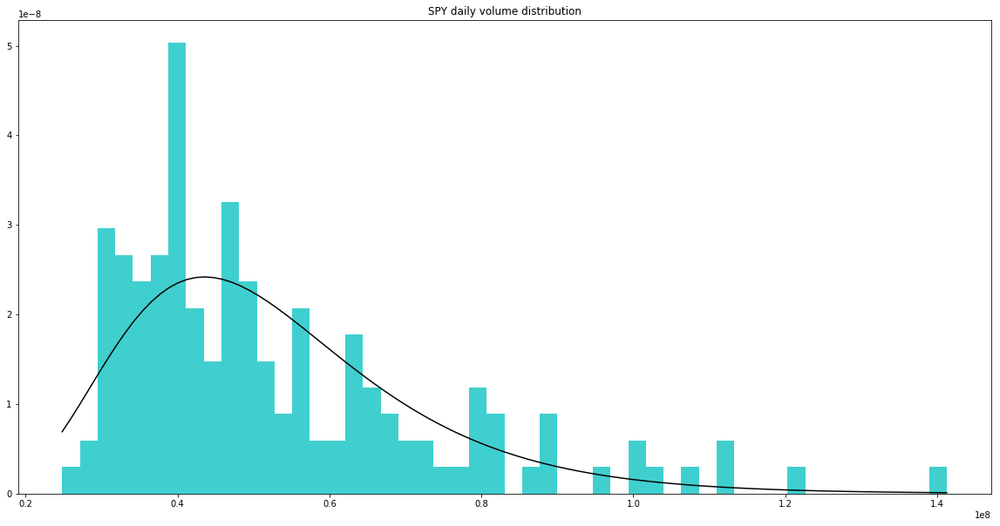

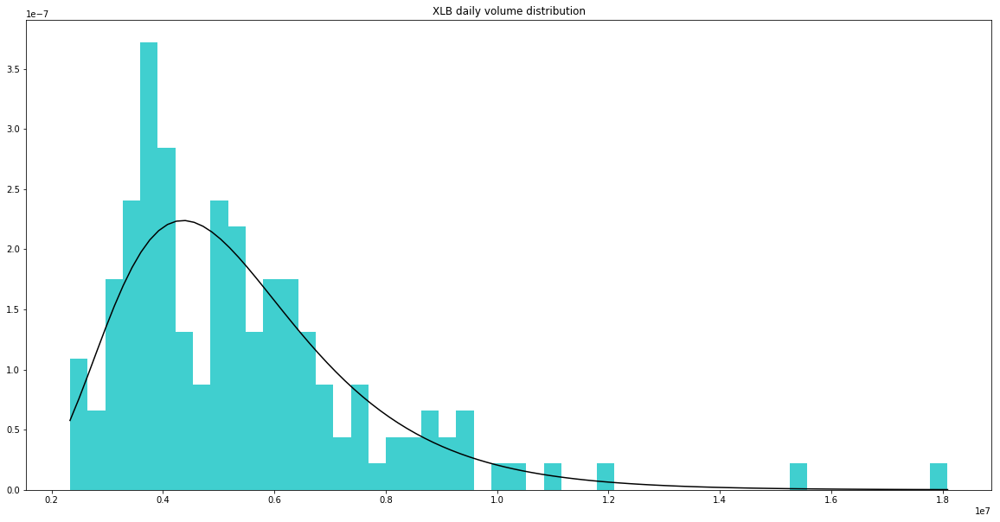

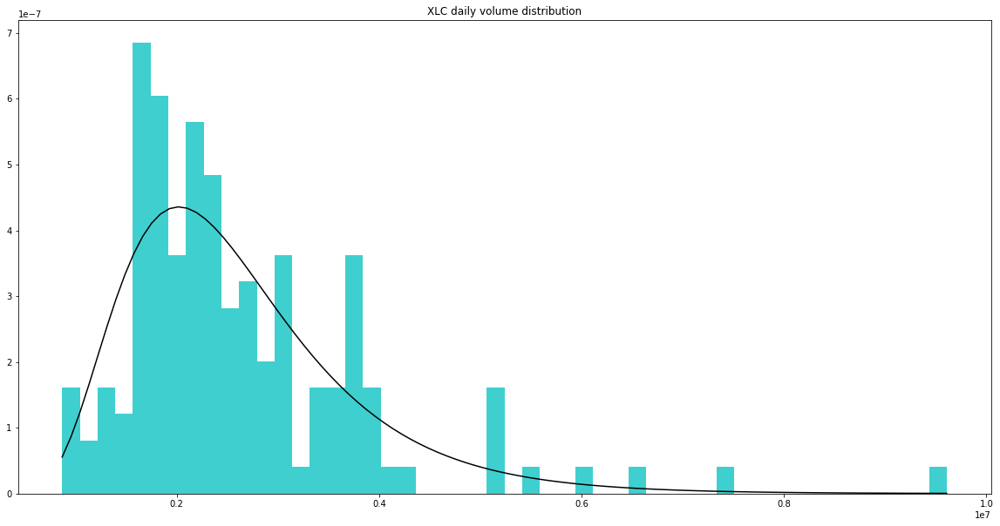

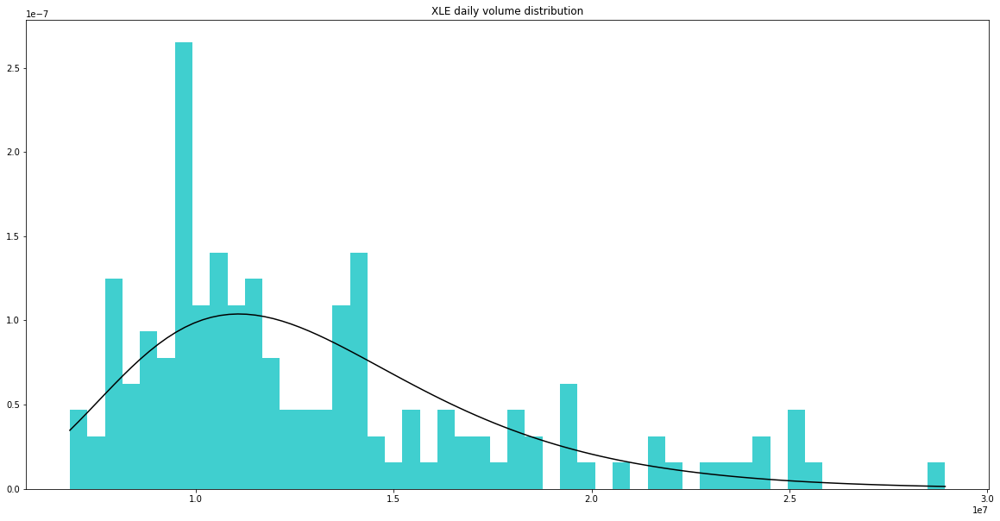

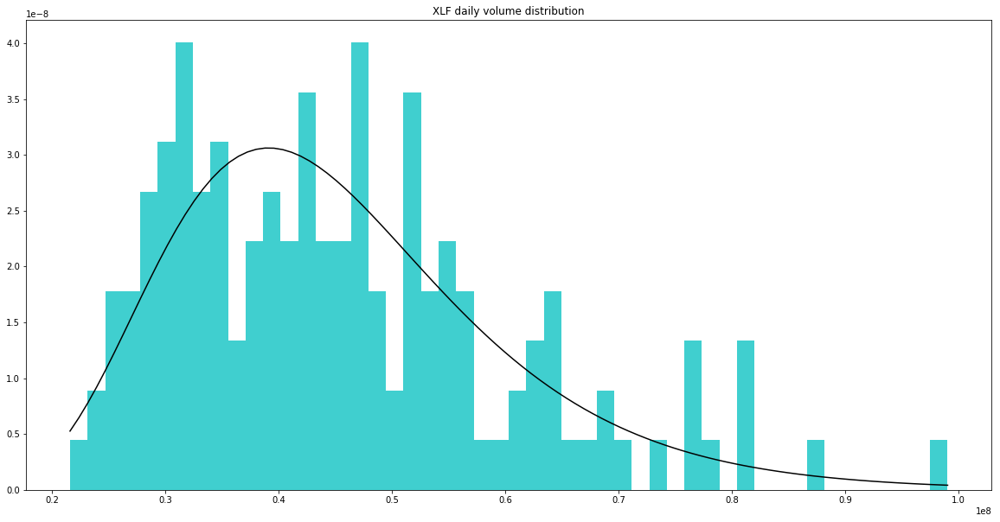

...

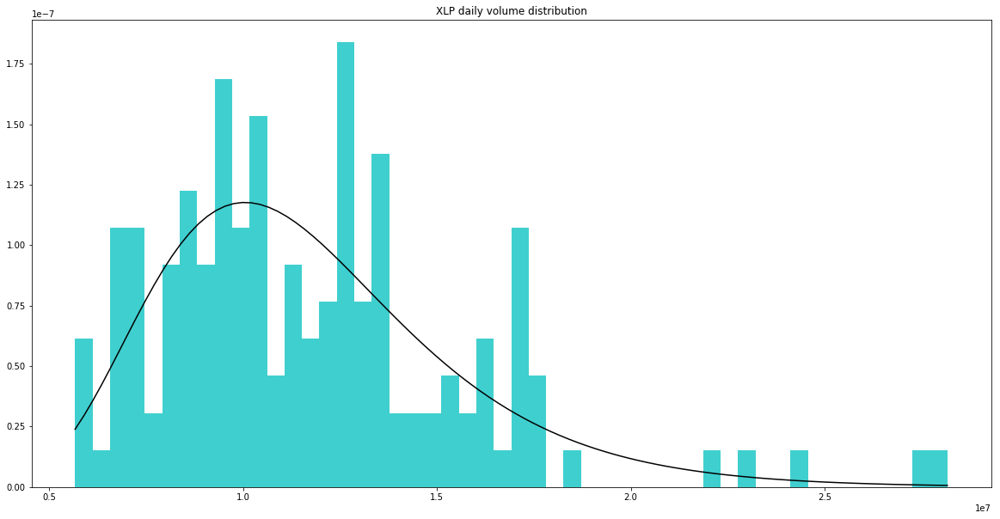

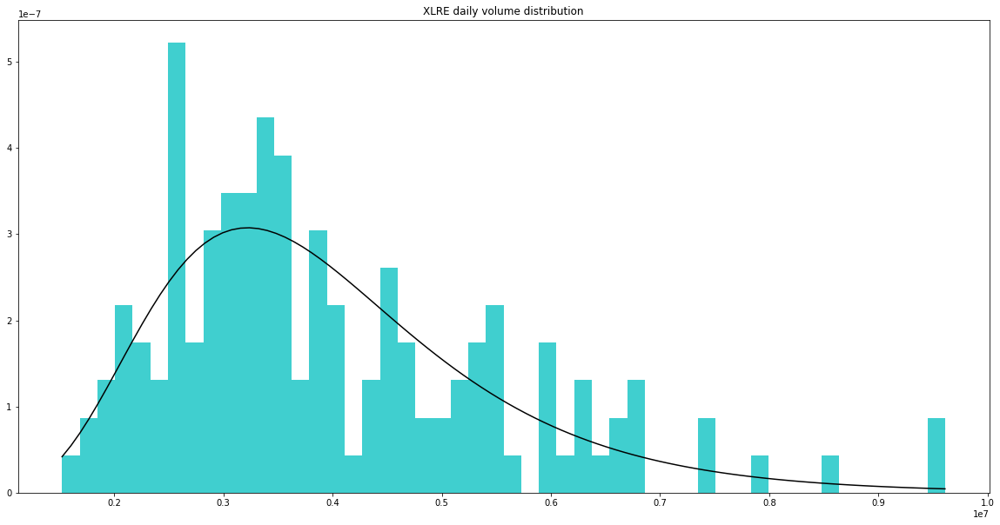

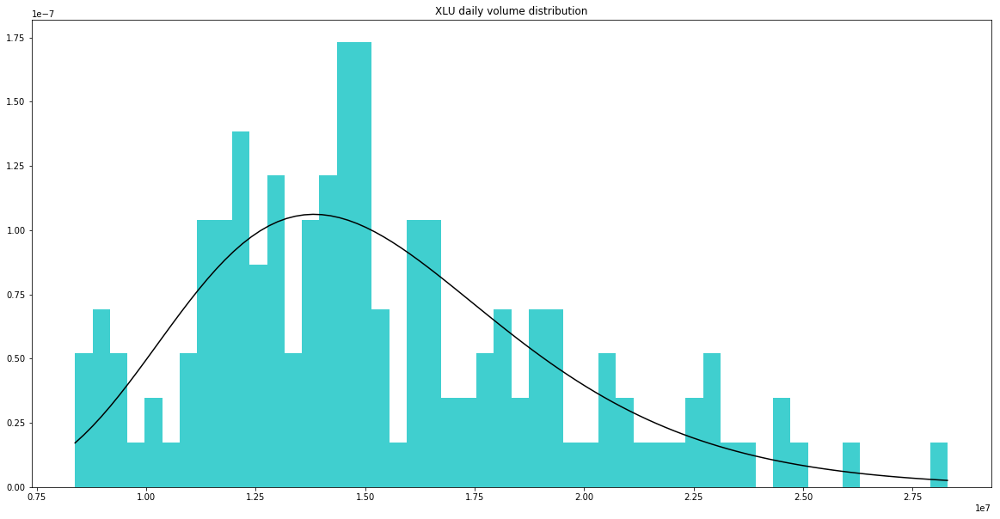

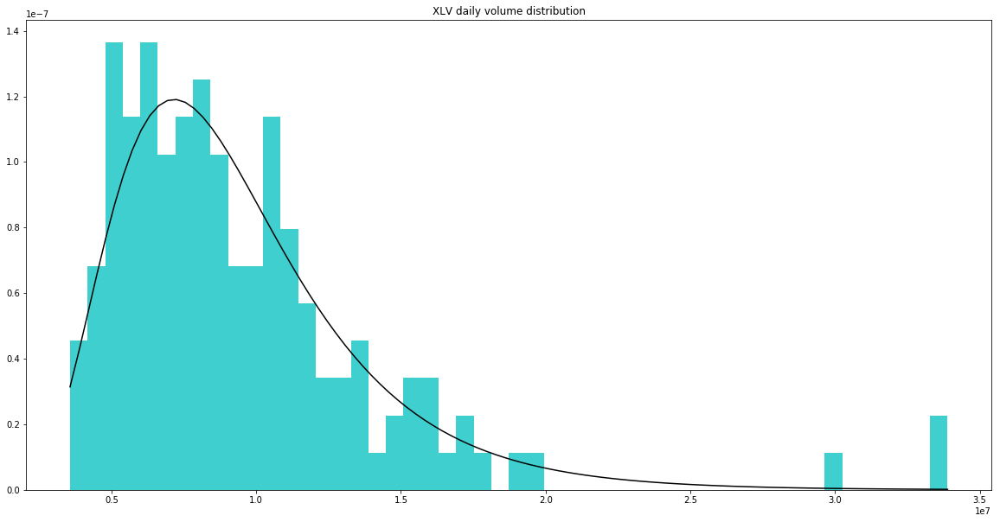

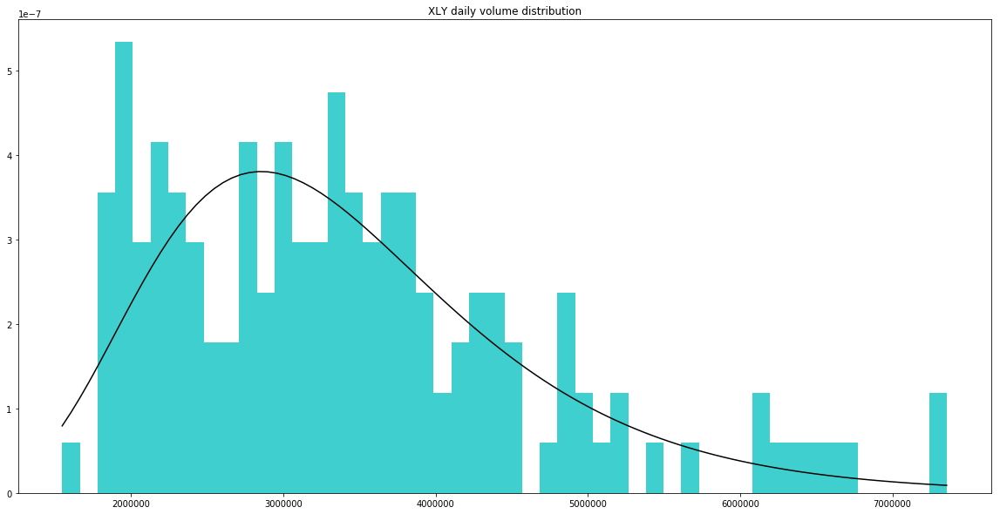

In [98]:
import scipy.stats as stats


for sym_name in syms:
    temp = daily_Stats_10[sym_name].daily_vol
    s, loc, scale = stats.lognorm.fit(temp, floc=0)
    estimated_mu = np.log(scale)
    estimated_sigma = s
    fig = plt.figure(num=None, figsize = (20, 10))
    plt.hist(temp, bins=50, normed=True, color='c', alpha=0.75)
    plt.title(sym_name+ " daily volume distribution")
    xmin = temp.min()
    xmax = temp.max()
    x = np.linspace(xmin, xmax, 100)
    pdf = stats.lognorm.pdf(x, s, scale=scale)
    plt.plot(x, pdf, 'k')

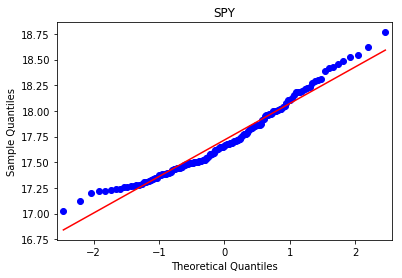

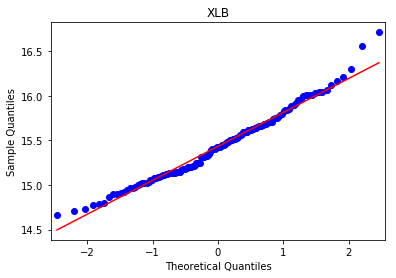

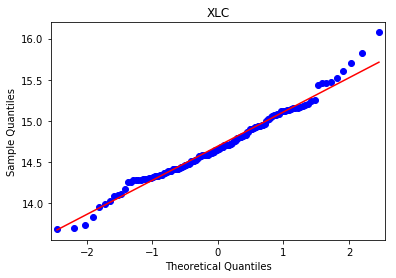

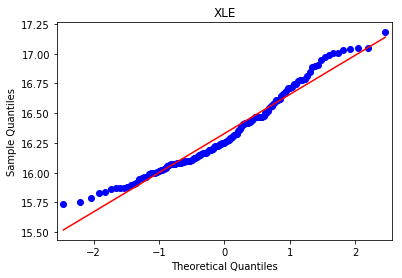

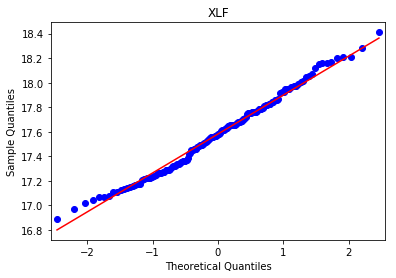

...

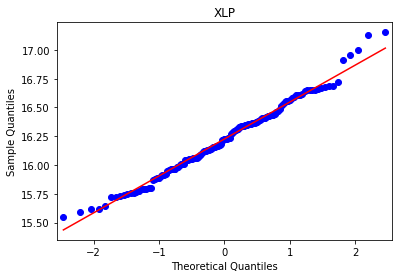

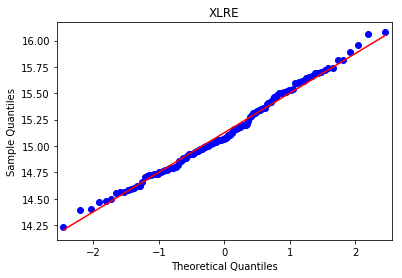

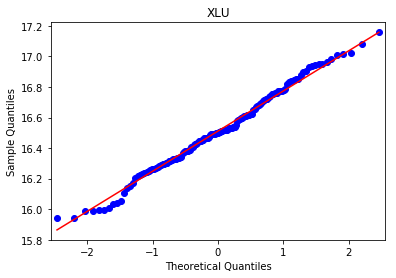

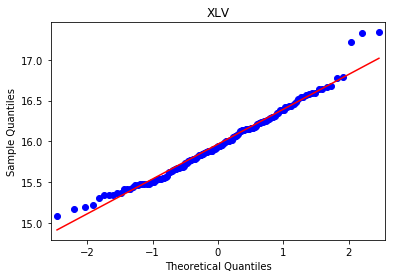

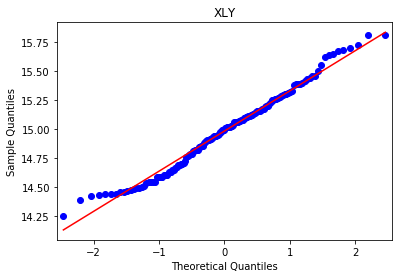

In [99]:
import statsmodels.api as sm
import pylab

for sym_name in syms:
    temp =  np.log(daily_Stats_10[sym_name].daily_vol)
    sm.qqplot(temp, line ='s')
    plt.title(sym_name)
    pylab.show()

# Test Kalman filter assumption 
# & 
# Adjusted Kalman filter

- Analyse observation noise error distribution & calculate std

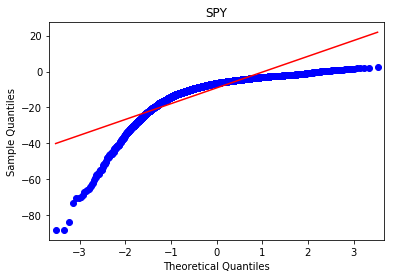

std =  8.79


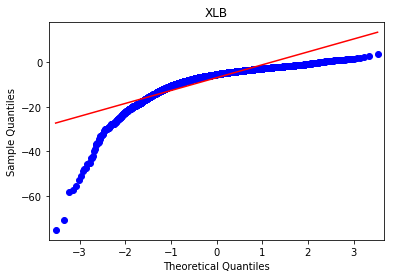

std =  5.79


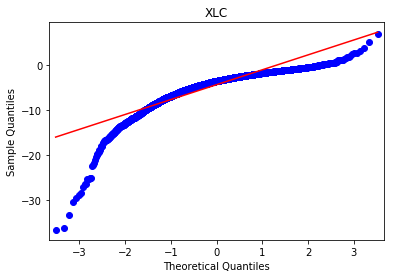

std =  3.32


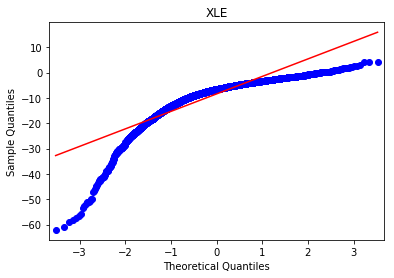

std =  6.90


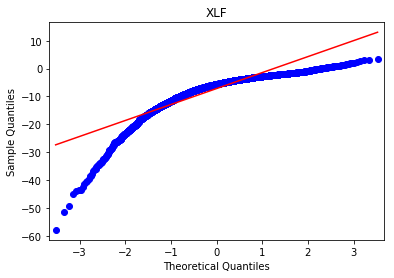

std =  5.73


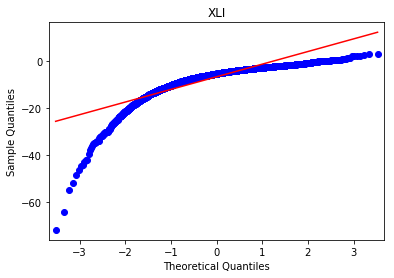

std =  5.38


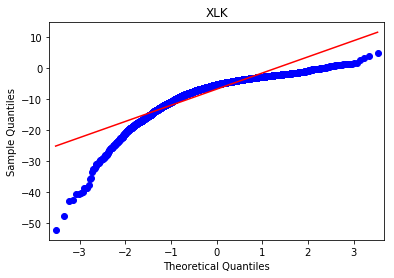

std =  5.22


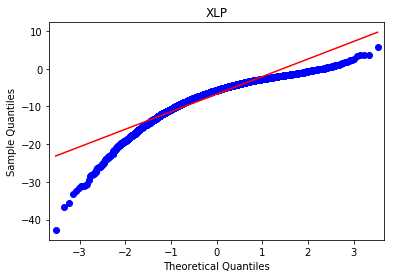

std =  4.66


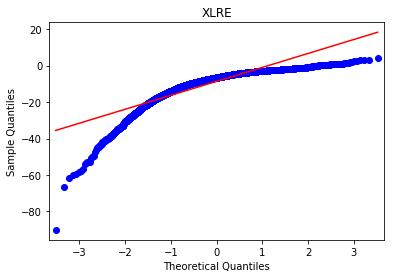

std =  7.65


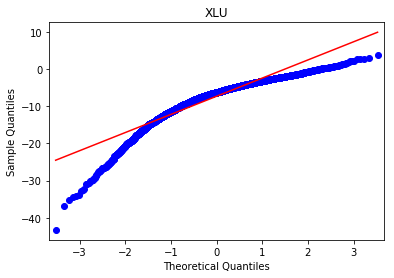

std =  4.88


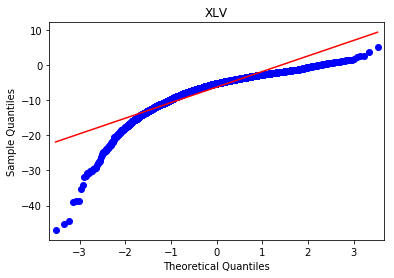

std =  4.43


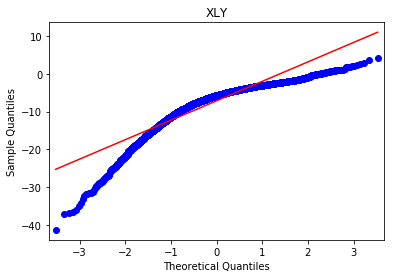

std =  5.13


In [199]:
df_clean_10["residual"] = (df_clean_10["volume"] - df_clean_10["daily_vol"]*df_clean_10["cum_vol_prof_mean"])/(df_clean_10["daily_vol_mean"]*np.sqrt(df_clean_10["cum_vol_prof_var"]))
df_clean_10["residual"] = df_clean_10["residual"].replace([np.inf, -np.inf], np.nan)

for sym_name in syms:
    temp = df_clean_10[(df_clean_10.sym == sym_name)].residual.dropna()
    
    sm.qqplot(temp, line ='s')
   
    plt.title(sym_name)
    pylab.show()
    print("std = ",  ("%.2f" % np.std(temp)))

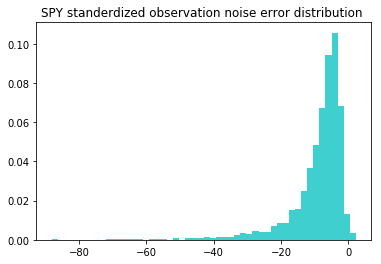

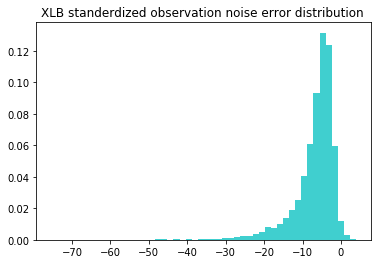

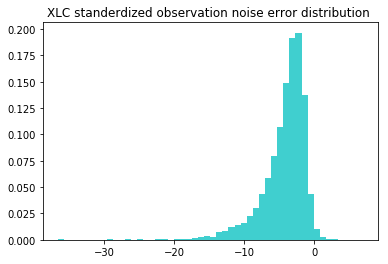

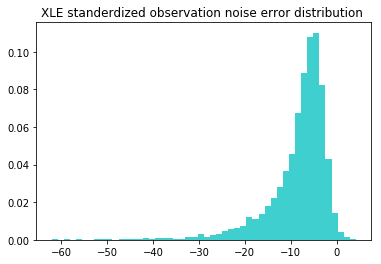

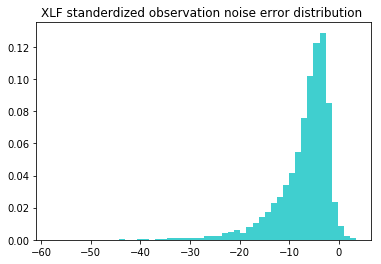

...

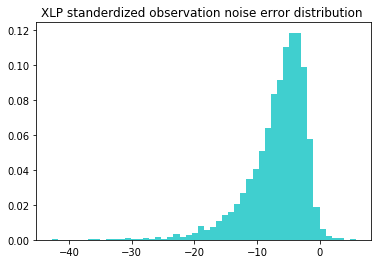

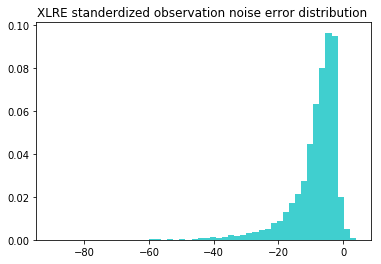

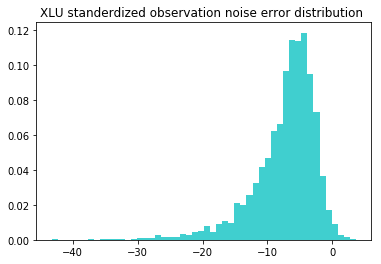

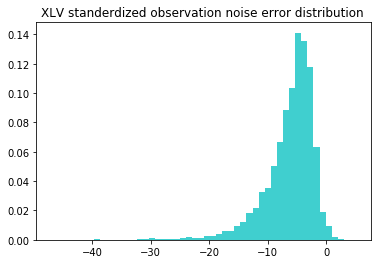

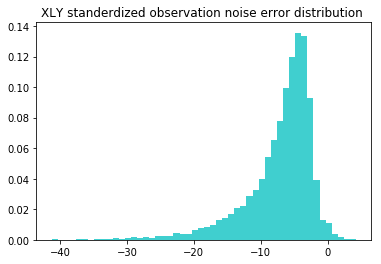

In [160]:

for sym_name in syms:
    temp = df_clean_10[(df_clean_10.sym == sym_name)].residual.dropna()
    plt.hist(temp, bins=50, normed=True, color='c', alpha=0.75)
    plt.title(sym_name + " standerdized observation noise error distribution ")
    plt.show()

## Calculate multiplier

In [161]:
Kalman_dict_10_std_adjust = dict()

for sym_name in syms:
    temp = Kalman_dict_10[sym_name]
    temp["residual"] = (temp["volume"] - temp["daily_vol"]*temp["cum_vol_prof_mean"])/(temp["daily_vol_mean"]*np.sqrt(temp["cum_vol_prof_var"]))
    temp["residual"] = temp["residual"].replace([np.inf, -np.inf], np.nan)
    dates = list(set(temp.date))
    dates.sort()
    for i in range(20,len(dates)):
        mask1 = (temp.date >= dates[i-20])&(temp.date <= dates[i-1])
        mask2 = (temp.date == dates[i])
        residual_series = temp[mask1].residual.dropna()
        temp.loc[mask2,"std_multiplier"] = np.std(residual_series)
    Kalman_dict_10_std_adjust[sym_name] = temp

## Adjusted Kalman filter

In [162]:
def Kalman_adj(df, sym):
    all_time = list(set(df.time))
    all_time.sort()
    for date in all_date[20:]:
        
        mask0 = (df["date"] == date) & (df["time"] == datetime.strptime('09:40', '%H:%M').time())
        temp = df.loc[mask0,:]
        ADV = temp.daily_vol_mean.values
        P0 = temp.daily_vol_std.values ** 2
        x0 = ADV
             
        
        for t in all_time:
   
            mask1 = ((df["date"] == date) & (df["time"] == t))
            temp2 = df[mask1]
            y = temp2.cum_sum_vol.values
            
            if t == datetime.strptime('09:40', '%H:%M').time():
                P = P0
                x = x0
                last_pred = ADV
                
            u = temp2.vol_prof_mean.values
            miu = temp2.cum_vol_prof_mean.values
            R = ADV**2 * temp2.cum_vol_prof_var.values*(temp2.std_multiplier.values**2)
            K = (miu * P) / (miu ** 2 * P + R)
            P = (1 - K*miu) * P
            x = x + K * (y - miu*x)
            
            df.loc[mask1, "K_adj_pred_vol"] = x
            df.loc[mask1, "K_adj_pred_interval_vol"] = last_pred * u
            last_pred = x


    return df
            
    

In [163]:
import time

start = time.time()

Kalman_dict_10_adj = dict()

for sym_name in syms:
    
    temp = Kalman_dict_10_std_adjust[sym_name]
    Kalman_dict_10_adj[sym_name] = Kalman_adj(temp,sym_name)
    
end = time.time()

print('The time cost: ')
print(end - start)

Kalman_dict_10_adj

The time cost: 
293.1406750679016


{'SPY':       sym           date_time     volume        date      time   daily_vol  \
 0     SPY 2019-04-01 09:40:00  4842694.0  2019-04-01  09:40:00  56340858.0   
 1     SPY 2019-04-01 09:50:00  2019539.0  2019-04-01  09:50:00  56340858.0   
 2     SPY 2019-04-01 10:00:00  1429654.0  2019-04-01  10:00:00  56340858.0   
 3     SPY 2019-04-01 10:10:00  3075664.0  2019-04-01  10:10:00  56340858.0   
 4     SPY 2019-04-01 10:20:00  1311680.0  2019-04-01  10:20:00  56340858.0   
 ...   ...                 ...        ...         ...       ...         ...   
 5650  SPY 2019-10-30 15:20:00  1061120.0  2019-10-30  15:20:00  41379967.0   
 5651  SPY 2019-10-30 15:30:00  1763842.0  2019-10-30  15:30:00  41379967.0   
 5652  SPY 2019-10-30 15:40:00  1247371.0  2019-10-30  15:40:00  41379967.0   
 5653  SPY 2019-10-30 15:50:00  1483266.0  2019-10-30  15:50:00  41379967.0   
 5654  SPY 2019-10-30 16:00:00  4299320.0  2019-10-30  16:00:00  41379967.0   
 
       daily_vol_mean  daily_vol_std  daily

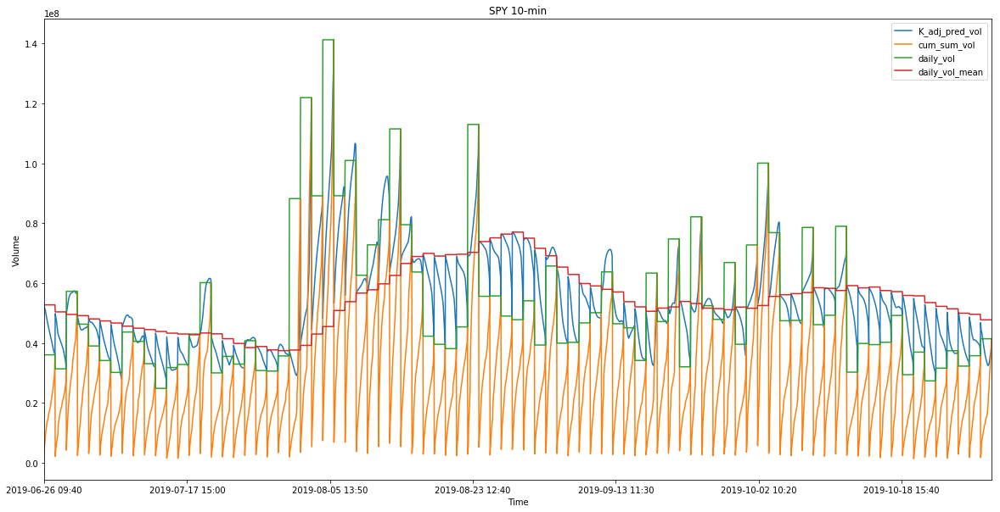

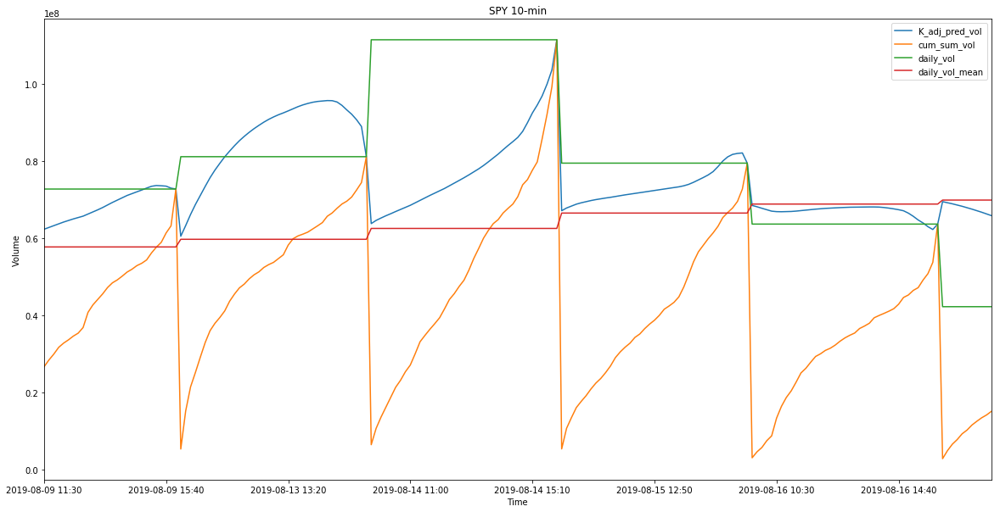

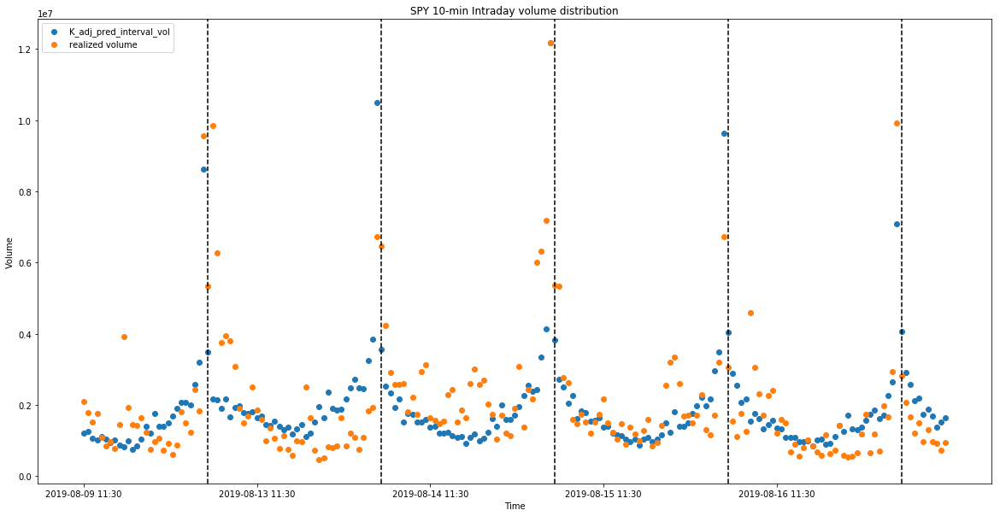

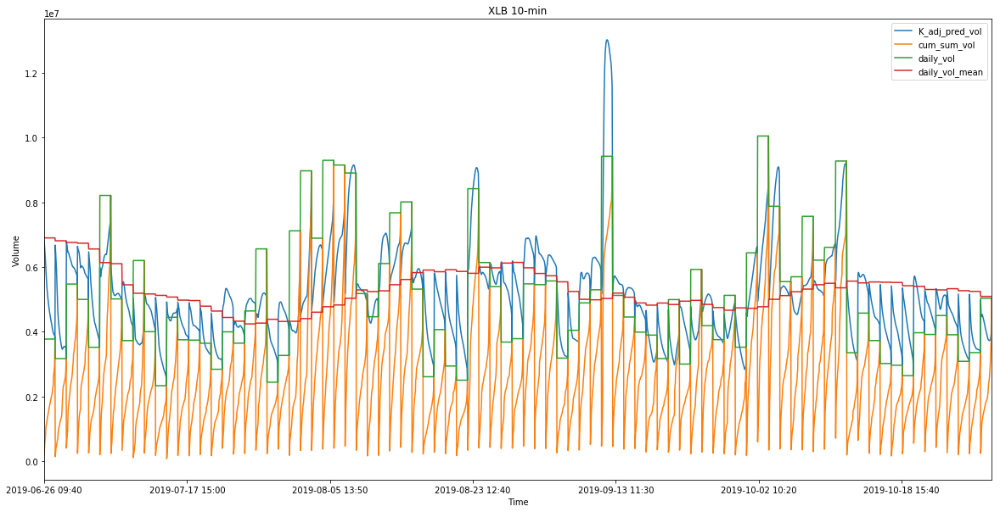

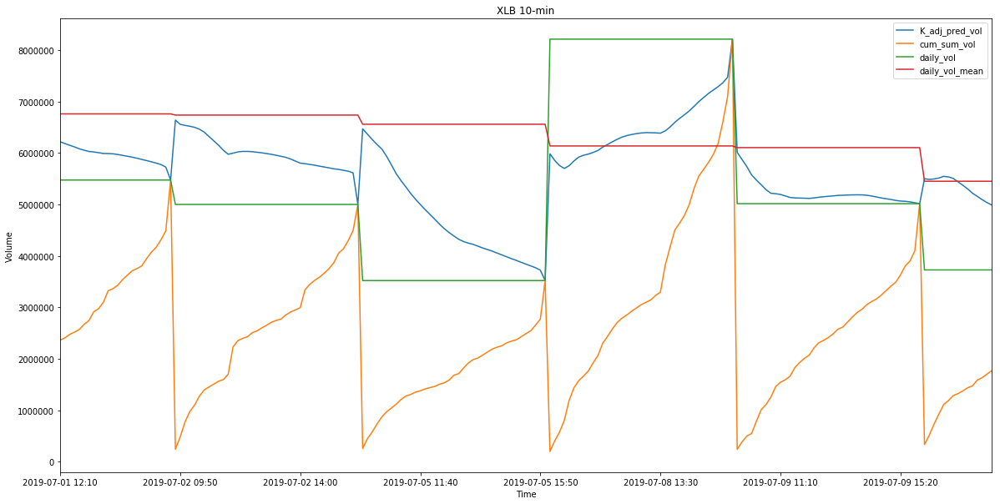

...

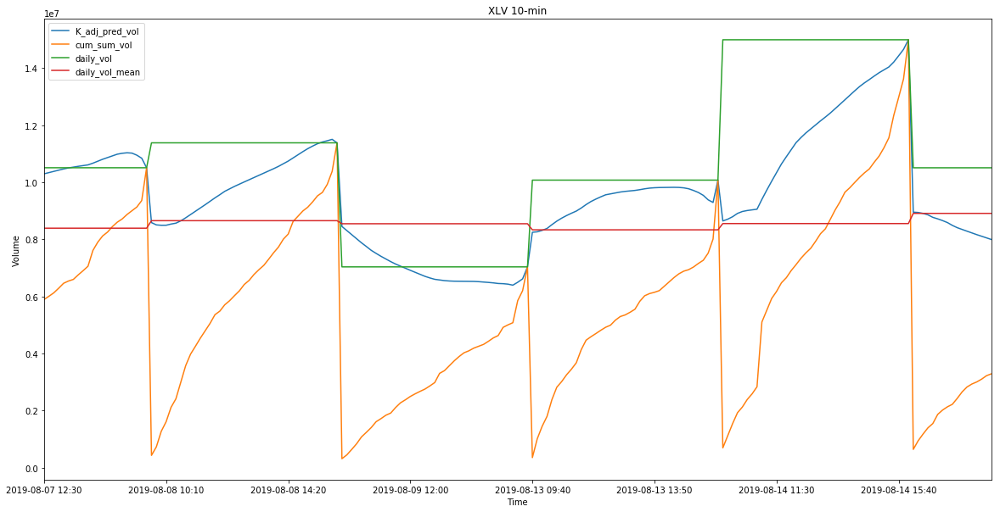

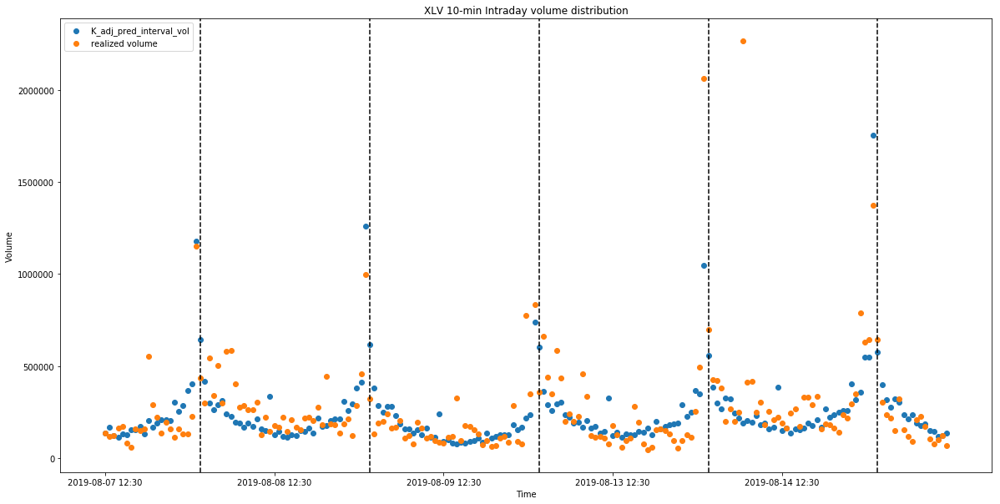

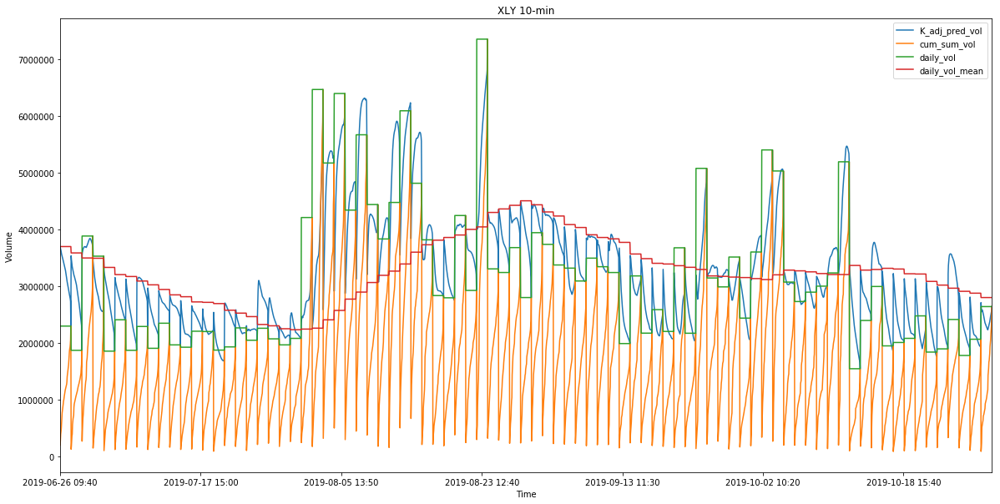

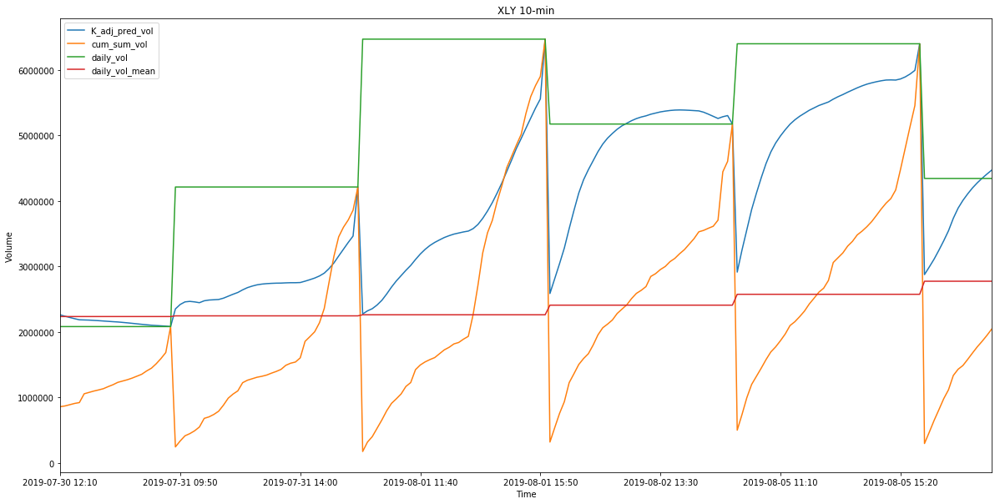

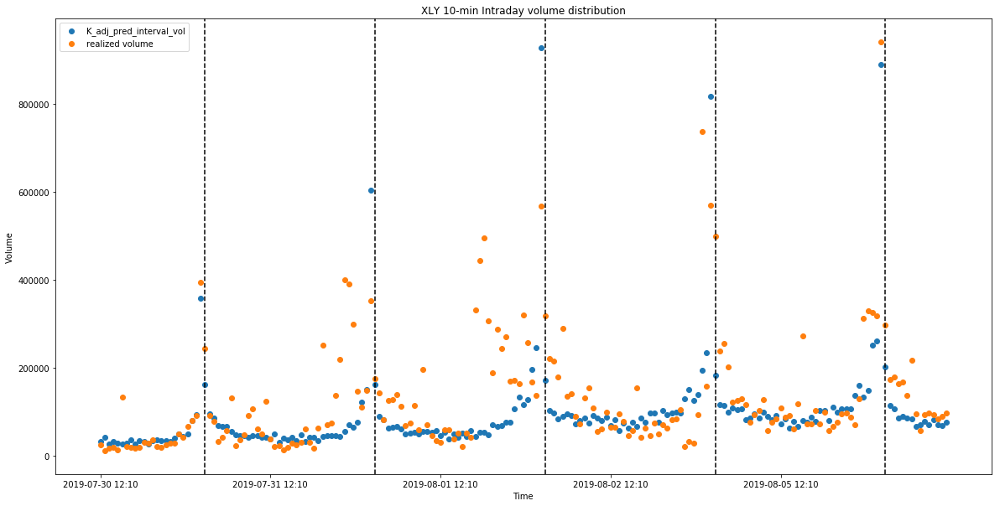

In [202]:

    
for sym_name in syms:
    temp = Kalman_dict_10_adj[sym_name].iloc[60*39:].set_index("date_time")
    temp.index = temp.index.to_series().apply(lambda x: x.strftime('%Y-%m-%d %H:%M'))
    index = random.randrange(0, len(temp)-5*39)
    ax = temp[["K_adj_pred_vol","cum_sum_vol","daily_vol","daily_vol_mean"]].plot(figsize = (20, 10),title = sym_name+ " 10-min")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    
    rand_temp = temp.iloc[index:index+5*39]
    ax = rand_temp[["K_adj_pred_vol","cum_sum_vol","daily_vol","daily_vol_mean"]].plot(figsize = (20, 10),title = sym_name+ " 10-min")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    
    fig, ax = plt.subplots(figsize=(20,10))
    ax.scatter(rand_temp.index, rand_temp["K_adj_pred_interval_vol"],label= "K_adj_pred_interval_vol")
    ax.scatter(rand_temp.index, rand_temp["volume"],label= "realized volume")
    xpositions = rand_temp[rand_temp.time==datetime.strptime('09:40', '%H:%M').time()].index.values
    for xc in xpositions:
        plt.axvline(x=xc, color='k', linestyle='--')
    ax.set_xticks(rand_temp.index[::39])
    ax.set_title(sym_name+ " 10-min" + " Intraday volume distribution")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    ax.legend()
    plt.show()

## ALL Model performance with ADV initial guess

In [165]:
models = ["Deterministic_Blend", "Log_Bayesian", "Kalman_Filter", "Kalman_Filter_adj"]
results = ["Deter_Blend","B_pred_vol","K_pred_vol", "K_adj_pred_vol"]

All_performace_Result_10_adj = Errors(Kalman_dict_10_adj)
All_performace_Result_10_adj
All_performace_Result_10_adj.to_csv("All_performace_Result_10_adj.csv")

In [166]:
All_performace_Result_10_adj

,sym,model,MAE,MAPE,MASE
0,SPY,Deterministic_Blend,8.409372e+06,0.151821,0.898132
1,SPY,Log_Bayesian,6.161251e+06,0.108274,0.709928
2,SPY,Kalman_Filter,8.198853e+06,0.137425,1.446989
3,SPY,Kalman_Filter_adj,1.176673e+07,0.210591,1.000783
4,XLB,Deterministic_Blend,9.621374e+05,0.183002,1.079744
5,XLB,Log_Bayesian,6.977676e+05,0.125345,0.878681
6,XLB,Kalman_Filter,9.637978e+05,0.171600,1.773197
7,XLB,Kalman_Filter_adj,1.119830e+06,0.208452,1.317009
8,XLC,Deterministic_Blend,5.703445e+05,0.218312,0.846481
9,XLC,Log_Bayesian,5.014621e+05,0.175898,0.668618


## Adjusted Kalman filter with ARIMA

std =  8.50


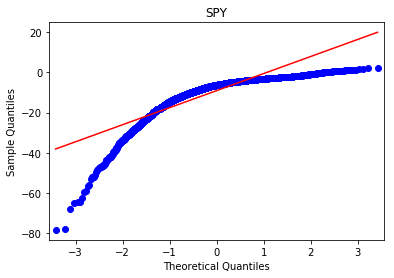

std =  4.46


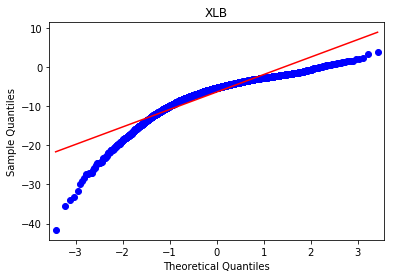

std =  2.89


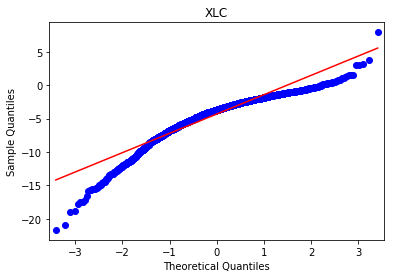

std =  6.85


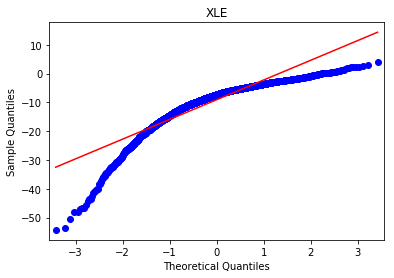

std =  5.28


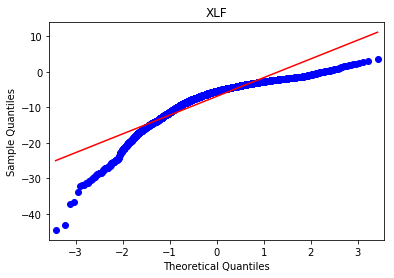

std =  6.12


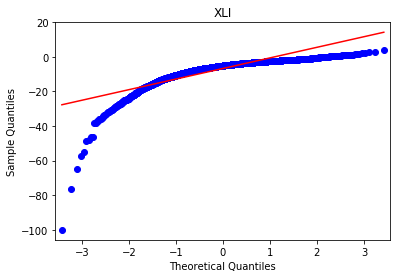

std =  5.19


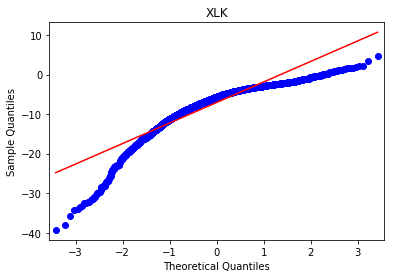

std =  4.86


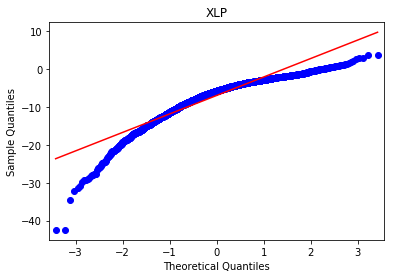

std =  7.61


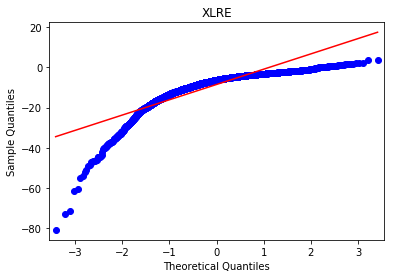

std =  4.76


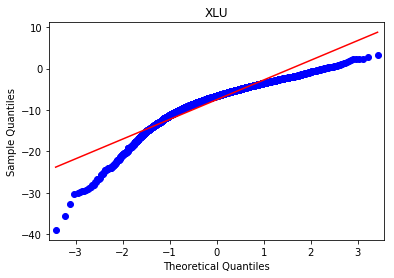

std =  4.73


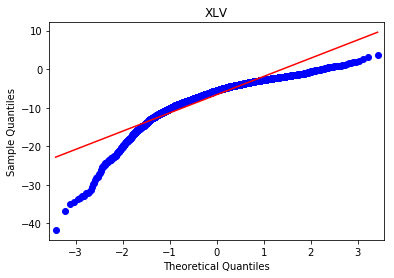

std =  5.09


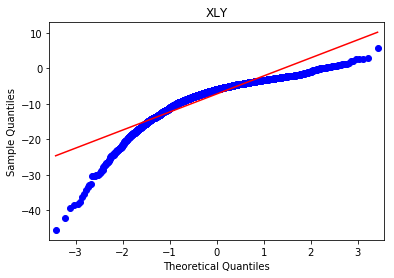

In [203]:

df_clean_10["residual_ARIMA"] = (df_clean_10["volume"] - df_clean_10["daily_vol"]*df_clean_10["cum_vol_prof_mean"])/(df_clean_10["ARIMA_day_vol"]*np.sqrt(df_clean_10["cum_vol_prof_var"]))
df_clean_10["residual_ARIMA"] = df_clean_10["residual_ARIMA"].replace([np.inf, -np.inf], np.nan)

for sym_name in syms:
    temp = df_clean_10[(df_clean_10.sym == sym_name)].residual_ARIMA.dropna()
    sm.qqplot(temp, line ='s')
    print("std = ",  ("%.2f" % np.std(temp)))
    plt.title(sym_name)
    pylab.show()

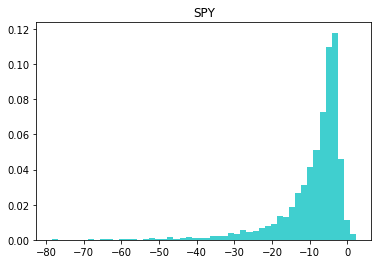

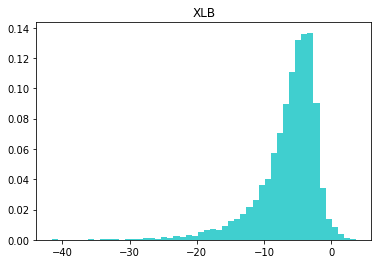

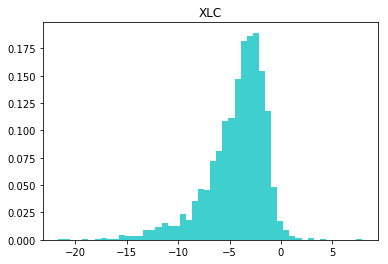

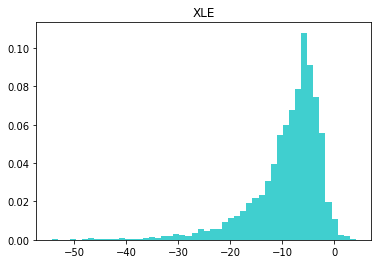

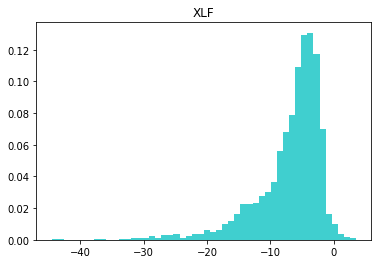

...

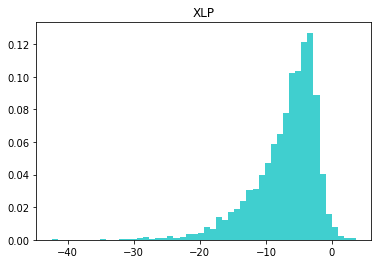

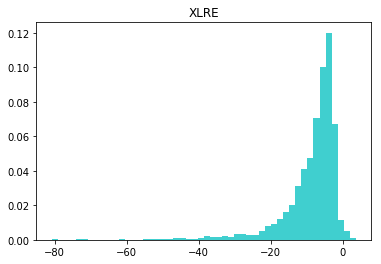

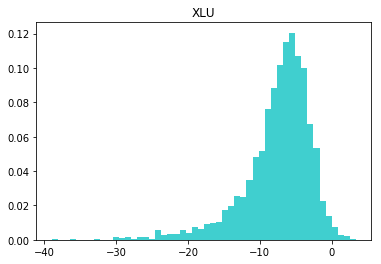

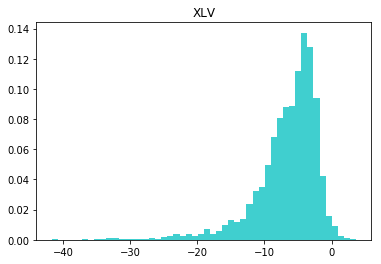

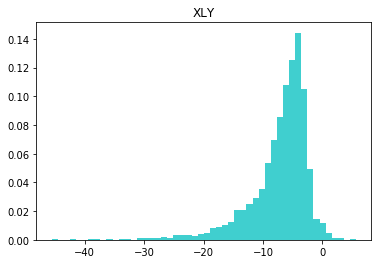

In [168]:

for sym_name in syms:
    temp = df_clean_10[(df_clean_10.sym == sym_name)].residual_ARIMA.dropna()
    plt.hist(temp, bins=50, normed=True, color='c', alpha=0.75)
    plt.title(sym_name)
    plt.show()

In [169]:
Kalman_dict_10_ARIMA_std_adjust = dict()

for sym_name in syms:
    temp = Kalman_dict_ARIMA_10[sym_name]
    temp["residual_ARIMA_adj"] = (temp["volume"] - temp["daily_vol"]*temp["cum_vol_prof_mean"])/(temp["ARIMA_day_vol"]*np.sqrt(temp["cum_vol_prof_var"]))
    temp["residual_ARIMA_adj"] = temp["residual_ARIMA_adj"].replace([np.inf, -np.inf], np.nan)
    dates = list(set(temp.date))
    dates.sort()
    for i in range(20,len(dates)):
        mask1 = (temp.date >= dates[i-20])&(temp.date <= dates[i-1])
        mask2 = (temp.date == dates[i])
        residual_series = temp[mask1].residual_ARIMA_adj.dropna()
        temp.loc[mask2,"std_ARIMA_multiplier"] = np.std(residual_series)
    Kalman_dict_10_ARIMA_std_adjust[sym_name] = temp

In [170]:


def Kalman_ARIMA_adj(df, sym):
    all_time = list(set(df.time))
    all_time.sort()
    
    for date in all_date[20:]:
        
        mask0 = (df["date"] == date) & (df["time"] == datetime.strptime('09:40', '%H:%M').time())
        temp = df.loc[mask0,:]
        ADV = temp.ARIMA_day_vol.values
        P0 = temp.daily_vol_std.values ** 2
        x0 = ADV
        
        for t in all_time:
   
            mask1 = ((df["date"] == date) & (df["time"] == t))
            temp2 = df[mask1]
            y = temp2.cum_sum_vol.values
            
            if t == datetime.strptime('09:40', '%H:%M').time():
                P = P0
                x = x0
                last_pred = ADV

            u = temp2.vol_prof_mean.values
            miu = temp2.cum_vol_prof_mean.values
            R = ADV**2 * temp2.cum_vol_prof_var.values*(temp2.std_ARIMA_multiplier.values**2)
            K = (miu * P) / (miu ** 2 * P + R)
            P = (1 - K*miu) * P
            x = x + K * (y - miu*x)
            
            df.loc[mask1, "K_adj_pred_vol_ARIMA"] = x
            df.loc[mask1, "K_adj_pred_interval_vol_ARIMA"] = last_pred * u
            last_pred = x
    
    return df

In [171]:
Kalman_dict_ARIMA_10_adj = dict()

for sym_name in syms:
    
    temp = Kalman_dict_10_ARIMA_std_adjust[sym_name]
    Kalman_dict_ARIMA_10_adj[sym_name] =  Kalman_ARIMA_adj(temp,sym_name)

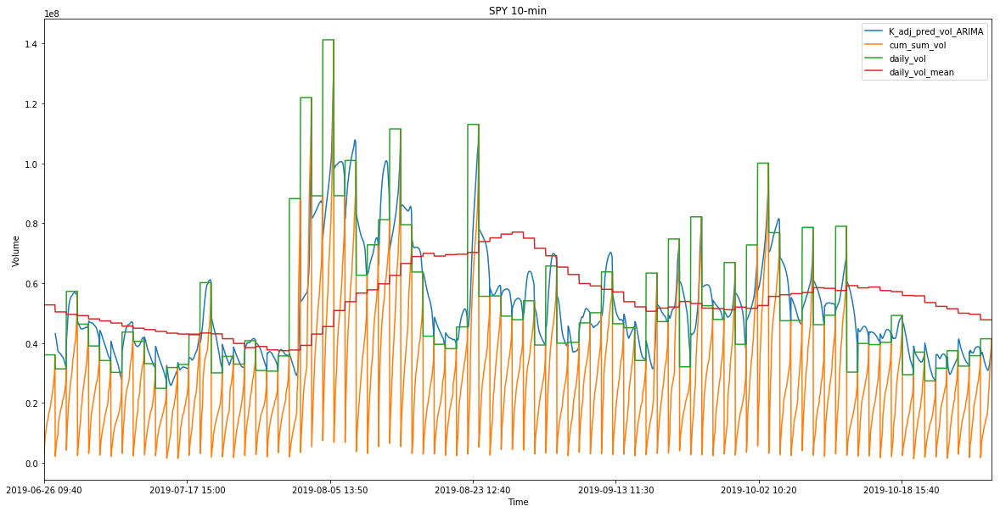

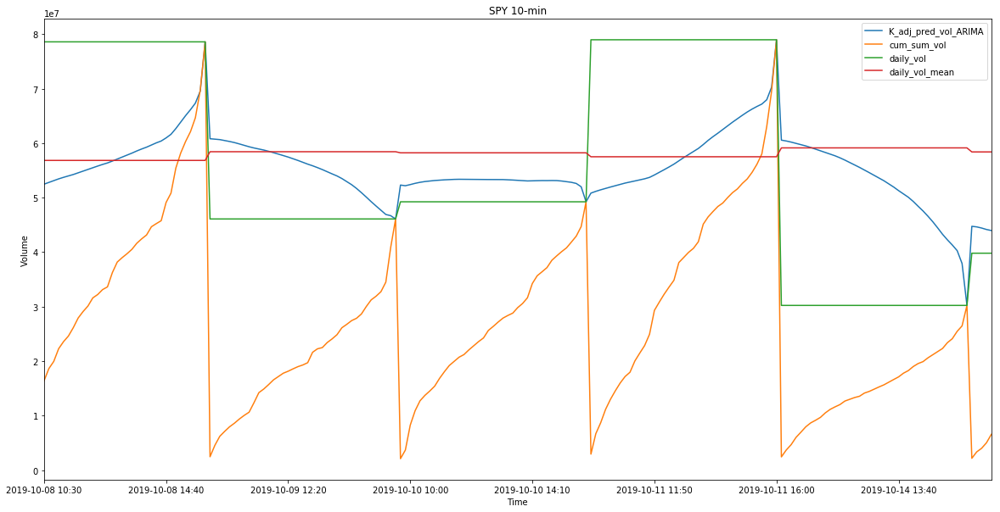

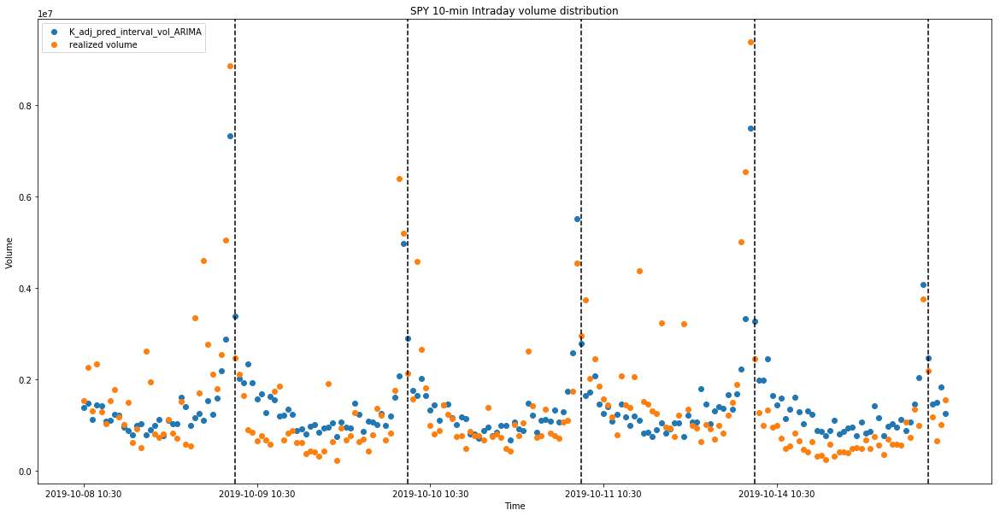

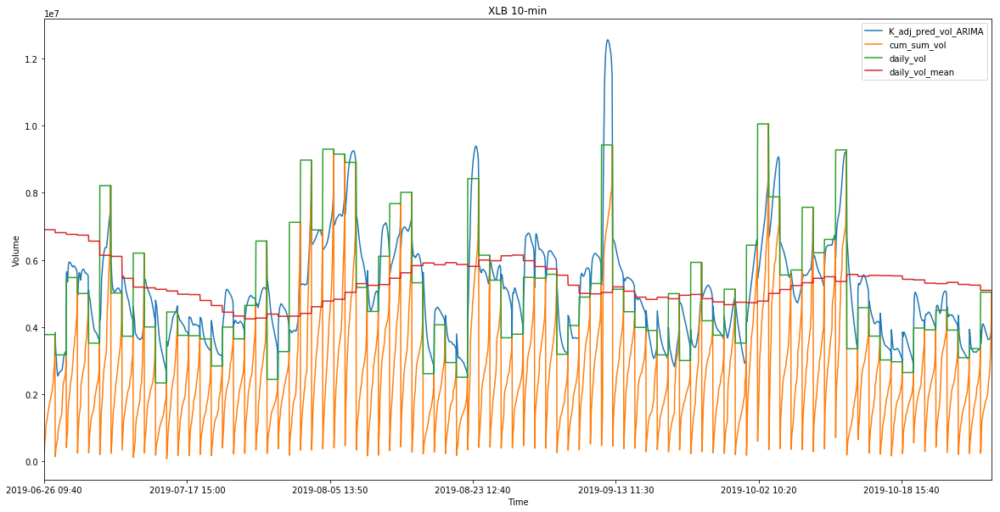

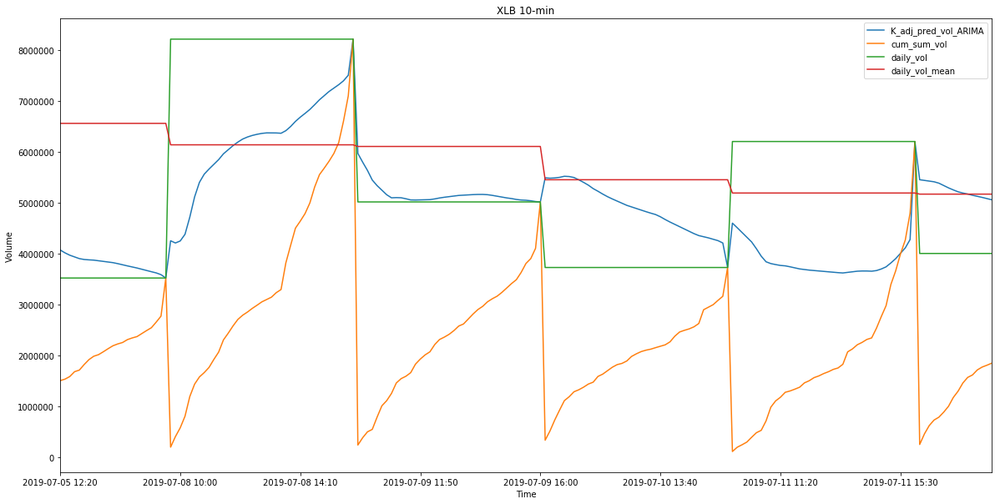

...

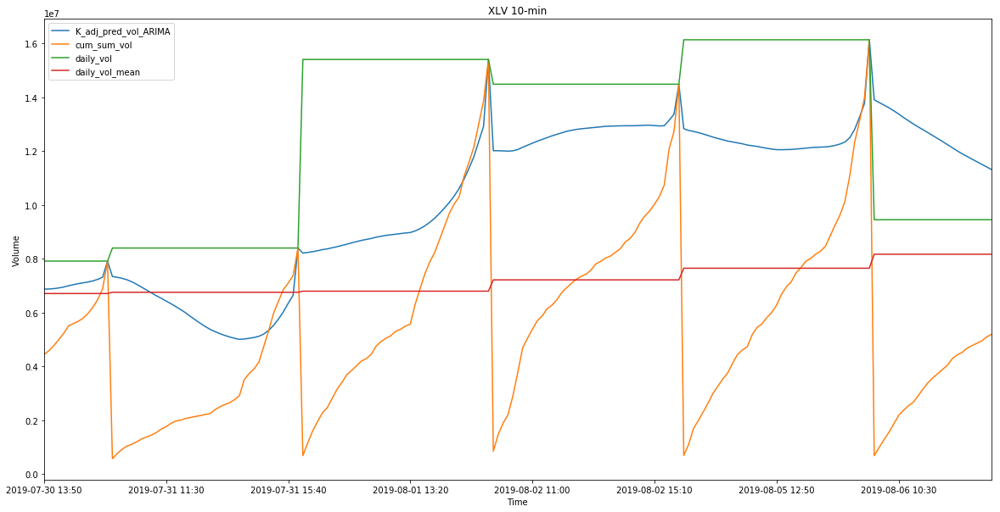

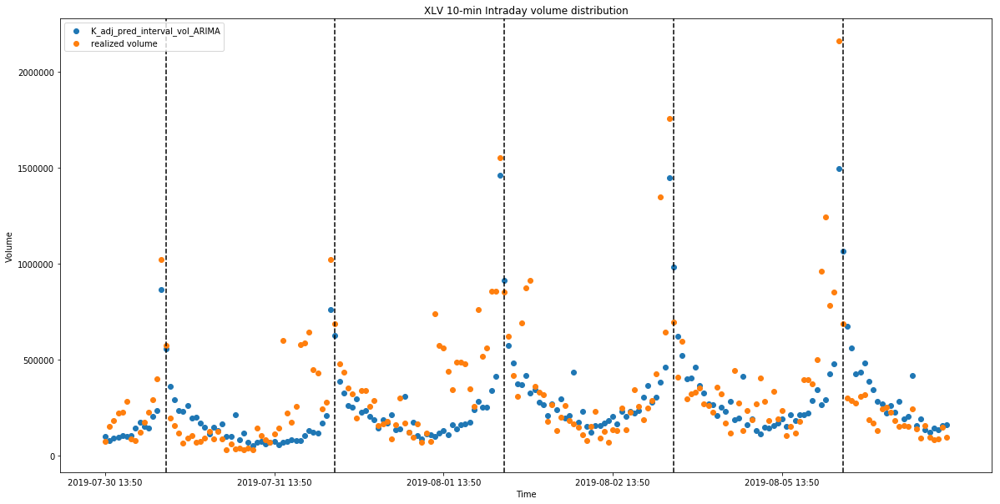

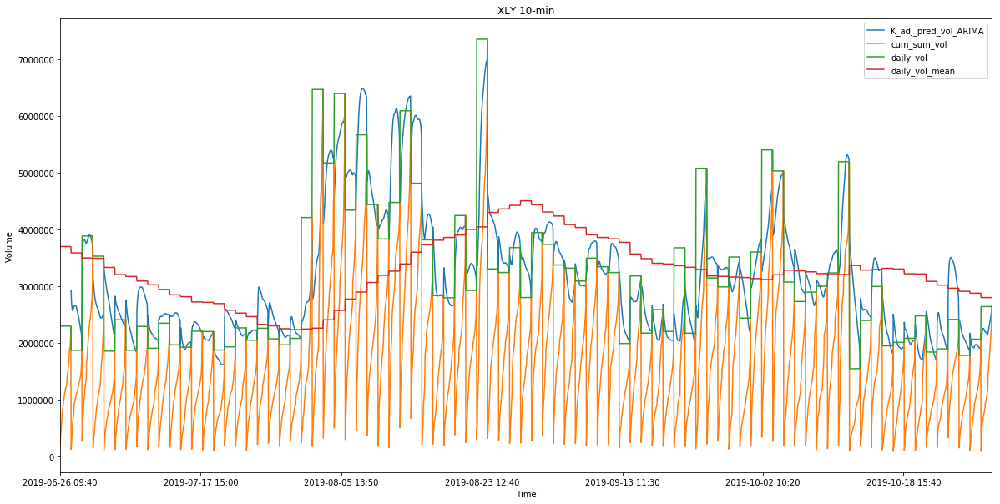

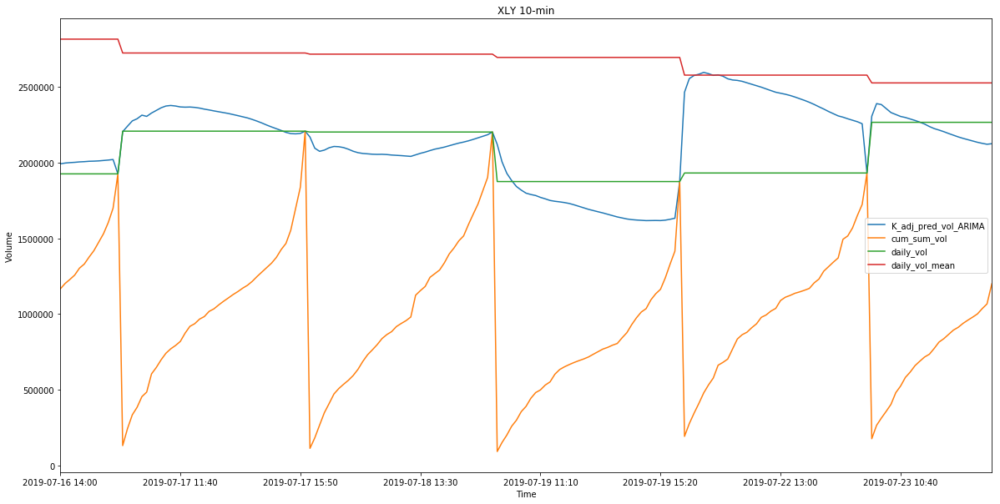

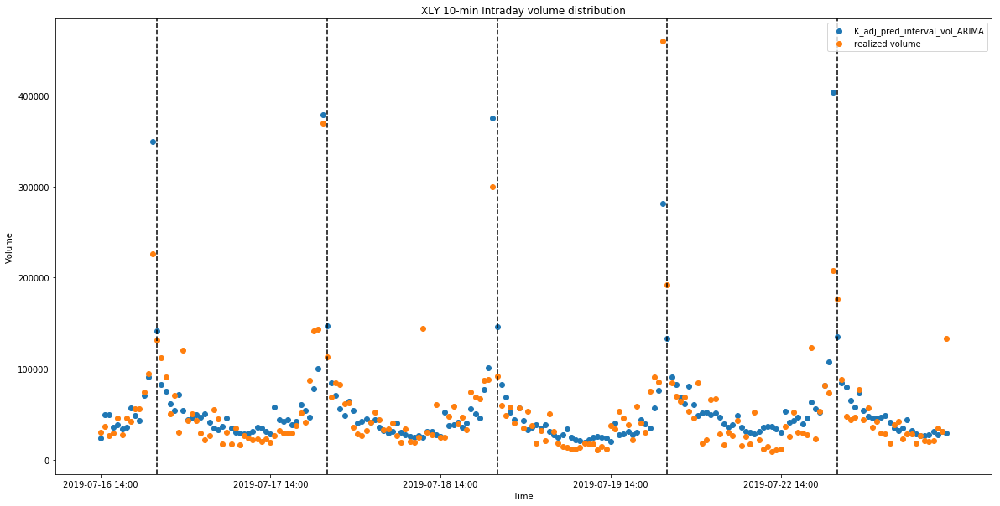

In [204]:

for sym_name in syms:
    temp = Kalman_dict_ARIMA_10_adj[sym_name].iloc[60*39:].set_index("date_time")
    temp.index = temp.index.to_series().apply(lambda x: x.strftime('%Y-%m-%d %H:%M'))
    index = random.randrange(0,len(temp)-5*39)
    ax = temp[["K_adj_pred_vol_ARIMA","cum_sum_vol","daily_vol","daily_vol_mean"]].plot(figsize = (20, 10),title = sym_name+ " 10-min")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    
    rand_temp = temp.iloc[index:index+5*39]
    ax = rand_temp[["K_adj_pred_vol_ARIMA","cum_sum_vol","daily_vol","daily_vol_mean"]].plot(figsize = (20, 10),title = sym_name+ " 10-min")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    
    fig, ax = plt.subplots(figsize=(20,10))
    ax.scatter(rand_temp.index, rand_temp["K_adj_pred_interval_vol_ARIMA"],label= "K_adj_pred_interval_vol_ARIMA")
    ax.scatter(rand_temp.index, rand_temp["volume"],label= "realized volume")
    xpositions = rand_temp[rand_temp.time==datetime.strptime('09:40', '%H:%M').time()].index.values
    for xc in xpositions:
        plt.axvline(x=xc, color='k', linestyle='--')
    ax.set_xticks(rand_temp.index[::39])
    ax.set_title(sym_name+ " 10-min" + " Intraday volume distribution")
    ax.set_xlabel("Time")
    ax.set_ylabel("Volume")
    ax.legend()
    plt.show()   


## ALL Model performance with ARIMA initial guess

In [173]:
models = ["Deterministic_Blend_ARIMA", "Log_Bayesian_ARIMA", "Kalman_Filter_ARIMA", "Kalman_Filter__ARIMA_adj"]
results = ["Deter_Blend_ARIMA","B_pred_vol_ARIMA","K_pred_vol_ARIMA", "K_adj_pred_vol_ARIMA"]

All_performace_Result_ARIMA_10_adj= Errors(Kalman_dict_ARIMA_10_adj)
All_performace_Result_ARIMA_10_adj

,sym,model,MAE,MAPE,MASE
0,SPY,Deterministic_Blend_ARIMA,7.342235e+06,0.126064,0.770532
1,SPY,Log_Bayesian_ARIMA,5.550341e+06,0.094253,0.578275
2,SPY,Kalman_Filter_ARIMA,8.574544e+06,0.144755,0.985877
3,SPY,Kalman_Filter__ARIMA_adj,9.864262e+06,0.170459,0.977018
4,XLB,Deterministic_Blend_ARIMA,7.885334e+05,0.162372,1.180015
5,XLB,Log_Bayesian_ARIMA,5.878491e+05,0.113644,0.926718
6,XLB,Kalman_Filter_ARIMA,9.257087e+05,0.178196,1.503897
7,XLB,Kalman_Filter__ARIMA_adj,9.292466e+05,0.188066,1.437246
8,XLC,Deterministic_Blend_ARIMA,4.908434e+05,0.210618,0.856041
9,XLC,Log_Bayesian_ARIMA,4.154539e+05,0.163934,0.715504


In [174]:
All_performace_Result_ARIMA_10_adj.to_csv("All_performace_Result_ARIMA_10_adj.csv")